# Compare Hmov vs spnoise models

In [4]:
run -im djd.main -- --dbname=dj_hmov_test --user=write

Connecting write@huxley.neuro.bzm:3306
Connected to database 'dj_hmov_test' as 'write@10.153.173.165'


In [5]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.gridspec as gridspec
import seaborn as sns
from scipy import stats

from djd.plot import cm2inch
from djd.glms import (plot_model, plot_rf_filters, plot_train_test_psth, get_best_model, get_rf_area, get_rf_qi, get_strf_comps, get_srf_contour)

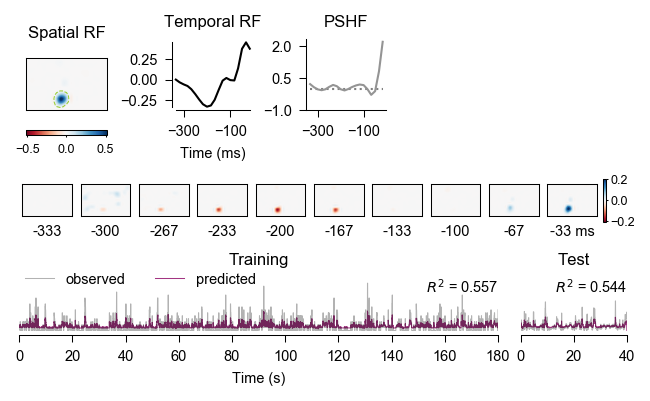

In [7]:
key1 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 10, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key1)

## Check Stimulus tables

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
Stimulus() & key

m strain acronym + counter,s Series number,e Experiment number,stim_file_name file name that ran the stimulus,stim_type stimulus type,"stim_ts automatic timestamp, do not edit"
Ntsr1Cre_2019_0008,5,8,hollymov_opto_03,movie,2021-06-22 18:53:02


In [8]:
Stimulus.MovieCond()

[autoreload of djd.stimulus failed: Traceback (most recent call last):
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj): continue
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_

m strain acronym + counter,s Series number,e Experiment number,stim_id stimulus ID,movie_name movie file name,movie_form geometrical form (e.g. 'Rectangle'),movie_orientation orientation (0 = horizontal) (deg),movie_contrast contrast [0-1],movie_width width (deg),movie_height height (deg),movie_x_position x position from center of screen (deg),movie_y_position y position from center of screen (deg)
Ntsr1Cre_2019_0002,1,10,0,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,45.0,0.0
Ntsr1Cre_2019_0002,1,10,1,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,45.0,0.0
Ntsr1Cre_2019_0002,2,8,0,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,45.0,0.0
Ntsr1Cre_2019_0002,2,8,1,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,45.0,0.0
Ntsr1Cre_2019_0002,3,8,0,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,30.0,6.84277
Ntsr1Cre_2019_0002,3,8,1,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,30.0,6.84277
Ntsr1Cre_2019_0002,5,8,0,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,15.0,6.84277
Ntsr1Cre_2019_0002,5,8,1,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,15.0,6.84277
Ntsr1Cre_2019_0007,1,5,0,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,45.0,0.0
Ntsr1Cre_2019_0007,1,5,1,MAS_1400_2-500,Rectangle,90.0,1.0,56.0437,56.0437,45.0,0.0


In [6]:
Stimulus.MovieCond() & key

m strain acronym + counter,s Series number,e Experiment number,stim_id stimulus ID,movie_name movie file name,movie_form geometrical form (e.g. 'Rectangle'),movie_orientation orientation (0 = horizontal) (deg),movie_contrast contrast [0-1],movie_width width (deg),movie_height height (deg),movie_x_position x position from center of screen (deg),movie_y_position y position from center of screen (deg)
Ntsr1Cre_2019_0008,5,8,0,hmovTest,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,1,hmovTrain_01-1,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,2,hmovTrain_01-2,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,3,hmovTrain_01-3,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,4,hmovTrain_01-4,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,5,hmovTrain_01-5,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,6,hmovTrain_01-6,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,7,hmovTrain_01-7,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0
Ntsr1Cre_2019_0008,5,8,8,hmovTrain_01-8,Rectangle,90.0,1.0,108.0,67.2453,55.0,0.0


In [7]:
Stimulus.Hmov() & key

m strain acronym + counter,s Series number,e Experiment number,hm_version movie version number,hm_seq_num number of the random sequence,hm_width_pix frame width (pixels),hm_height_pix frame height (pixels),hm_width_deg frame width (deg),hm_height_deg frame height (deg)
Ntsr1Cre_2019_0008,5,8,3,1,424,264,108.0,67.2453


## Get RF area

[autoreload of djd.glms failed: Traceback (most recent call last):
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj): continue
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj)

> /Users/ybauer/code/djd/djd/glms.py(2377)plot_rf_filters()
   2375     import pdb
   2376     pdb.set_trace()
-> 2377     strf = model_out['w_opt']
   2378     sRF, tRF = get_strf_comps(strf)
   2379     # Get RF center coordinates and polarity



ipdb>  c


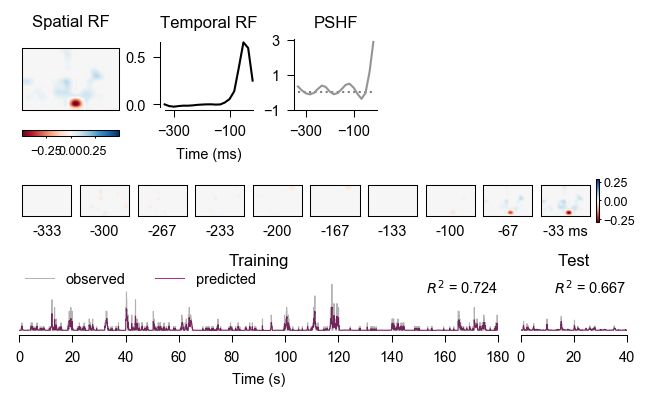

In [6]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key)

thresh -0.284
> /Users/ybauer/code/djd/djd/glms.py(1475)get_rf_qi()
   1473     import pdb
   1474     pdb.set_trace()
-> 1475     vmax = max(abs(sRF.min()), abs(sRF.max()))  # TODO: why not simply max(abs(sRF))?
   1476     ratio = thresh_abs / vmax
   1477     qi_rf = 1 - ratio



ipdb>  n


> /Users/ybauer/code/djd/djd/glms.py(1476)get_rf_qi()
   1474     pdb.set_trace()
   1475     vmax = max(abs(sRF.min()), abs(sRF.max()))  # TODO: why not simply max(abs(sRF))?
-> 1476     ratio = thresh_abs / vmax
   1477     qi_rf = 1 - ratio
   1478 



ipdb>  max(abs(sRF))


*** ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()


ipdb>  abs(sRF)


array([[1.08347228e-03, 8.11252728e-04, 5.53982982e-04, ...,
        9.51308048e-05, 1.25806381e-04, 1.57928673e-04],
       [8.98834533e-04, 6.75933953e-04, 4.65212381e-04, ...,
        8.82087541e-05, 1.18196680e-04, 1.49729026e-04],
       [7.14218428e-04, 5.40320412e-04, 3.75849529e-04, ...,
        8.14045208e-05, 1.10611593e-04, 1.41451075e-04],
       ...,
       [8.02183634e-05, 1.11831782e-04, 1.41274369e-04, ...,
        2.55315416e-04, 2.22454714e-04, 1.87361508e-04],
       [5.90591949e-05, 8.82420677e-05, 1.15433336e-04, ...,
        2.26695893e-04, 1.98427759e-04, 1.68227600e-04],
       [3.68568903e-05, 6.34375851e-05, 8.82182972e-05, ...,
        1.96337662e-04, 1.72935232e-04, 1.47919717e-04]])


ipdb>  abs(sRF).shape


(256, 400)


ipdb>  abs(sRF).max()


0.49442932018722696


ipdb>  vmax


0.49442932018722696


ipdb>  q


BdbQuit: 

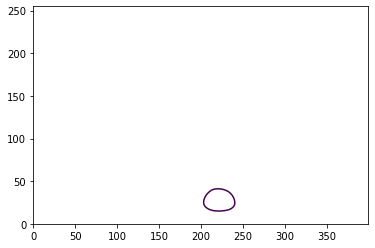

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
rf_qi = get_rf_qi(strf, scaling=16, scaling_order=3)
print('rf_qi', rf_qi)




# rf_contour_thresh = -0.295
# get_rf_area(strf, rf_contour_thresh, scaling=32, scaling_order=3)
# get_rf_area(key, scaling=16, scaling_order=3)

thresh -0.016
vmax 0.49442932018722696
rf_qi 0.9676394595815208


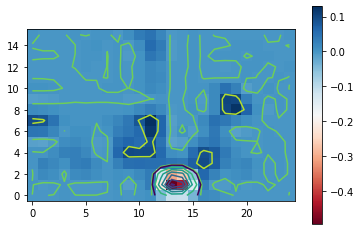

In [5]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
sRF, tRF = get_strf_comps(strf)
contour, thresh = get_srf_contour(sRF)
print('thresh', thresh)
plt.contour(sRF)
plt.contour(sRF, levels=[thresh])
plt.imshow(sRF, origin='lower', cmap='RdBu')
plt.colorbar()

thresh_abs = abs(thresh)
vmax = max(abs(sRF.min()), abs(sRF.max()))  # TODO: why not simply max(abs(sRF))?
print('vmax', vmax)
ratio = thresh_abs / vmax
qi_rf = 1 - ratio
print('rf_qi', qi_rf)

thresh -0.284
vmax 0.49442932018722696
rf_qi 0.4256004075719926


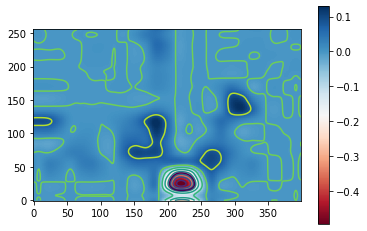

In [6]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
sRF, tRF = get_strf_comps(strf)
from skimage.transform import rescale
sRF = rescale(sRF, 16, order=3)

contour, thresh = get_srf_contour(sRF)
print('thresh', thresh)
plt.contour(sRF)
plt.contour(sRF, levels=[thresh])
plt.imshow(sRF, origin='lower', cmap='RdBu')
plt.colorbar()

thresh_abs = abs(thresh)
vmax = max(abs(sRF.min()), abs(sRF.max()))  # TODO: why not simply max(abs(sRF))?
print('vmax', vmax)
ratio = thresh_abs / vmax
qi_rf = 1 - ratio
print('rf_qi', qi_rf)

thresh -0.019
vmax 0.49442932018722696
rf_qi 0.9615718582530558


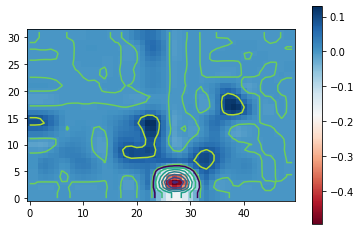

In [25]:
sRF, tRF = get_strf_comps(strf)
from skimage.transform import rescale
sRF = rescale(sRF, 2, order=3)

contour, thresh = get_srf_contour(sRF)
print('thresh', thresh)
plt.contour(sRF)
plt.contour(sRF, levels=[thresh])
plt.imshow(sRF, origin='lower', cmap='RdBu')
plt.colorbar()

thresh_abs = abs(thresh)
vmax = max(abs(sRF.min()), abs(sRF.max()))  # TODO: why not simply max(abs(sRF))?
print('vmax', vmax)
ratio = thresh_abs / vmax
qi_rf = 1 - ratio
print('rf_qi', qi_rf)

In [22]:
1 - 0.284/0.49

0.42040816326530617

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
# rf_qi, rf_contour_thresh = get_rf_qi(strf)
rf_contour_thresh = -0.295
# get_rf_area(strf, rf_contour_thresh, scaling=32, scaling_order=3)
get_rf_area(key, scaling=16, scaling_order=3)

53.83038800390626

> /Users/ybauer/code/djd/djd/glms.py(1552)get_rf_area()
   1550     pdb.set_trace()
   1551     # TODO: adapt to GLM() if using it at any point
-> 1552     stim_type, strf = (SplineLNP() & key).fetch1('spl_stim', 'spl_w_opt')
   1553 
   1554     # Extract spatial RF component from stRF model weight vector



ipdb>  c


> /Users/ybauer/code/djd/djd/glms.py(1585)get_rf_area()
   1583         pdb.set_trace()
   1584         # Get hmov or spnoise stimulus dimensions in deg
-> 1585         if stim_type == 'hmov':
   1586             # hmov: original input 106x66 deg changed by Expo to 108x67
   1587             width_deg, height_deg = (Stimulus.Hmov() & key).fetch1('hm_width_deg',



ipdb>  c


51.631781906250005

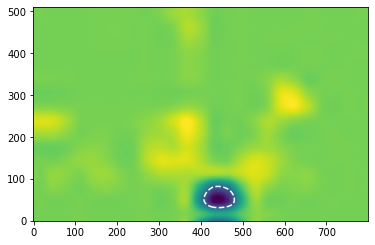

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
# rf_qi, rf_contour_thresh = get_rf_qi(strf)
rf_contour_thresh = -0.295
# get_rf_area(strf, rf_contour_thresh, scaling=32, scaling_order=3)
get_rf_area(key, scaling=32, scaling_order=3)

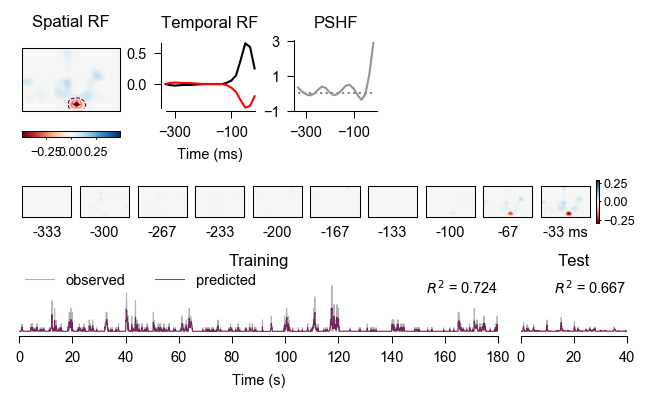

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig,ax = plot_model(key)

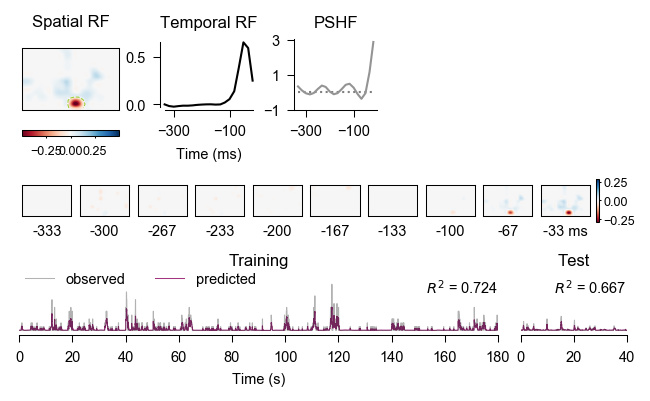

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig,ax = plot_model(key)

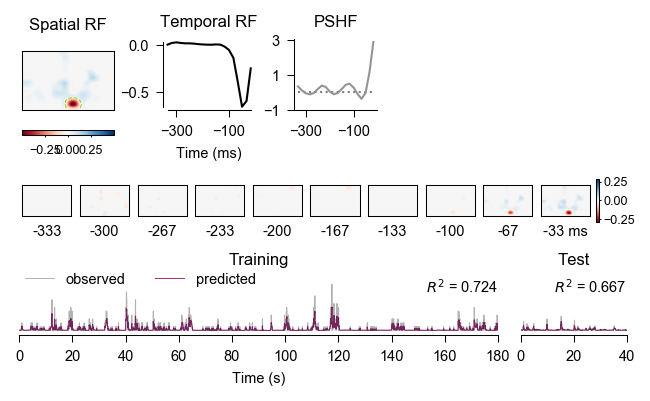

In [5]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig,ax = plot_model(key, flip_off_rf_sign=True, plot_contour=True)

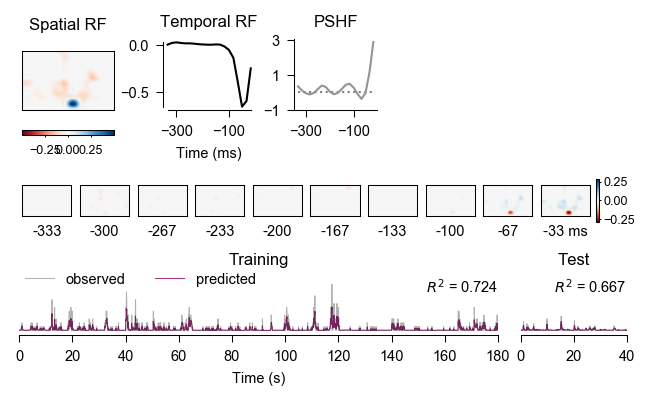

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig,ax = plot_model(key, flip_off_rf_sign=True, plot_contour=False)

In [4]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
rf_qi, rf_contour_thresh = get_rf_qi(strf)
get_rf_area(strf, rf_contour_thresh, scaling=32, scaling_order=1)

TypeError: get_rf_area() got an unexpected keyword argument 'order'

/Users/ybauer/miniconda3/lib/python3.7/site-packages/skimage/transform/_warps.py:166: UserWarning: Bi-quadratic interpolation behavior has changed due to a bug in the implementation of scikit-image. The new version now serves as a wrapper around SciPy's interpolation functions, which itself is not verified to be a correct implementation. Until skimage's implementation is fixed, we recommend to use bi-linear or bi-cubic interpolation instead.
  preserve_range=preserve_range)


AssertionError: The specified level for the contour line does not result in a single RF. Please increase the level (for ON cell) or decrease the level (for OFF cell).

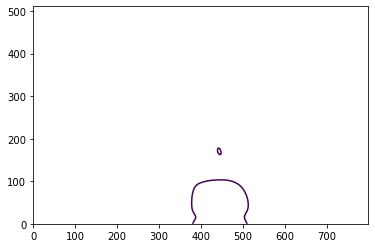

In [24]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
rf_qi, rf_contour_thresh = get_rf_qi(strf)
get_rf_area(strf, rf_contour_thresh, scaling=32, scaling_order=2)

In [ ]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
rf_qi, rf_contour_thresh = get_rf_qi(strf)
get_rf_area(strf, rf_contour_thresh, scaling=16, scaling_order=3)

> /Users/ybauer/code/djd/djd/glms.py(1443)get_rf_area()
   1441     # Get area in pixels
   1442     pdb.set_trace()
-> 1443     area_in_pix = mask.sum() # sum(sum(mask))
   1444     num_px_frame = np.prod(dims_sRF)#*scaling
   1445     area_perc = np.round(area_in_pix / num_px_frame * 100, 2)



ipdb>  n


> /Users/ybauer/code/djd/djd/glms.py(1444)get_rf_area()
   1442     pdb.set_trace()
   1443     area_in_pix = mask.sum() # sum(sum(mask))
-> 1444     num_px_frame = np.prod(dims_sRF)#*scaling
   1445     area_perc = np.round(area_in_pix / num_px_frame * 100, 2)
   1446 



ipdb>  area_in_pix


3099


ipdb>  n


> /Users/ybauer/code/djd/djd/glms.py(1445)get_rf_area()
   1443     area_in_pix = mask.sum() # sum(sum(mask))
   1444     num_px_frame = np.prod(dims_sRF)#*scaling
-> 1445     area_perc = np.round(area_in_pix / num_px_frame * 100, 2)
   1446 
   1447     # TODO: get area in deg vis angles



ipdb>  num_pix_frame


*** NameError: name 'num_pix_frame' is not defined


ipdb>  num_px_frame


102400


ipdb>  1e-10


1e-10


ipdb>  1e-10=0.1


*** SyntaxError: can't assign to literal


ipdb>  1e-10==0.1


False


ipdb>  1e-10==0.01


False


ipdb>  1e-1==0.1


True


ipdb>  1e-10==0.000000001


False


ipdb>  1e-10==0.0000000001


True


In [9]:
rf_contour_thresh

-0.02

0.7

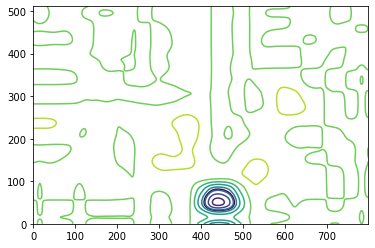

In [31]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
strf = (SplineLNP() & key).fetch1('spl_w_opt')
rf_qi, rf_contour_thresh = get_rf_qi(strf)
rf_contour_thresh = -0.295
get_rf_area(strf, rf_contour_thresh, scaling=32, scaling_order=3)

scaling=1, order=0: 2.0

scaling=2, order=0: 2.5  # order=0 weird
scaling=2, order=1: 2.75  # order=1 better but not quite ok
scaling=2, order=2: 2.44  # order=2 worse
scaling=2, order=3: 2.56  # order=3 ok

scaling=4, order=1: 3  # order=1 better but not quite ok
scaling=4, order=2: error
scaling=4, order=3: 2.86  # order=3 ok

scaling=8, order=1: 3.11  # order=1 better but not quite ok
scaling=8, order=2: error
scaling=8, order=3: 2.97  # order=3 ok

scaling=16, order=1: 3.2  # order=1 better but not quite ok
scaling=16, order=2: error
scaling=16, order=3: 3.03  # order=3 ok

## Check stim dimensions and x/y-coordinates

[autoreload of djd.tuning failed: Traceback (most recent call last):
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj): continue
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_ob

> /Users/ybauer/code/djd/djd/tuning.py(514)plot_rf()
    512         import pdb
    513         pdb.set_trace()
--> 514         means, params, rsqs = self.fetch1('tun_mean', 'tun_pars', 'tun_rsq')
    515         stim_param_values = (TuningInfo() & self).fetch1('ti_axes')
    516 



ipdb>  n


> /Users/ybauer/code/djd/djd/tuning.py(515)plot_rf()
    513         pdb.set_trace()
    514         means, params, rsqs = self.fetch1('tun_mean', 'tun_pars', 'tun_rsq')
--> 515         stim_param_values = (TuningInfo() & self).fetch1('ti_axes')
    516 
    517         # create and normalize mixrf



ipdb>  means


array([[[17.7225 ,  7.48702],
        [12.7309 , 10.4824 ],
        [11.4827 , 15.2265 ],
        [15.226  , 11.4807 ],
        [19.2208 , 11.9803 ],
        [13.9777 , 25.4608 ],
        [16.224  , 15.2248 ],
        [17.9719 , 13.7285 ],
        [14.4767 , 18.471  ],
        [12.48   , 14.7268 ],
        [ 8.9864 , 12.231  ],
        [ 7.98764, 11.9795 ]],

       [[13.977  , 11.4823 ],
        [17.222  , 14.2265 ],
        [18.9712 , 15.2255 ],
        [17.7234 , 12.2314 ],
        [11.4805 , 12.7297 ],
        [17.7204 , 11.7305 ],
        [17.4728 , 16.724  ],
        [11.7312 , 17.2217 ],
        [16.7234 , 14.9774 ],
        [13.9758 , 12.9784 ],
        [12.9788 , 15.2247 ],
        [11.982  , 16.9727 ]],

       [[21.2146 , 12.7303 ],
        [17.7217 ,  9.98415],
        [17.4712 , 11.9815 ],
        [25.2116 ,  7.23852],
        [15.9744 , 14.4765 ],
        [13.4785 ,  4.99151],
        [15.7224 ,  8.4864 ],
        [18.222  , 13.229  ],
        [14.4785 , 12.7303 ],
      

ipdb>  means.shape


(12, 12, 2)


ipdb>  params


array([[ 4.28213424e+01, -2.35112093e+01,  2.55928263e+00,
         7.27804383e-01,  1.13676573e+01,  3.90938545e+00,
         2.99415616e-01],
       [ 4.08935672e+01, -1.69622746e+01,  3.28463004e-02,
         9.46735510e-01,  3.35671634e+00,  2.63172514e+00,
         1.52432639e-01],
       [ 4.21387655e+01, -1.83147234e+01,  3.14159265e+00,
         7.21453475e-01,  5.10962202e+00,  3.77845734e+00,
         1.83232970e-01]])


ipdb>  rsqs


array([[0.47598052],
       [0.66424654],
       [0.62726327]])


ipdb>  self


*m               *s    *e    *ivs_order       *tun_model    *st8_type    *st8_crit    *u     tun_mean   tun_sem    tun_ntrial tun_spon_m tun_spon_s tun_pars   tun_rsq    tun_ts          
+--------------+ +---+ +---+ +--------------+ +-----------+ +----------+ +----------+ +----+ +--------+ +--------+ +--------+ +--------+ +--------+ +--------+ +--------+ +--------------+
Ntsr1Cre_2020_00 6     9     grat_x_position, ellipse       none         none         18     =BLOB=     =BLOB=     =BLOB=     =BLOB=     =BLOB=     =BLOB=     =BLOB=     2021-07-02 16:54
 (Total: 1)



ipdb>  (TuningInfo() & self)


*m               *s    *e    *ivs_order       ti_axes    ti_ax_dims ti_stim_ma ti_ts           
+--------------+ +---+ +---+ +--------------+ +--------+ +--------+ +--------+ +--------------+
Ntsr1Cre_2020_00 6     9     grat_x_position, =BLOB=     =BLOB=     =BLOB=     2021-06-22 20:34
 (Total: 1)



ipdb>  (TuningInfo() & self).df


                    m  s  e                                        ivs_order                                            ti_axes   ti_ax_dims                                        ti_stim_map  \
0  Ntsr1Cre_2020_0004  6  9  grat_x_position, grat_y_position, grat_contrast  [[17.4911, -27.5089, -1.0], [22.4928, -22.5072...  [12, 12, 2]  [[[1.0, 0.0], [3.0, 2.0], [5.0, 4.0], [7.0, 6....   

                ti_ts  
0 2021-06-22 20:34:29  


ipdb>  df= (TuningInfo() & self).df
ipdb>  df.ti_axes


0    [[17.4911, -27.5089, -1.0], [22.4928, -22.5072...
Name: ti_axes, dtype: object


ipdb>  len(df.ti_axes)


1


ipdb>  df.ti_axes.values


array([array([[ 17.4911 , -27.5089 ,  -1.     ],
       [ 22.4928 , -22.5072 ,   1.     ],
       [ 27.4944 , -17.5056 ,       nan],
       [ 32.496  , -12.504  ,       nan],
       [ 37.4976 ,  -7.50242,       nan],
       [ 42.4992 ,  -2.50081,       nan],
       [ 47.5008 ,   2.50081,       nan],
       [ 52.5024 ,   7.50242,       nan],
       [ 57.504  ,  12.504  ,       nan],
       [ 62.5056 ,  17.5056 ,       nan],
       [ 67.5072 ,  22.5072 ,       nan],
       [ 72.5089 ,  27.5089 ,       nan]])], dtype=object)


ipdb>  27.5-17.49


10.010000000000002


ipdb>  72.5-17.5


55.0


ipdb>  df.ti_ax_dims


0    [12, 12, 2]
Name: ti_ax_dims, dtype: object


ipdb>  c


> /Users/ybauer/code/djd/djd/tuning.py(555)plot_rf()
    553         # fetch size of sparse noise square and add half of it to the extent
    554         pdb.set_trace()
--> 555         grat_width, grat_height = (Stimulus.GratingCond() & self).fetch('grat_width',
    556                                                                         'grat_height')
    557         edge_length = np.unique(np.concatenate((grat_width, grat_height)))



ipdb>  stim_param_values


array([[ 17.4911 , -27.5089 ,  -1.     ],
       [ 22.4928 , -22.5072 ,   1.     ],
       [ 27.4944 , -17.5056 ,       nan],
       [ 32.496  , -12.504  ,       nan],
       [ 37.4976 ,  -7.50242,       nan],
       [ 42.4992 ,  -2.50081,       nan],
       [ 47.5008 ,   2.50081,       nan],
       [ 52.5024 ,   7.50242,       nan],
       [ 57.504  ,  12.504  ,       nan],
       [ 62.5056 ,  17.5056 ,       nan],
       [ 67.5072 ,  22.5072 ,       nan],
       [ 72.5089 ,  27.5089 ,       nan]])


ipdb>  c


> /Users/ybauer/code/djd/djd/tuning.py(564)plot_rf()
    562         # the RFs in the correct space.
    563         pdb.set_trace()
--> 564         extent = (nanmin(stim_param_values[:, 0]) - half_edge,
    565                   nanmax(stim_param_values[:, 0]) + half_edge,
    566                   nanmin(stim_param_values[:, 1]) - half_edge,



ipdb>  (Stimulus.GratingCond() & self)


*m               *s    *e    *stim_id    grat_type     grat_form     grat_orientation grat_contrast    grat_temp_freq   grat_spat_freq   grat_direction   grat_phase     grat_width     grat_height     grat_x_position  grat_y_position 
+--------------+ +---+ +---+ +---------+ +-----------+ +-----------+ +--------------+ +--------------+ +--------------+ +--------------+ +--------------+ +------------+ +------------+ +-------------+ +--------------+ +--------------+
Ntsr1Cre_2020_00 6     9     0           Uniform       Rectangle     90.0             1.0              0.0              2.0              0.0              0.0            5.00161        5.00161         17.4911          -27.5089        
Ntsr1Cre_2020_00 6     9     1           Uniform       Rectangle     90.0             -1.0             0.0              2.0              0.0              0.0            5.00161        5.00161         17.4911          -27.5089        
Ntsr1Cre_2020_00 6     9     2           Uniform       Rectangle

ipdb>  grat_width


array([5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00

ipdb>  grat_height


array([5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161, 5.00161,
       5.00161, 5.00

ipdb>  n


> /Users/ybauer/code/djd/djd/tuning.py(565)plot_rf()
    563         pdb.set_trace()
    564         extent = (nanmin(stim_param_values[:, 0]) - half_edge,
--> 565                   nanmax(stim_param_values[:, 0]) + half_edge,
    566                   nanmin(stim_param_values[:, 1]) - half_edge,
    567                   nanmax(stim_param_values[:, 1]) + half_edge)



ipdb>  half_edge


2.500805


ipdb>  edge


*** NameError: name 'edge' is not defined


ipdb>  edge_length


array([5.00161])


ipdb>  n


> /Users/ybauer/code/djd/djd/tuning.py(566)plot_rf()
    564         extent = (nanmin(stim_param_values[:, 0]) - half_edge,
    565                   nanmax(stim_param_values[:, 0]) + half_edge,
--> 566                   nanmin(stim_param_values[:, 1]) - half_edge,
    567                   nanmax(stim_param_values[:, 1]) + half_edge)
    568 



ipdb>  n


> /Users/ybauer/code/djd/djd/tuning.py(567)plot_rf()
    565                   nanmax(stim_param_values[:, 0]) + half_edge,
    566                   nanmin(stim_param_values[:, 1]) - half_edge,
--> 567                   nanmax(stim_param_values[:, 1]) + half_edge)
    568 
    569         for i, ax in enumerate(axs):



ipdb>  n


> /Users/ybauer/code/djd/djd/tuning.py(569)plot_rf()
    567                   nanmax(stim_param_values[:, 1]) + half_edge)
    568 
--> 569         for i, ax in enumerate(axs):
    570             if i in range(3): # plot OFF, ON subfields and mixrf:
    571                 # draw ellipse with fitted parameters:



ipdb>  extent


(14.990295, 75.009705, -30.009705, 30.009705)


ipdb>  stim_param_values


array([[ 17.4911 , -27.5089 ,  -1.     ],
       [ 22.4928 , -22.5072 ,   1.     ],
       [ 27.4944 , -17.5056 ,       nan],
       [ 32.496  , -12.504  ,       nan],
       [ 37.4976 ,  -7.50242,       nan],
       [ 42.4992 ,  -2.50081,       nan],
       [ 47.5008 ,   2.50081,       nan],
       [ 52.5024 ,   7.50242,       nan],
       [ 57.504  ,  12.504  ,       nan],
       [ 62.5056 ,  17.5056 ,       nan],
       [ 67.5072 ,  22.5072 ,       nan],
       [ 72.5089 ,  27.5089 ,       nan]])


ipdb>  17.49-2.5


14.989999999999998


ipdb>  424/4


106.0


ipdb>  264/4


66.0


ipdb>  60/12


5.0


ipdb>  66/16


4.125


ipdb>  106/25


4.24


ipdb>  66/5


13.2


ipdb>  106/5


21.2


ipdb>  424*0.06


25.439999999999998


ipdb>  21/424


0.049528301886792456


ipdb>  13/264


0.04924242424242424


ipdb>  424*0.049


20.776


ipdb>  424*0.0495


20.988


ipdb>  264*0.0495


13.068000000000001


ipdb>  106/21


5.0476190476190474


ipdb>  66/13


5.076923076923077


ipdb>  1/5


0.2


ipdb>  4/0.2


20.0


ipdb>  424/20


21.2


ipdb>  1/0.0495


20.2020202020202


ipdb>  12*25/16


18.75


ipdb>  106/16


6.625


ipdb>  106/25


4.24


ipdb>  66/16


4.125


ipdb>  66/12


5.5


ipdb>  66/5


13.2


ipdb>  60/12


5.0


ipdb>  66/13


5.076923076923077


ipdb>  q


BdbQuit: 

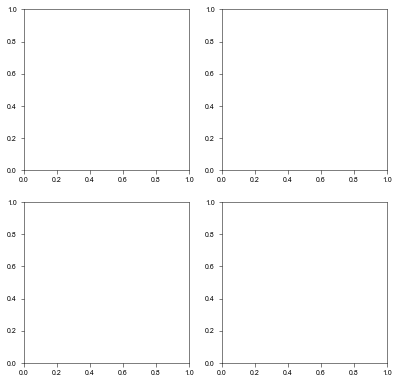

In [13]:
# fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
# gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

# key1 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 10, 'spl_paramset': 601}  # hmov
# fig, axs = plot_model(key1, gs=gs[0])

key2 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 9, 'spl_paramset': 1}  # spnoise
# fig, axs = plot_model(key2, gs=gs[2])

# fig, ax = (HmovUnit() & key1).plot_STA()

# Plot sparse noise StimTA
axs = (Tuning() & key2 & {'st8_type': 'none', 'tun_model': 'ellipse'}).plot_rf(ticks='edge', size_centers=False, rgb_overlay=True)
# axs = (Unit.Spikes() & key2).sta(tstart=-0.2, tstop=0.15, tres=0.02, precision=3,
#                           direction='stimta', ticklabelsize=8, titlesize=6, ylabelsize=8)

### Stimulus dimension equalisation of spnoise vs hmov
(TODO: put this into function form)
- spnoise: 
  - given 12 tiles * 5 degPerTile = 60 for whole stim <> 55 deg for centers, i.e. subtracting half tile (2.5) on each side (60-2*2.5=55)
    - see (TuningInfo() & self).fetch1('ti_axes')
      - gives coordinates in deg of each tile but GratingCond perhaps better access to vars
      - could extract those in same way as in Tuning().plot_rf to get coords of spnoise
        - ENSURE NO TRANSPOSE AND UD-FLIP ERRORS!
    - see (Stimulus.GratingCond() & self).fetch('grat_width', 'grat_height', 'grat_x_position', 'grat_y_position')
      - gives better access to dimensions and coords
      - check how coords are calculated for this table

- hmov
  - original: 424x264 pix on 47x29 cm LCD screen at 25 cm distance @ 4 pix/deg = 106x66º (full-screen)
  1. method (preferred): downsample hmov to same tile size per deg of spnoise and adjust number of splines (spat_df) to same number per deg visual angle
    - downsampled: 25x16 pix 106x66º -> 66/16=4.125 and 106/25=4.24 degPerTile
      - if we want 5 degPerTile, like spnoise: 
        - needed pixel res: 66/5=13.2, 106/5=21.2 => 13x21
          - -> needed scaling factor: 
            - old: 424*0.06=25.43
            - new: 424 * s=21 -> s=0.0495; 264/ * s=13 -> s=0.0492
              - 424 * 0.0495=20.98; 264 * 0.0495=13.08
              - check: 106º/21=5.047; 66º/13=5.07
              => effectively downsampling from 4 pix/deg to 5 deg/pix = 0.2 pix/deg, i.e. by factor 4/0.2=20 (≈1/0.0495=20.20)
      => now simply need one spline per tile to make it equal
        - given 21*13 frames, spat_df=13 
          - using short edge / height, as width-splines seem calculated in SplineLNP.make() as follows:
            - int(pars['spat_df'] * width_frame / height_frame)]
  2. method: leave hmov downsampled as is but adjust spat_df to have same number of spline bases per deg as in spnoise
   - spnoise: 
     - 12 * 12 grid of 5 degPerTile = 60 * 60 deg
     - currently spat_df = 12 splines, i.e. 1 spline per tile or 1/5 deg <-> 5 deg/spline
   - hmov: 
     - e.g. 16 * 25 grid on 106 * 66 deg: 
       -> 66/16=4.125 and 106/25=4.24 degPerTile
       -> with 12 splines: 66/12=5.5 degPerSpline
       -> to get 5 deg/spline, would need 66/5=13.2 splines
         -> inaccuracy of 5-66/13 = 5-5.0769 = 0.0769 deg 
           -> given spatial resolution of mouse of 0.5 cyc/deg, this will not be noticeable
   => this method also suggests 13 splines
==> prefer method 1 bec it adjusts both stimulus tile size and number of splines to make it more accurate

## Plot comparison of sign-flip of stRF

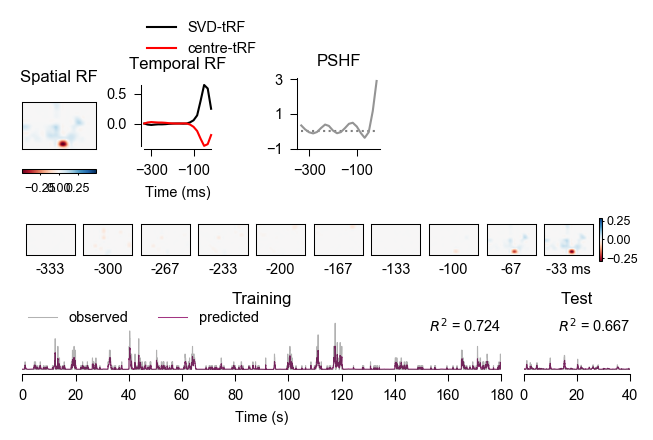

In [9]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key, testing=False)

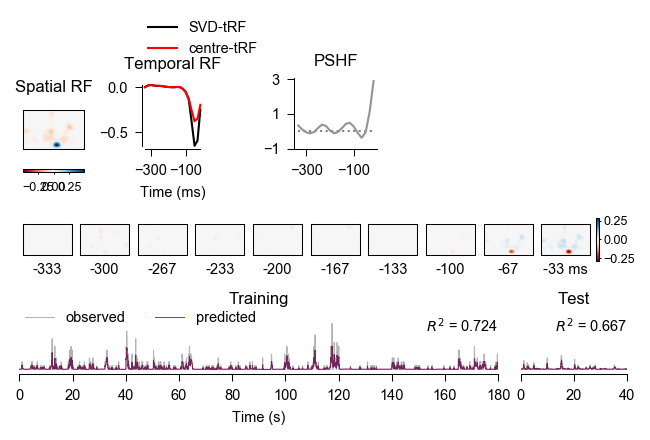

In [12]:
key = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key, testing=True)

## Adjust stRF in plot_model()

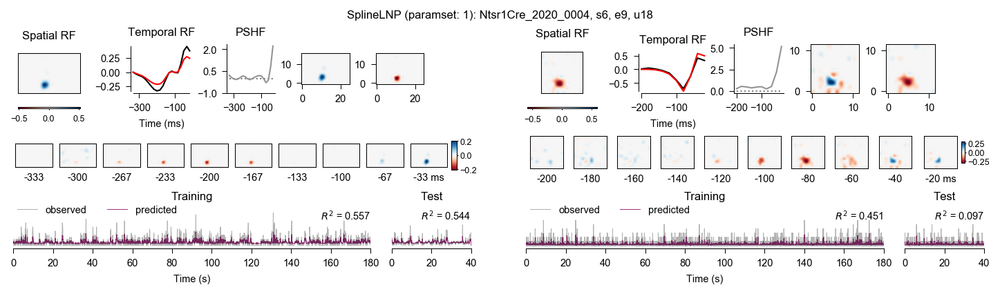

In [4]:
fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

key1 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 10, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key1, gs=gs[0])

key2 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 9, 'spl_paramset': 1}  # spnoise
fig, axs = plot_model(key2, title=True, gs=gs[2])

0.5206134203768881
-0.5845432152611936


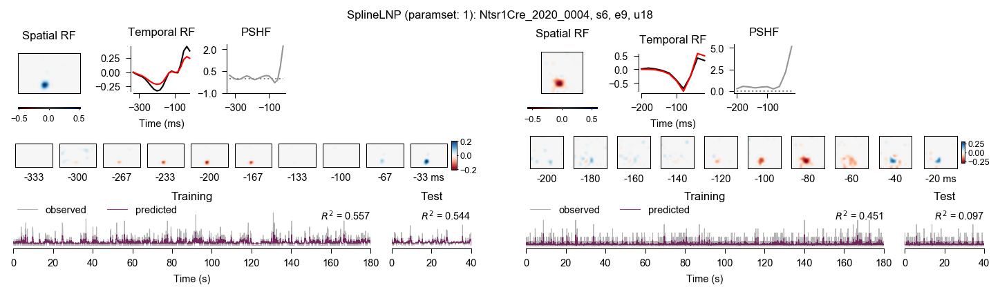

In [4]:
fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

key1 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 10, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key1, gs=gs[0])

key2 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 9, 'spl_paramset': 1}  # spnoise
fig, axs = plot_model(key2, title=True, gs=gs[2])

> /Users/ybauer/code/djd/djd/glms.py(2257)plot_rf_filters()
   2255     import pdb
   2256     pdb.set_trace()
-> 2257     rf = model_out['w_opt']
   2258 
   2259 



ipdb>  c


> /Users/ybauer/code/djd/djd/glms.py(2264)plot_rf_filters()
   2262     dims_sRF = dims[1:]
   2263     pdb.set_trace()
-> 2264     U, S, Vt = randomized_svd(k_norm.reshape(dims_tRF, np.prod(dims_sRF)), 3)
   2265     sRF = Vt[0].reshape(*dims_sRF)  # spatial RF
   2266     tRF = U[:, 0]  # temporal RF



ipdb>  c


> /Users/ybauer/code/djd/djd/glms.py(2269)plot_rf_filters()
   2267 
   2268     pdb.set_trace()
-> 2269     rf_pos_pix, rf_val = get_rf_extreme(rf)
   2270     x_pos, y_pos = rf_pos_pix[0], rf_pos_pix[1]
   2271     tRF2 = rf[:, y_pos, x_pos]



ipdb>  c


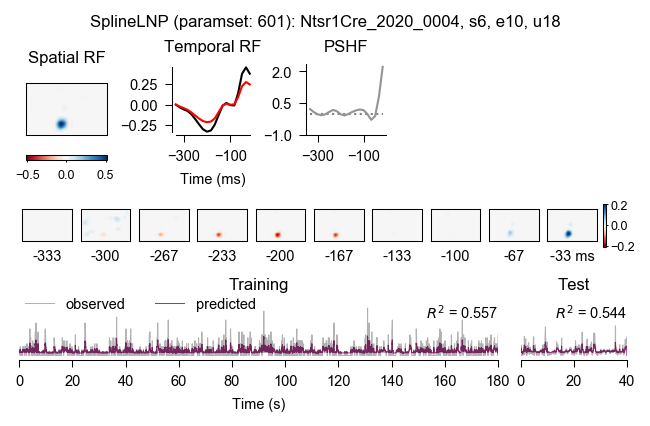

In [4]:
key = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 18}
key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
fig, axs = plot_model(key, title=True)

## Check DB

In [3]:
SplineLNPParams()

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
1,spnoise,softplus,1.0,0.05,0.1,1500,12,8,True,10,8,200,corrcoef,True,10,1,0.0,50.0,False,0,0,False,0,0,False,0,0,False
3,spnoise,softplus,1.0,0.05,0.1,1500,16,8,True,10,8,200,corrcoef,True,10,1,0.0,50.0,False,0,0,False,0,0,False,0,0,False
4,spnoise,softplus,1.0,0.025,0.1,1500,12,8,True,10,8,200,corrcoef,True,10,1,0.0,50.0,False,0,0,False,0,0,False,0,0,False
601,hmov,softplus,1.0,1.4,0.2,1000,12,12,True,20,10,200,corrcoef,False,20,1,0.06,60.0,False,0,0,False,0,0,False,0,0,True
602,hmov,softplus,1.0,1.4,0.2,1000,16,12,True,20,10,200,corrcoef,False,20,1,0.06,60.0,False,0,0,False,0,0,False,0,0,True
603,hmov,softplus,1.0,1.0,0.2,1000,12,12,True,20,10,200,corrcoef,False,20,1,0.06,60.0,False,0,0,False,0,0,False,0,0,True
604,hmov,softplus,1.0,1.4,0.2,1000,12,12,True,20,10,200,corrcoef,False,20,1,0.12,60.0,False,0,0,False,0,0,False,0,0,True
605,hmov,softplus,1.0,1.4,0.2,1000,16,12,True,20,10,200,corrcoef,False,20,1,0.12,60.0,False,0,0,False,0,0,False,0,0,True


In [4]:
SplineLNP()

m strain acronym + counter,s Series number,e Experiment number,"u unit ID, from spyke",spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_n_basis number of basis functions used; computed as the number of temporal dfs times the number of dfs in the two spatial directions,spl_b the intercept for each basis function after fitting,spl_w_opt receptive field estimate after fitting,spl_h the fitted post-spike history filter; could also be empty if pshf='False' in the corresponding parameter set,spl_h_init post-spike history filter at initialization,spl_o the fitted opto filter; could be empty if opto='False' in the corresponding parameter set,spl_o_init opto filter at initialization,spl_r the fitted running filter; could be empty if run='False' in the corresponding parameter set,spl_r_init running filter at initialization,spl_e the fitted eye filter; could be empty if eye='False' in the corresponding parameter set,spl_e_init eye filter at initialization,spl_y_train observation for training sequence,spl_yhat_train predictions for training sequence,spl_y_val observation for validation sequence,spl_yhat_val predictions for validation sequence,spl_y_test mean of observations across test repeats,spl_yhat_test mean of predictions for test sequence repeats,spl_y_test_repeats observation for each test repeat,spl_yhat_test_repeats individual predictions for each repeat of the test sequence; array stored has dimensions nreps x time,"spl_ts automatic timestamp, do not edit"
Ntsr1Cre_2019_0002,3,1,13,1,spnoise,1152,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-06-22 21:12:57
Ntsr1Cre_2019_0002,3,1,13,3,spnoise,2048,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-07-09 23:28:49
Ntsr1Cre_2019_0002,3,1,13,4,spnoise,1152,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-07-09 23:48:51
Ntsr1Cre_2019_0002,3,1,14,1,spnoise,1152,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-06-22 21:14:38
Ntsr1Cre_2019_0002,3,1,14,3,spnoise,2048,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-07-09 23:32:16
Ntsr1Cre_2019_0002,3,1,14,4,spnoise,1152,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-07-09 23:49:44
Ntsr1Cre_2019_0002,3,1,19,1,spnoise,1152,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-06-22 21:16:34
Ntsr1Cre_2019_0002,3,1,19,3,spnoise,2048,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-07-09 23:35:43
Ntsr1Cre_2019_0002,3,1,19,4,spnoise,1152,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-07-09 23:51:39
Ntsr1Cre_2019_0002,3,1,30,1,spnoise,1152,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,=BLOB=,2021-06-22 21:17:35


## Plot model RFs

### Plot hmov vs spnoise model and STA for example unit

/Users/ybauer/code/djd/djd/unit.py:1716: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f.show()


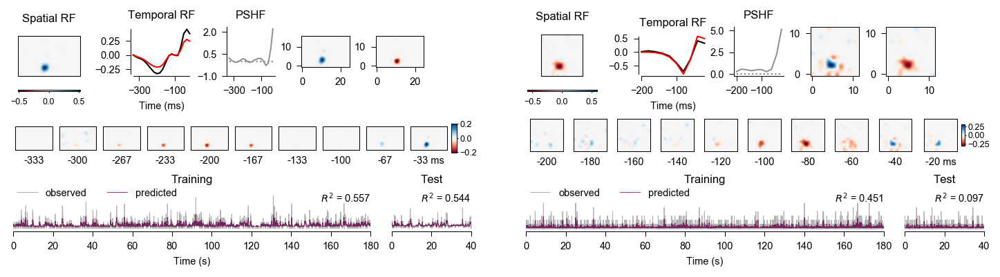

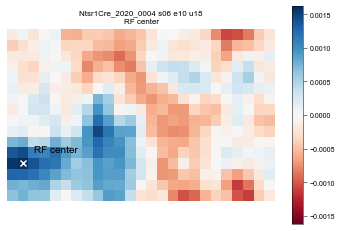

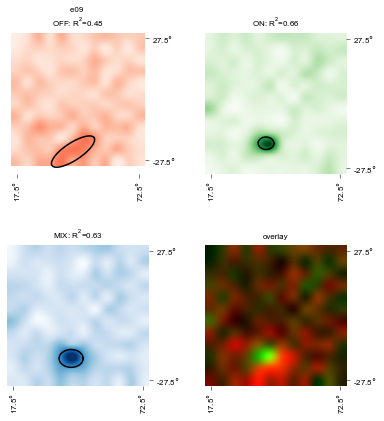

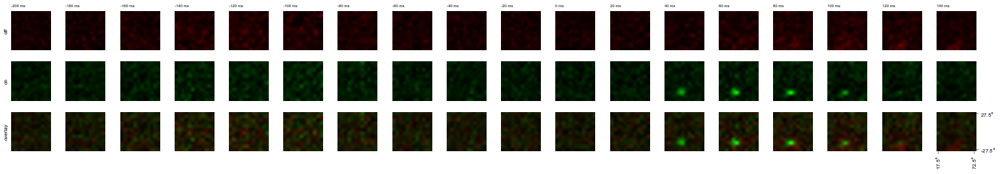

In [13]:
fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

key1 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 10, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key1, gs=gs[0])

key2 = {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'u': 18, 'e': 9, 'spl_paramset': 1}  # spnoise
fig, axs = plot_model(key2, gs=gs[2])

fig, ax = (HmovUnit() & key1).plot_STA()

# Plot sparse noise StimTA
axs = (Tuning() & key2 & {'st8_type': 'none', 'tun_model': 'ellipse'}).plot_rf(ticks='edge', size_centers=False, rgb_overlay=True)
axs = (Unit.Spikes() & key2).sta(tstart=-0.2, tstop=0.15, tres=0.02, precision=3,
                          direction='stimta', ticklabelsize=8, titlesize=6, ylabelsize=8)

/Users/ybauer/code/djd/djd/unit.py:1714: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f.show()


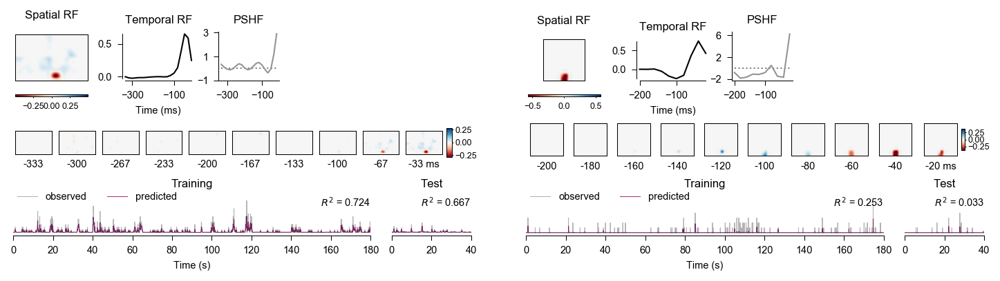

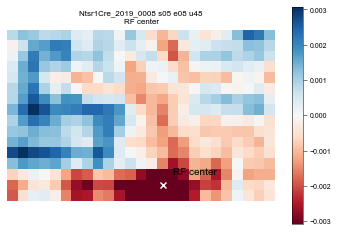

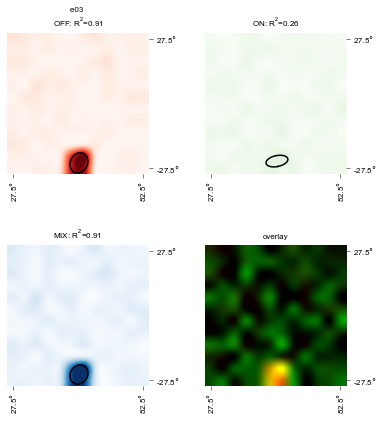

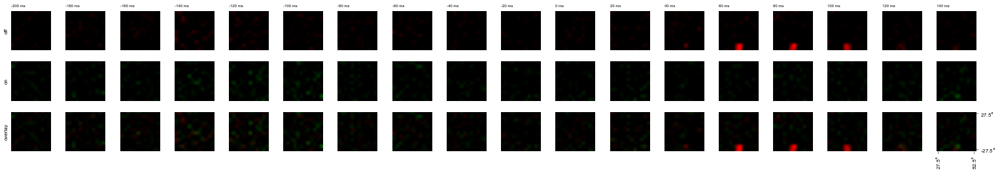

In [5]:
fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

key1 = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 8, 'spl_paramset': 601}  # hmov
fig, axs = plot_model(key1, gs=gs[0])

key2 = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48, 'e': 3, 'spl_paramset': 1}  # spnoise
fig, axs = plot_model(key2, gs=gs[2])

fig, ax = (HmovUnit() & key1).plot_STA()

# Plot sparse noise StimTA
axs = (Tuning() & key2 & {'st8_type': 'none', 'tun_model': 'ellipse'}).plot_rf(ticks='edge', size_centers=False, rgb_overlay=True)
axs = (Unit.Spikes() & key2).sta(tstart=-0.2, tstop=0.15, tres=0.02, precision=3,
                          direction='stimta', ticklabelsize=8, titlesize=6, ylabelsize=8)

### Plot best hmov vs spnoise model for example unit

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 601}
hmov RF pos (x,y): [13  1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 48, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 1]


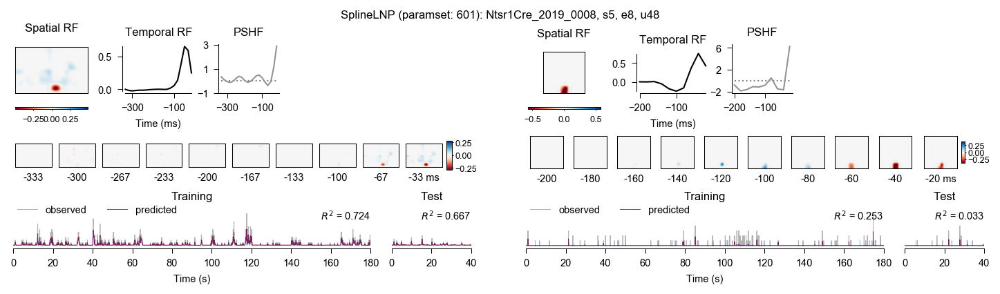

In [6]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((Unit.Properties() & HmovUnit() & SplineLNP() & {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 48}).fetch(dj.key, as_dict=True))

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=1).iterrows():

    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # unit = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 19}
    unit = unit.to_dict()

    # Plot best hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov'}).fetch(dj.key)  # gets all hmov models for unit
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=True, gs=gs[0])
        print(f'hmov key: {key}')

        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'hmov RF pos (x,y): {rf_pos}')        

    # Plot best sparse noise model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise'}).fetch(dj.key)  # gets all spnoise models for unit
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'spnoise key: {key}')
        
        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'spnoise  RF pos (x,y): {rf_pos}')

    plt.show()

### Plot best hmov vs spnoise model for multiple units

#### 2020_0004

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 3, 'spl_paramset': 602}
hmov RF pos (x,y): [9 8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 3, 'spl_paramset': 1}
spnoise  RF pos (x,y): [5 6]


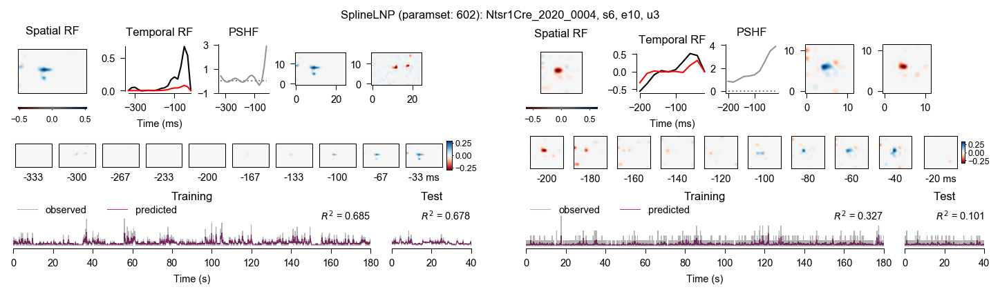

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 5, 'spl_paramset': 602}
hmov RF pos (x,y): [24  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 5, 'spl_paramset': 4}
spnoise  RF pos (x,y): [5 5]


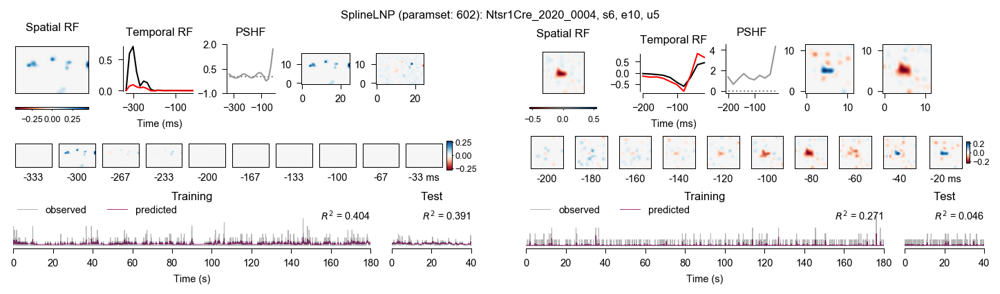

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 6, 'spl_paramset': 602}
hmov RF pos (x,y): [10  6]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 6, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 4]


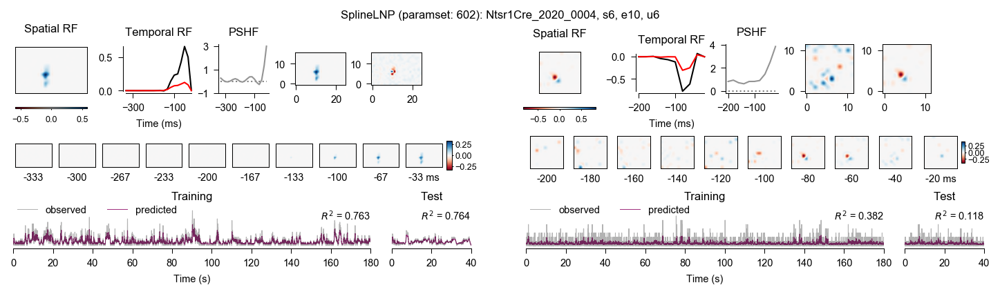

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 7, 'spl_paramset': 601}
hmov RF pos (x,y): [10  5]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 7, 'spl_paramset': 3}
spnoise  RF pos (x,y): [0 6]


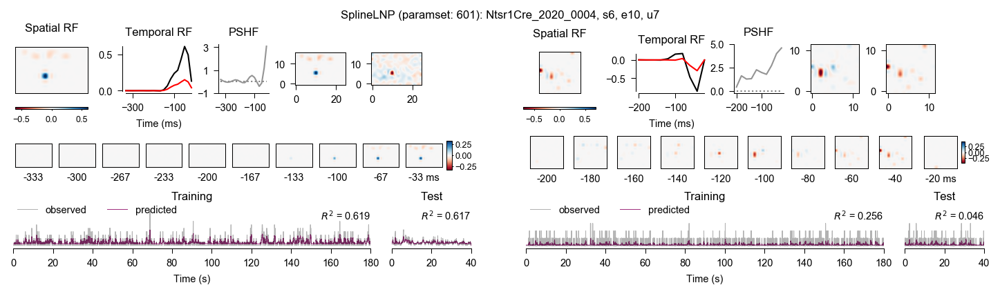

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 9, 'spl_paramset': 602}
hmov RF pos (x,y): [ 0 11]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 9, 'spl_paramset': 3}
spnoise  RF pos (x,y): [4 4]


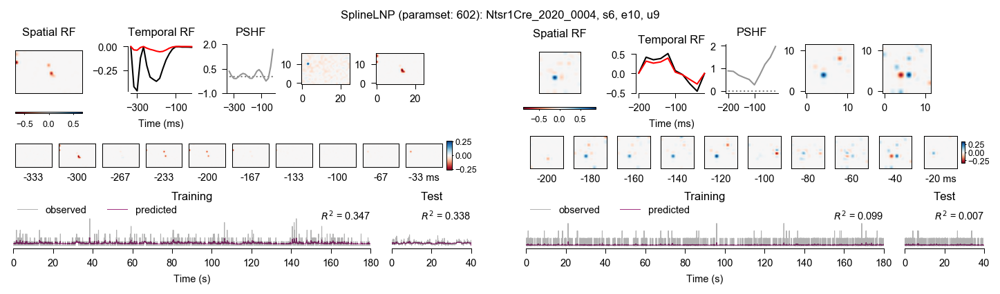

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 11, 'spl_paramset': 602}
hmov RF pos (x,y): [11  4]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 11, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 3]


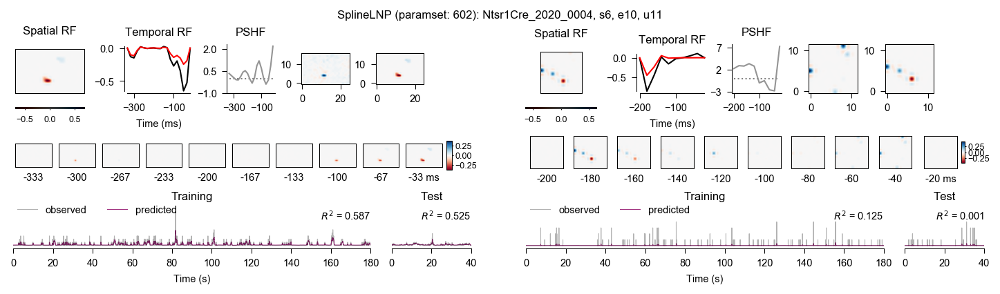

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 13, 'spl_paramset': 601}
hmov RF pos (x,y): [10  4]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 13, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 1]


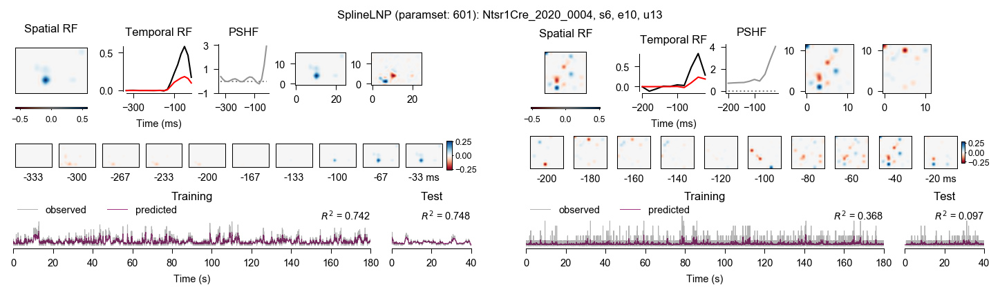

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 16, 'spl_paramset': 602}
hmov RF pos (x,y): [10  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 16, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 3]


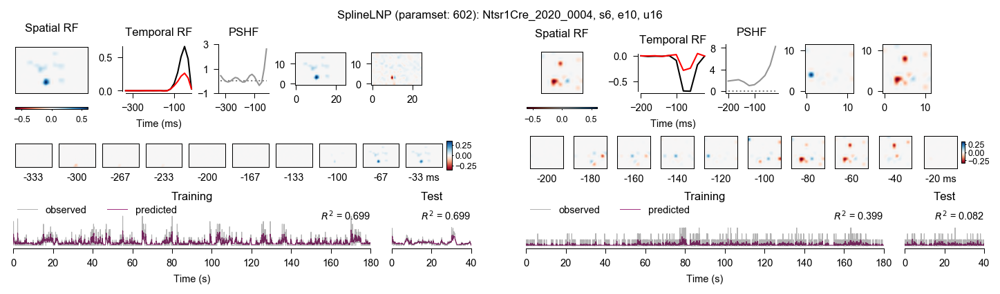

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 18, 'spl_paramset': 601}
hmov RF pos (x,y): [10  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 18, 'spl_paramset': 1}
spnoise  RF pos (x,y): [5 2]


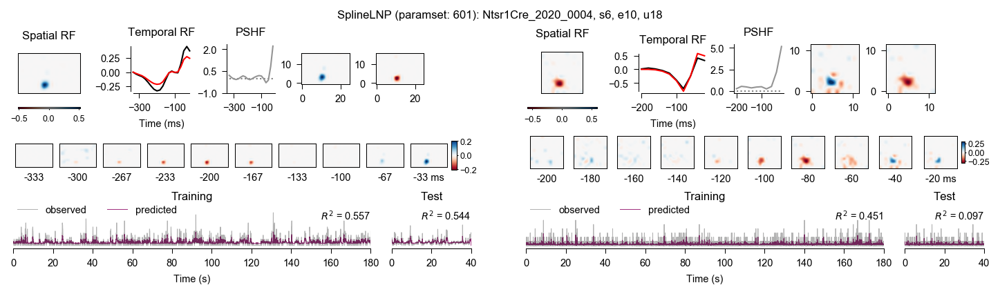

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 20, 'spl_paramset': 602}
hmov RF pos (x,y): [10  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 20, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 2]


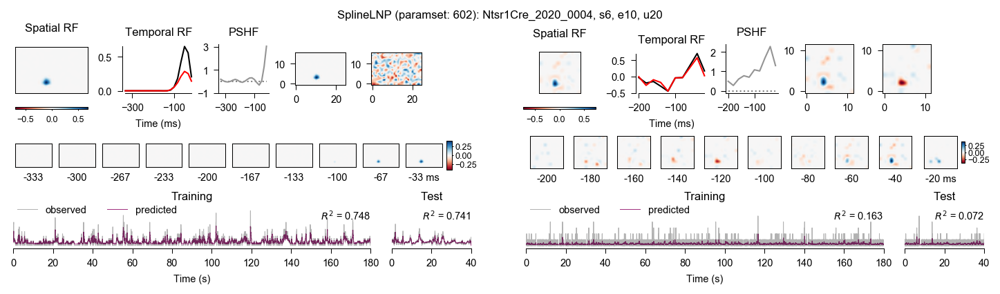

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 21, 'spl_paramset': 602}
hmov RF pos (x,y): [11  1]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 21, 'spl_paramset': 1}
spnoise  RF pos (x,y): [2 3]


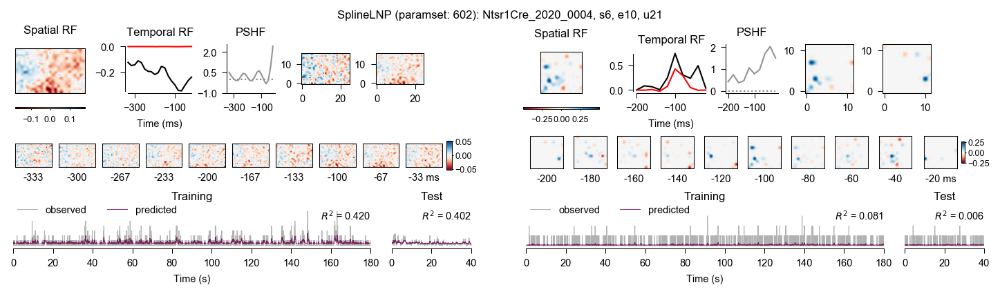

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 25, 'spl_paramset': 603}
hmov RF pos (x,y): [6 8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 25, 'spl_paramset': 4}
spnoise  RF pos (x,y): [1 0]


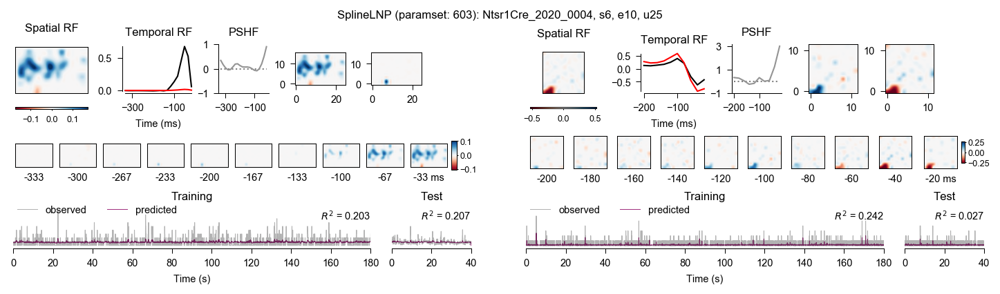

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 27, 'spl_paramset': 602}
hmov RF pos (x,y): [13 15]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 27, 'spl_paramset': 3}
spnoise  RF pos (x,y): [4 0]


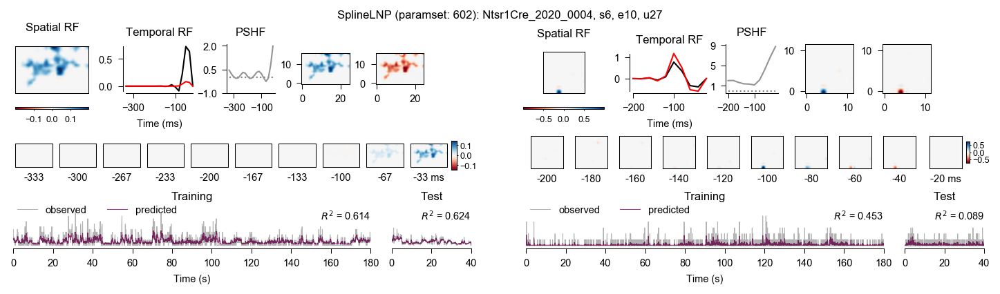

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 30, 'spl_paramset': 602}
hmov RF pos (x,y): [13  0]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 30, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 2]


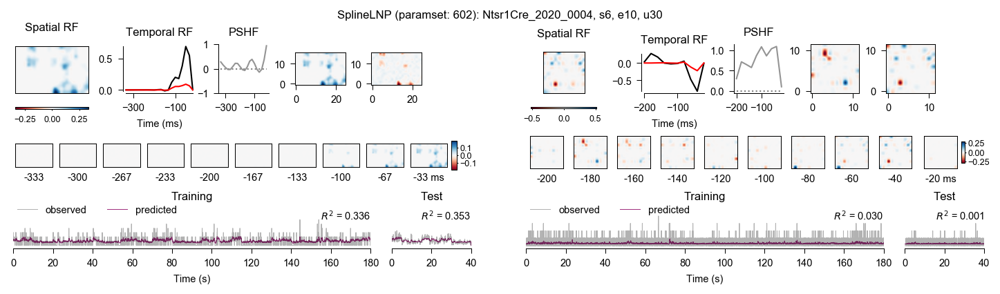

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 31, 'spl_paramset': 602}
hmov RF pos (x,y): [4 9]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 31, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 0 11]


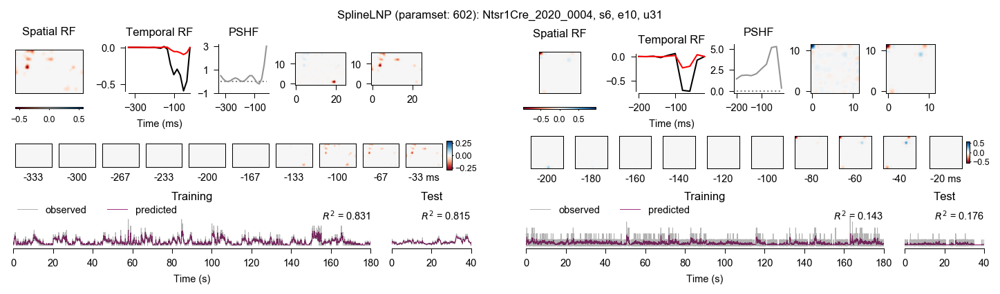

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 32, 'spl_paramset': 602}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 32, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 0]


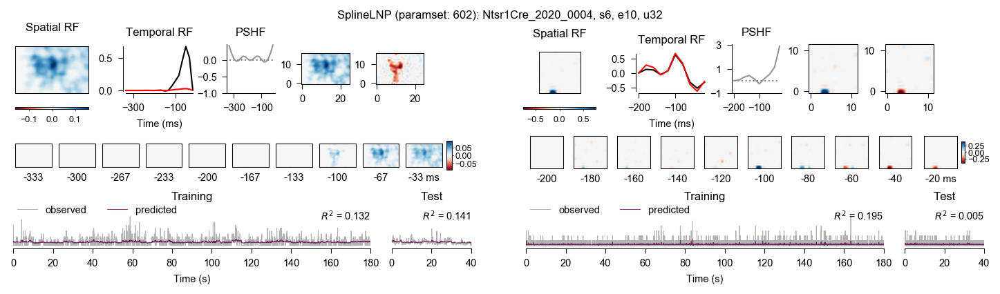

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 36, 'spl_paramset': 602}
hmov RF pos (x,y): [19  1]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 36, 'spl_paramset': 1}
spnoise  RF pos (x,y): [ 0 11]


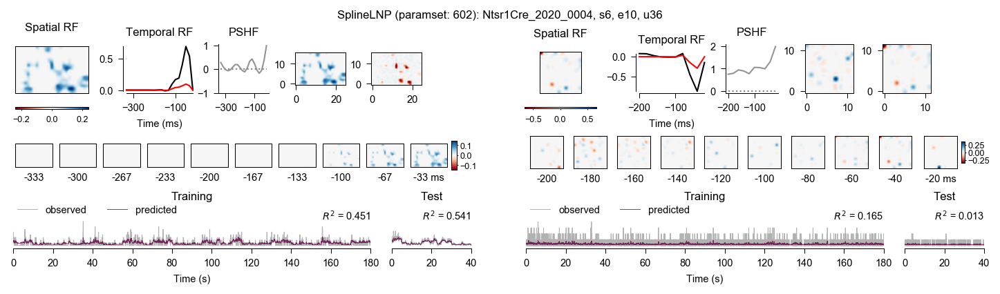

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 39, 'spl_paramset': 602}
hmov RF pos (x,y): [ 5 11]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 39, 'spl_paramset': 3}
spnoise  RF pos (x,y): [9 0]


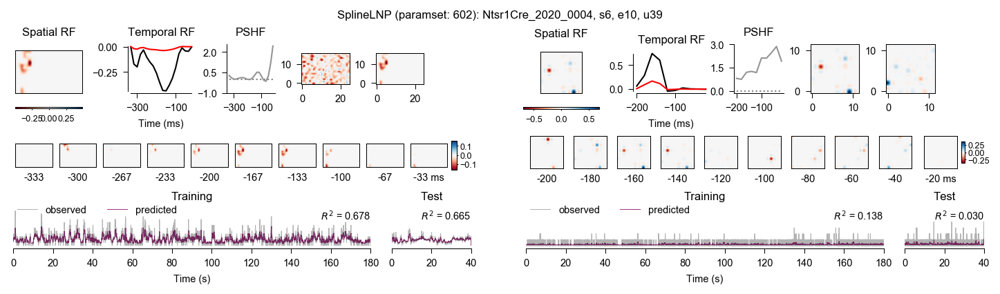

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 40, 'spl_paramset': 602}
hmov RF pos (x,y): [4 2]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 40, 'spl_paramset': 1}
spnoise  RF pos (x,y): [ 7 10]


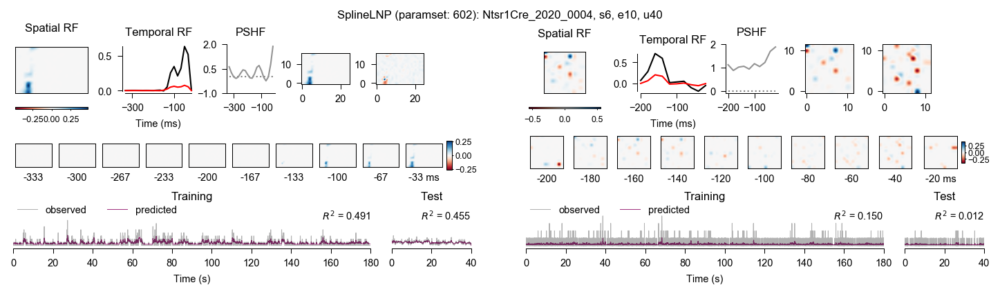

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 42, 'spl_paramset': 602}
hmov RF pos (x,y): [14  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 42, 'spl_paramset': 1}
spnoise  RF pos (x,y): [7 4]


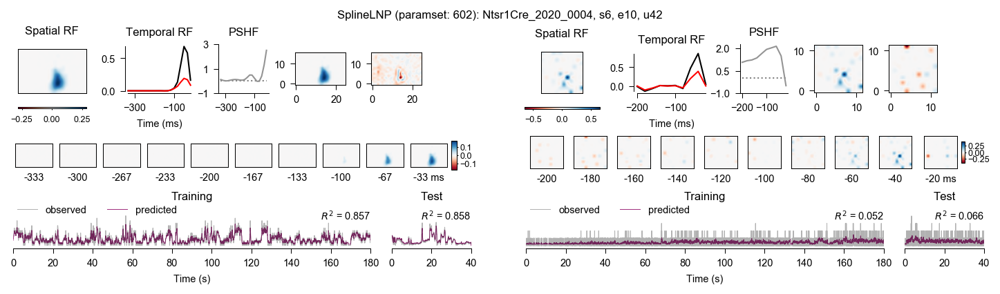

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 43, 'spl_paramset': 601}
hmov RF pos (x,y): [16  2]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 43, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 2]


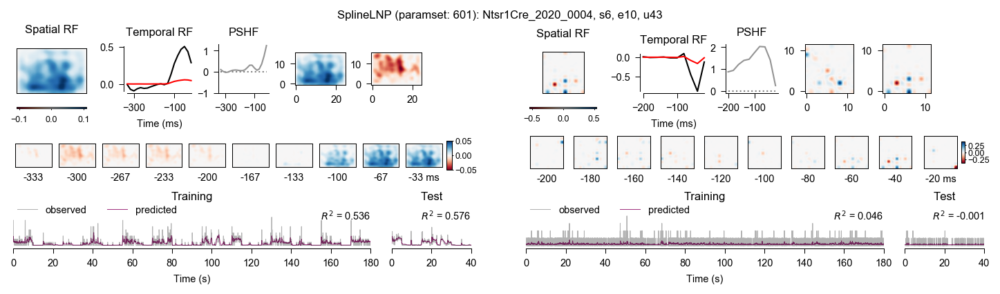

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 45, 'spl_paramset': 602}
hmov RF pos (x,y): [16  4]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 45, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 8 11]


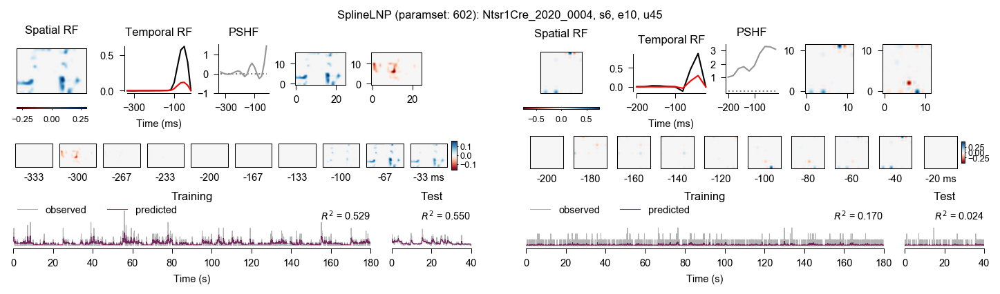

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 47, 'spl_paramset': 601}
hmov RF pos (x,y): [ 4 14]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 47, 'spl_paramset': 1}
spnoise  RF pos (x,y): [7 4]


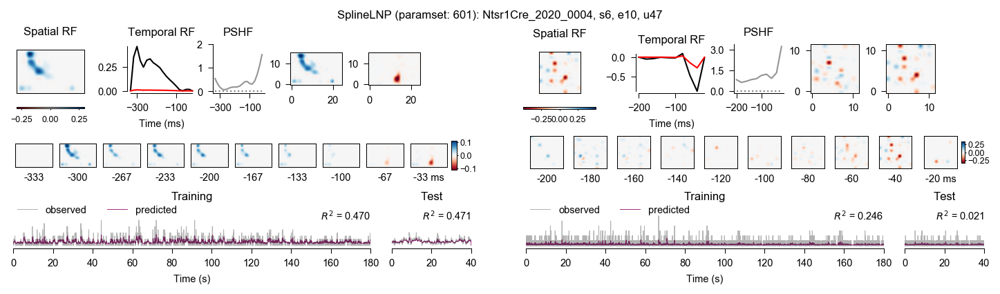

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 48, 'spl_paramset': 602}
hmov RF pos (x,y): [9 6]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 48, 'spl_paramset': 1}
spnoise  RF pos (x,y): [11 11]


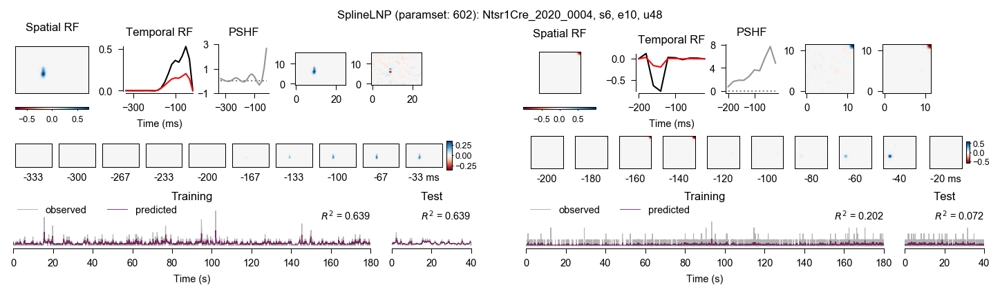

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 51, 'spl_paramset': 601}
hmov RF pos (x,y): [9 8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 51, 'spl_paramset': 3}
spnoise  RF pos (x,y): [9 6]


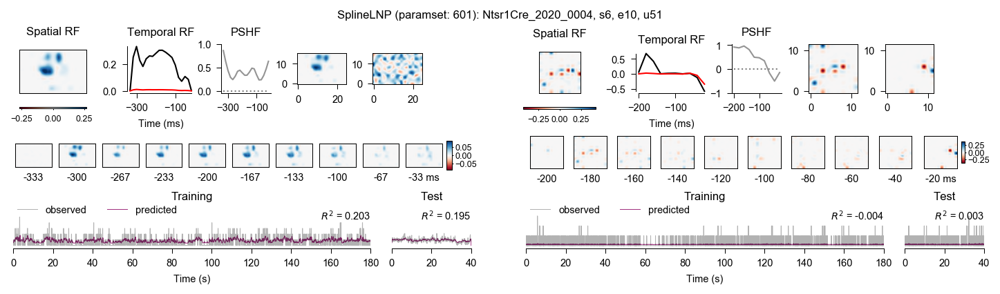

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 52, 'spl_paramset': 602}
hmov RF pos (x,y): [12  8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 52, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 5 11]


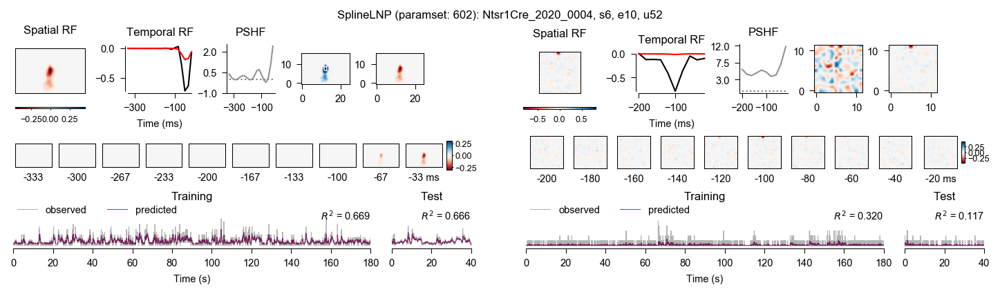

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 56, 'spl_paramset': 603}
hmov RF pos (x,y): [8 8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 56, 'spl_paramset': 1}
spnoise  RF pos (x,y): [8 1]


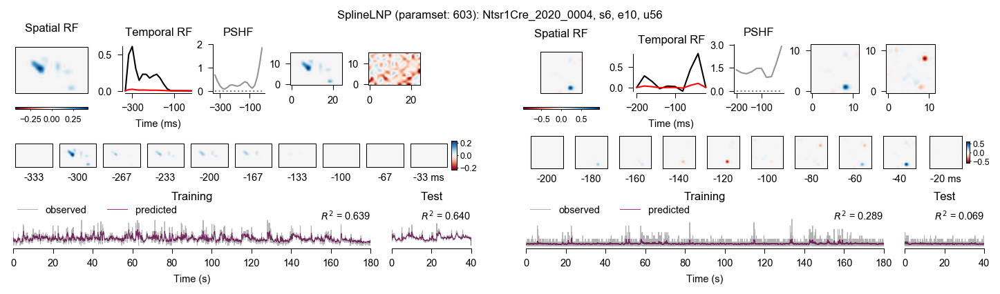

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 58, 'spl_paramset': 602}
hmov RF pos (x,y): [ 3 14]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 58, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  9]


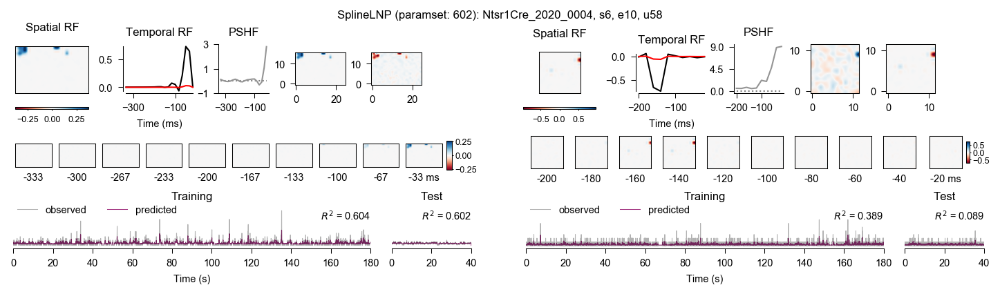

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 61, 'spl_paramset': 603}
hmov RF pos (x,y): [4 4]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 61, 'spl_paramset': 3}
spnoise  RF pos (x,y): [1 8]


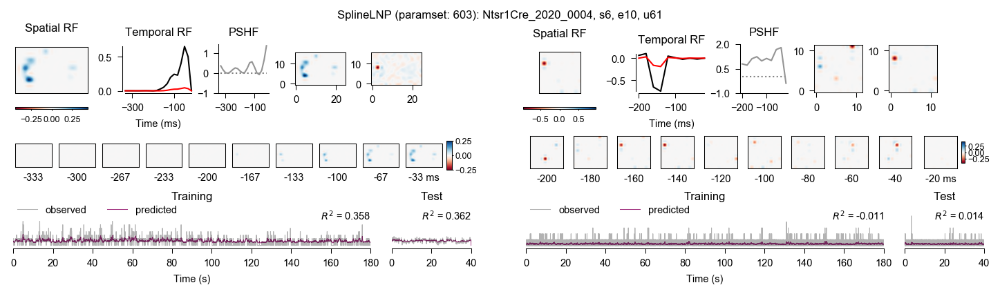

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 66, 'spl_paramset': 603}
hmov RF pos (x,y): [14  8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 66, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 9]


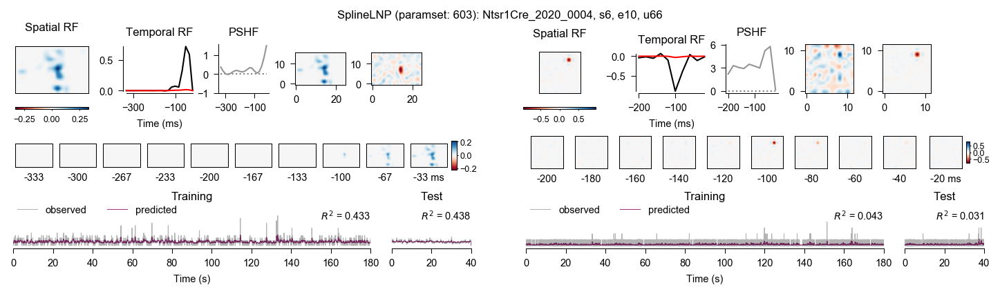

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 68, 'spl_paramset': 602}
hmov RF pos (x,y): [19 11]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 68, 'spl_paramset': 3}
spnoise  RF pos (x,y): [7 3]


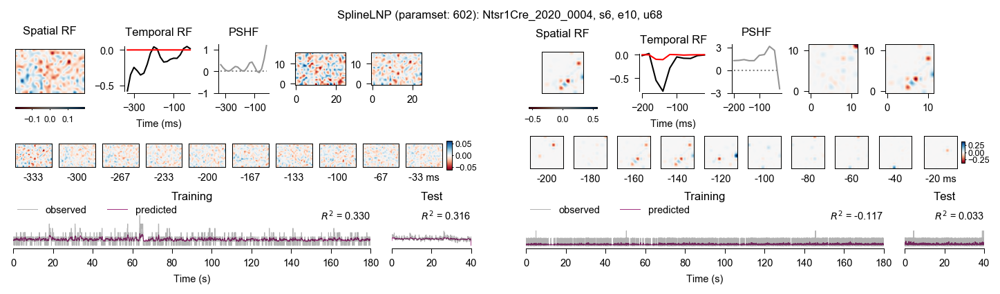

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 70, 'spl_paramset': 602}
hmov RF pos (x,y): [5 2]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 70, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 2]


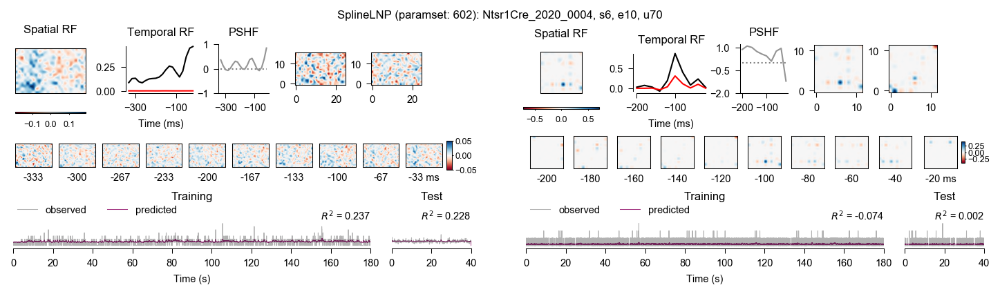

In [5]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((Unit.Properties() & HmovUnit() & SplineLNP() & {'m': 'Ntsr1Cre_2020_0004'}).fetch(dj.key, as_dict=True))

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=len(units)).iterrows():

    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # unit = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 19}
    unit = unit.to_dict()

    # Plot best hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov'}).fetch(dj.key)  # gets all hmov models for unit
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
        key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=True, gs=gs[0])
        print(f'hmov key: {key}')

        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'hmov RF pos (x,y): {rf_pos}')        

    # Plot best sparse noise model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise'}).fetch(dj.key)  # gets all spnoise models for unit
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
        key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'spnoise key: {key}')
        
        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'spnoise  RF pos (x,y): {rf_pos}')

    plt.show()

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 3, 'spl_paramset': 602}
hmov RF pos (x,y): [9 8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 3, 'spl_paramset': 1}
spnoise  RF pos (x,y): [5 6]


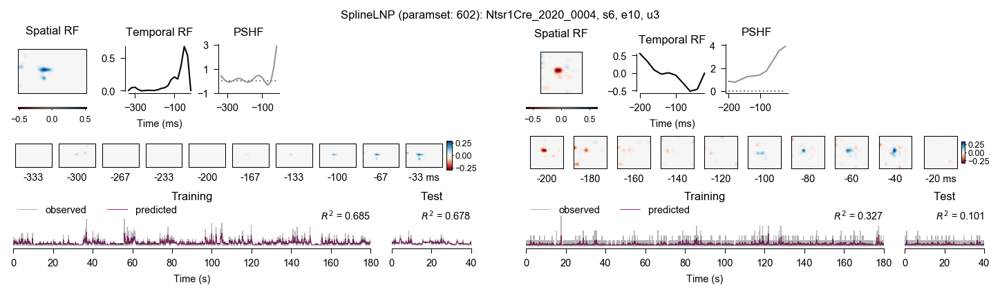

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 5, 'spl_paramset': 602}
hmov RF pos (x,y): [24  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 5, 'spl_paramset': 4}
spnoise  RF pos (x,y): [5 5]


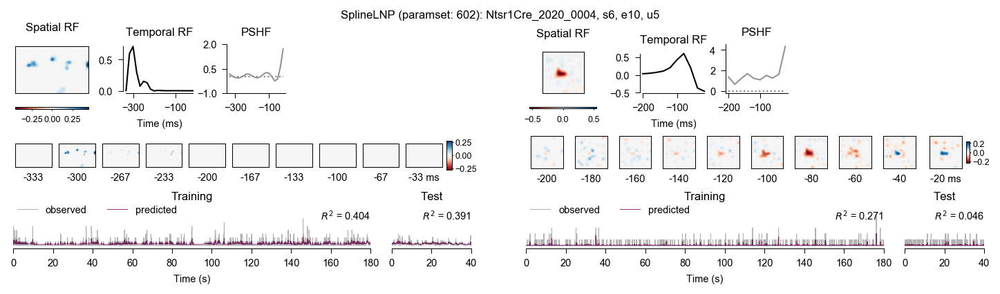

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 6, 'spl_paramset': 602}
hmov RF pos (x,y): [10  6]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 6, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 4]


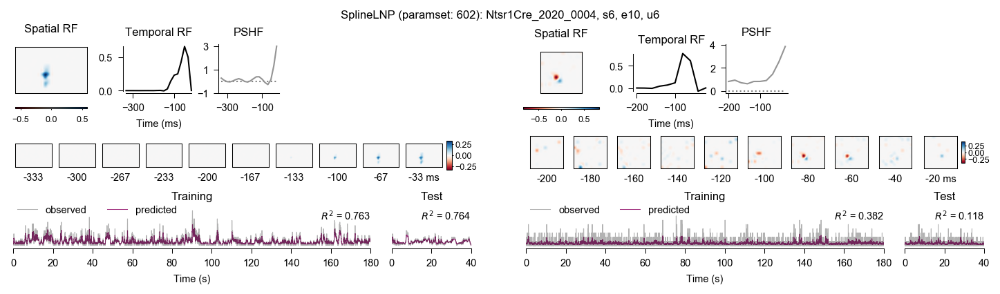

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 7, 'spl_paramset': 601}
hmov RF pos (x,y): [10  5]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 7, 'spl_paramset': 3}
spnoise  RF pos (x,y): [0 6]


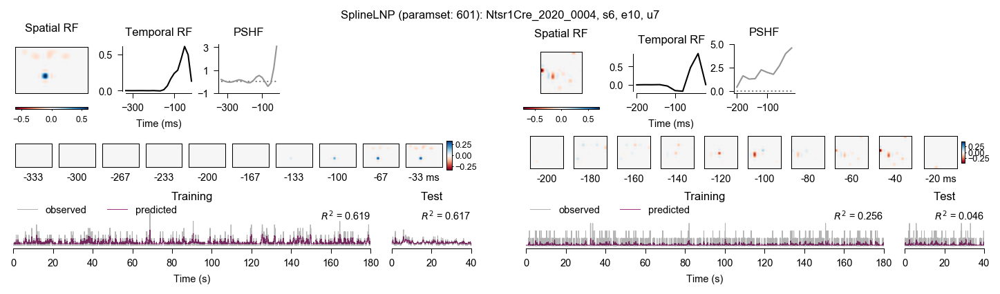

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 9, 'spl_paramset': 602}
hmov RF pos (x,y): [ 0 11]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 9, 'spl_paramset': 3}
spnoise  RF pos (x,y): [4 4]


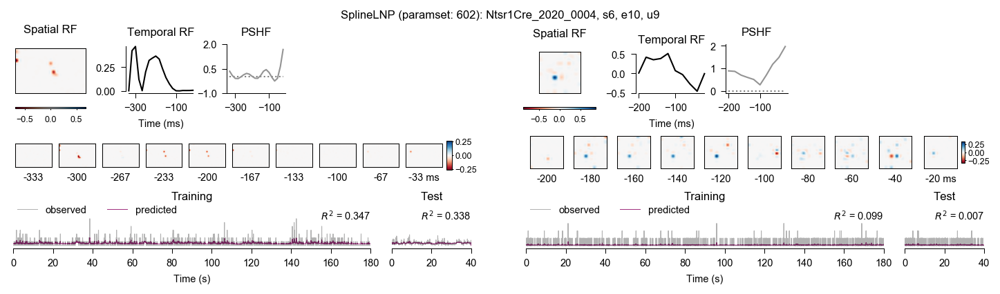

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 11, 'spl_paramset': 602}
hmov RF pos (x,y): [11  4]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 11, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 3]


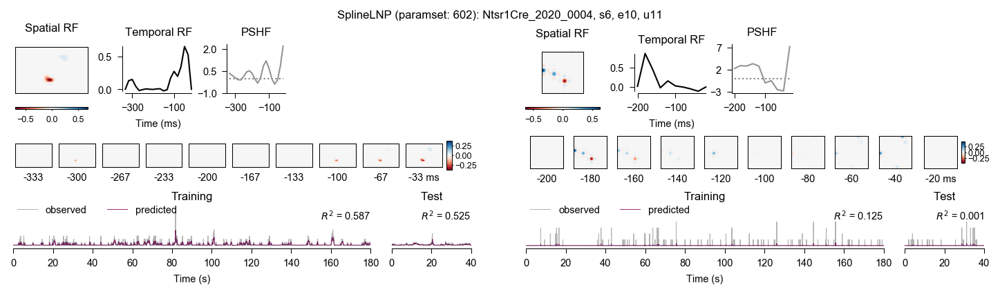

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 13, 'spl_paramset': 601}
hmov RF pos (x,y): [10  4]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 13, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 1]


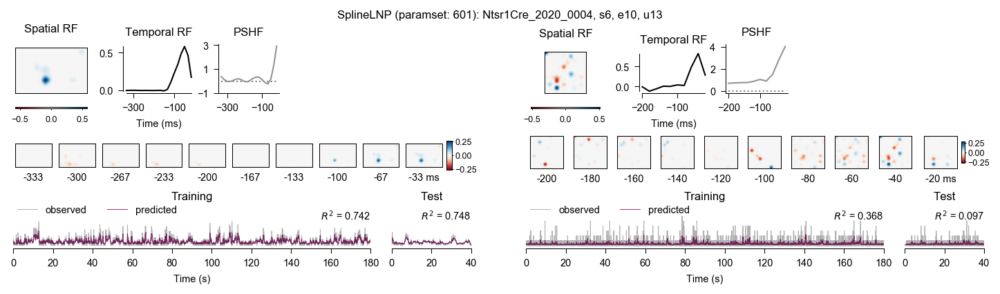

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 16, 'spl_paramset': 602}
hmov RF pos (x,y): [10  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 16, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 3]


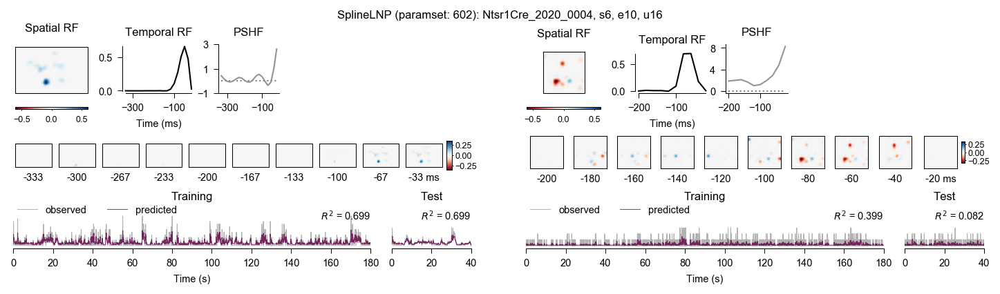

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 18, 'spl_paramset': 602}
hmov RF pos (x,y): [10  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 18, 'spl_paramset': 1}
spnoise  RF pos (x,y): [5 2]


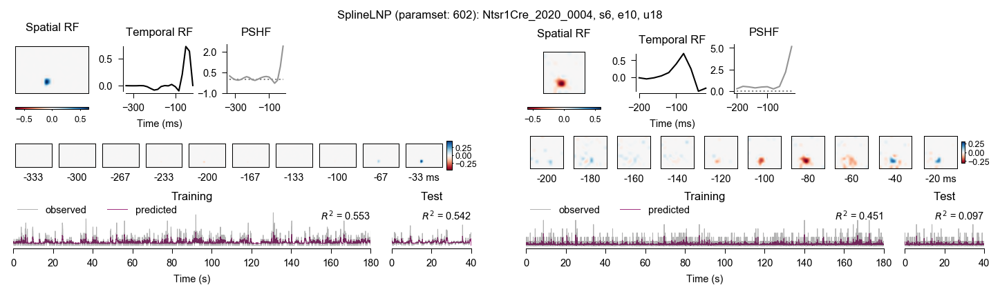

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 20, 'spl_paramset': 602}
hmov RF pos (x,y): [10  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 20, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 2]


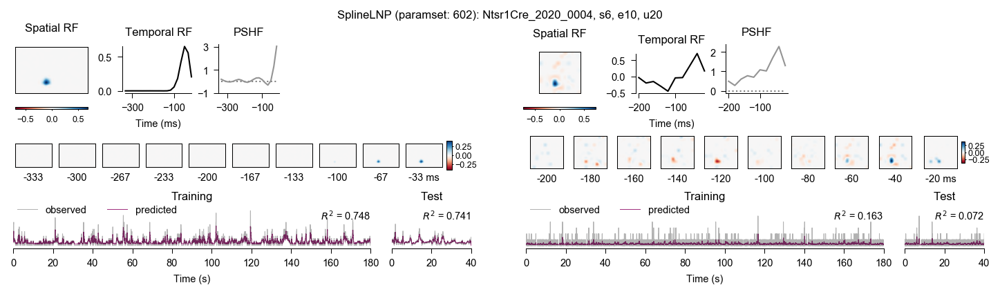

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 21, 'spl_paramset': 602}
hmov RF pos (x,y): [11  1]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 21, 'spl_paramset': 1}
spnoise  RF pos (x,y): [2 3]


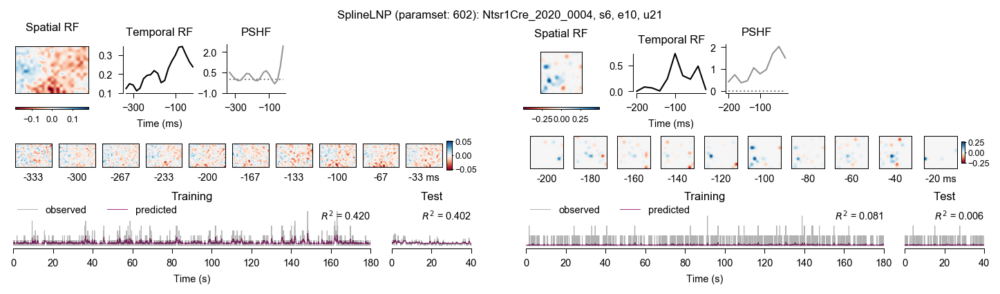

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 25, 'spl_paramset': 602}
hmov RF pos (x,y): [ 4 11]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 25, 'spl_paramset': 4}
spnoise  RF pos (x,y): [1 0]


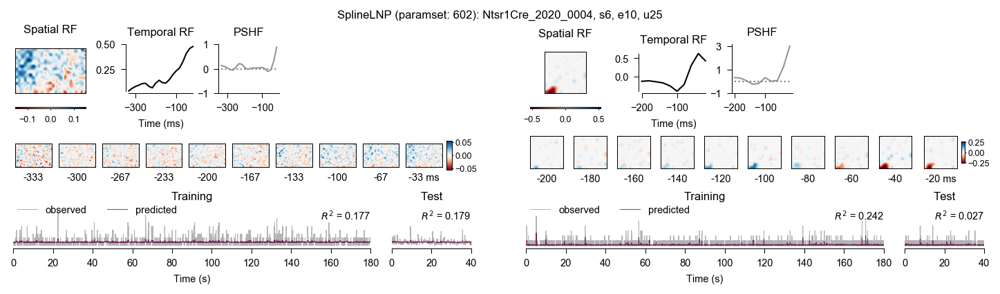

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 27, 'spl_paramset': 602}
hmov RF pos (x,y): [13 15]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 27, 'spl_paramset': 3}
spnoise  RF pos (x,y): [4 0]


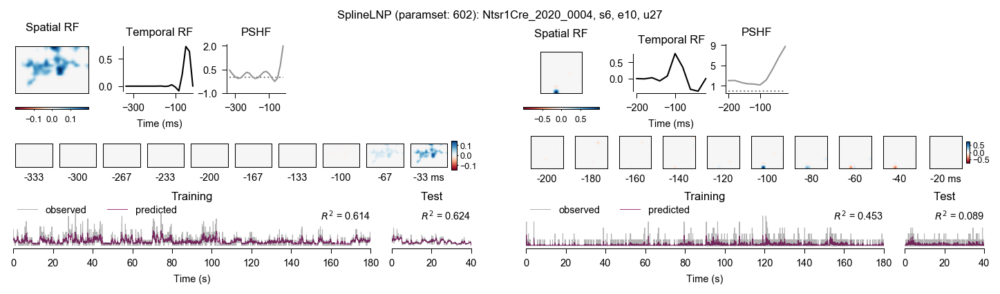

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 30, 'spl_paramset': 602}
hmov RF pos (x,y): [13  0]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 30, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 2]


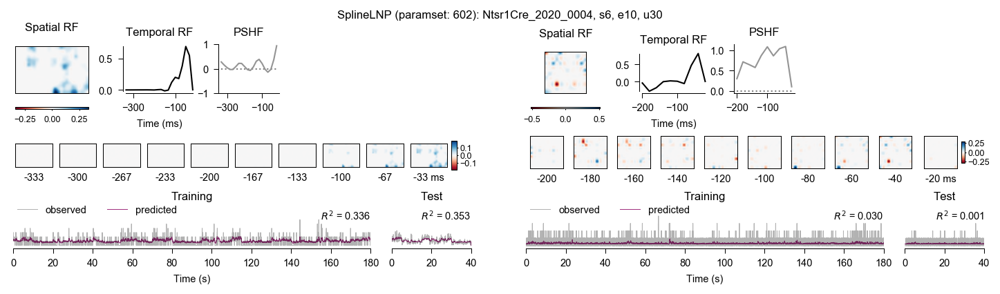

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 31, 'spl_paramset': 602}
hmov RF pos (x,y): [4 9]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 31, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 0 11]


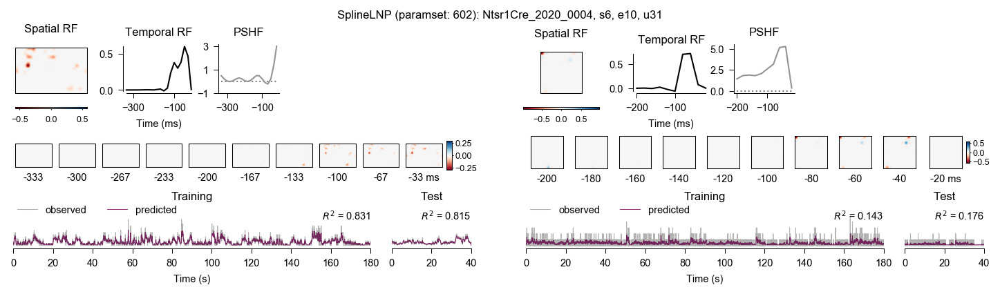

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 32, 'spl_paramset': 602}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 32, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 0]


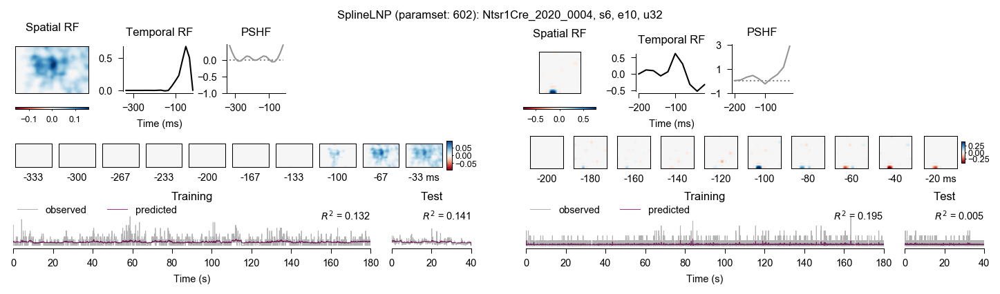

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 36, 'spl_paramset': 602}
hmov RF pos (x,y): [19  1]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 36, 'spl_paramset': 1}
spnoise  RF pos (x,y): [ 0 11]


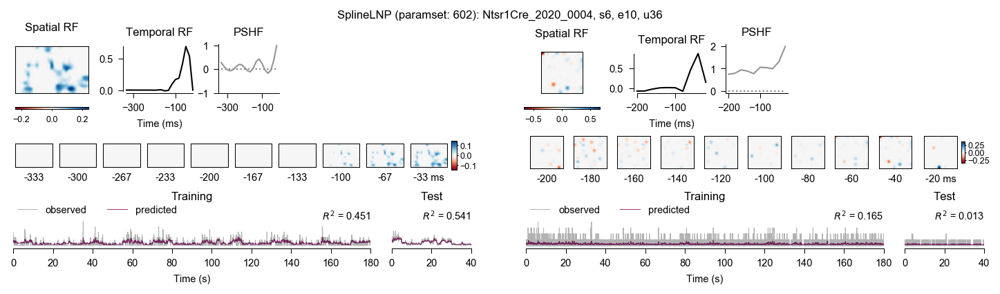

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 39, 'spl_paramset': 602}
hmov RF pos (x,y): [ 5 11]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 39, 'spl_paramset': 3}
spnoise  RF pos (x,y): [9 0]


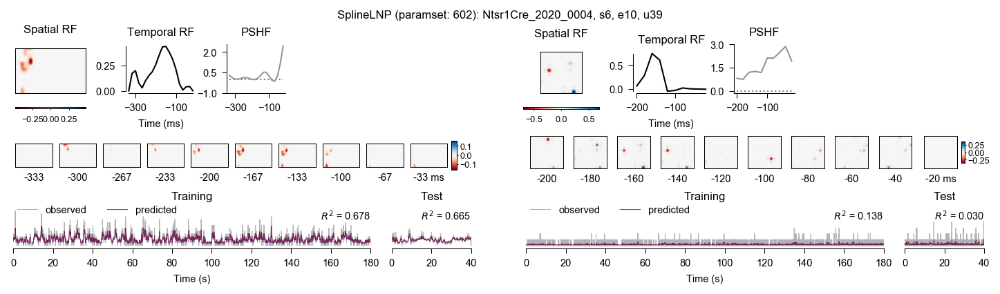

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 40, 'spl_paramset': 602}
hmov RF pos (x,y): [4 2]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 40, 'spl_paramset': 1}
spnoise  RF pos (x,y): [ 7 10]


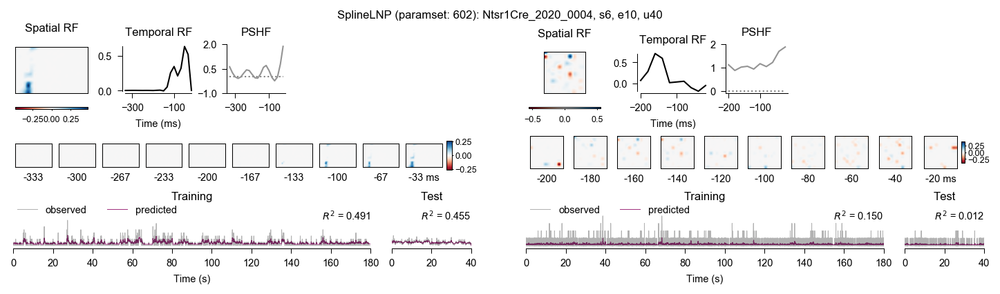

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 42, 'spl_paramset': 602}
hmov RF pos (x,y): [14  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 42, 'spl_paramset': 1}
spnoise  RF pos (x,y): [7 4]


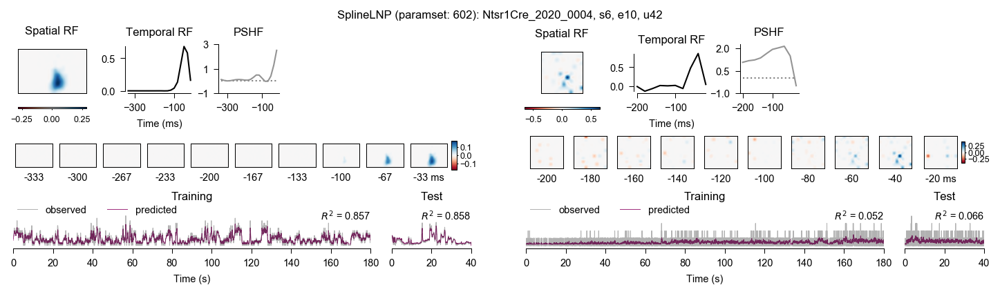

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 43, 'spl_paramset': 601}
hmov RF pos (x,y): [16  2]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 43, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 0]


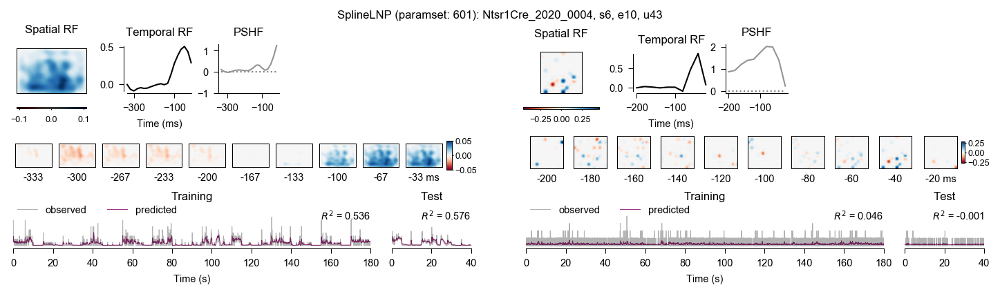

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 45, 'spl_paramset': 602}
hmov RF pos (x,y): [16  4]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 45, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 8 11]


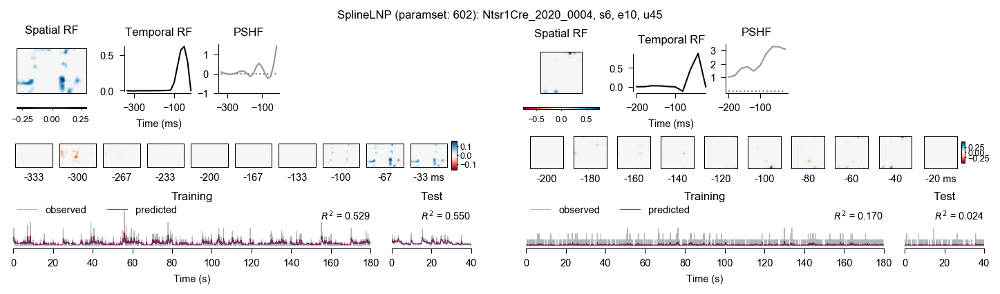

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 47, 'spl_paramset': 603}
hmov RF pos (x,y): [13  2]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 47, 'spl_paramset': 1}
spnoise  RF pos (x,y): [7 4]


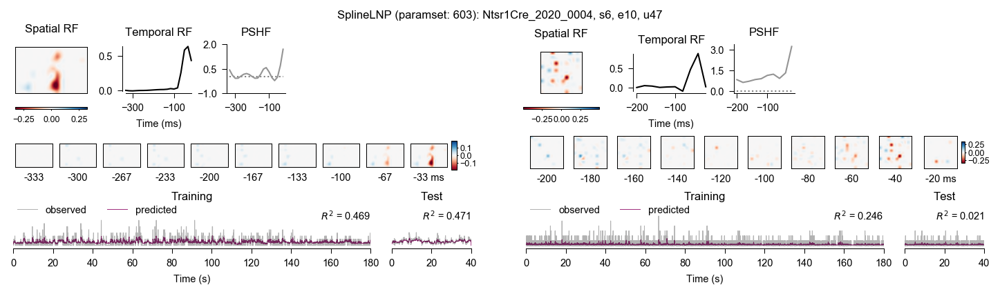

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 48, 'spl_paramset': 602}
hmov RF pos (x,y): [9 6]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 48, 'spl_paramset': 1}
spnoise  RF pos (x,y): [11 11]


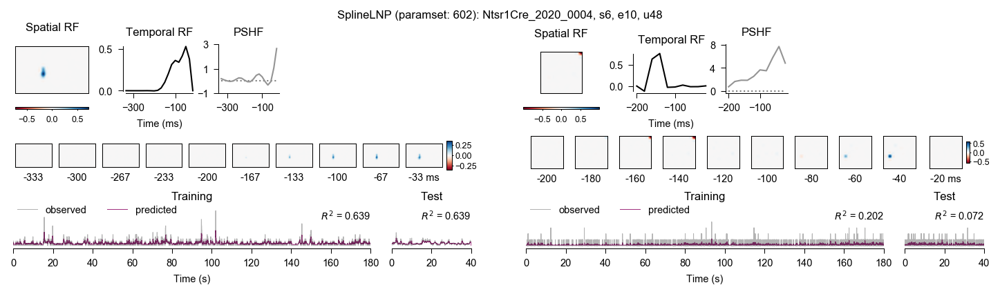

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 51, 'spl_paramset': 601}
hmov RF pos (x,y): [9 8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 51, 'spl_paramset': 3}
spnoise  RF pos (x,y): [9 6]


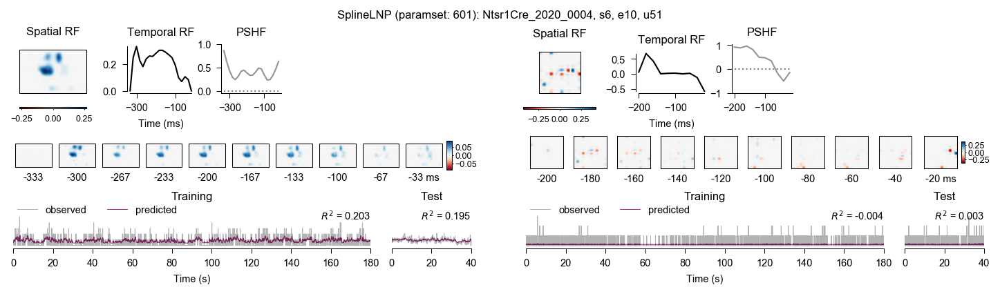

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 52, 'spl_paramset': 602}
hmov RF pos (x,y): [12  8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 52, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 5 11]


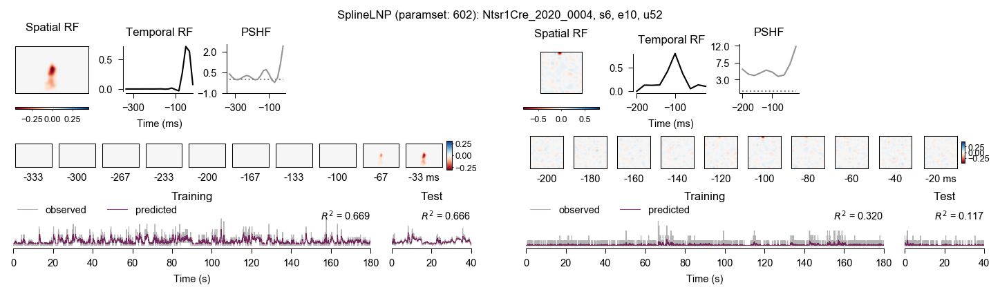

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 56, 'spl_paramset': 602}
hmov RF pos (x,y): [23  1]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 56, 'spl_paramset': 1}
spnoise  RF pos (x,y): [8 1]


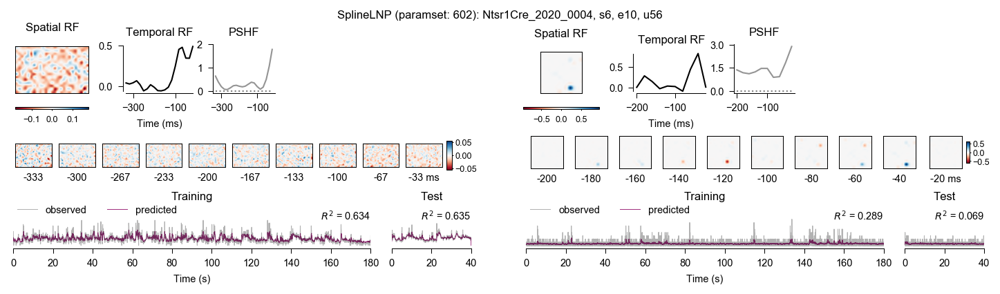

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 58, 'spl_paramset': 602}
hmov RF pos (x,y): [ 3 14]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 58, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  9]


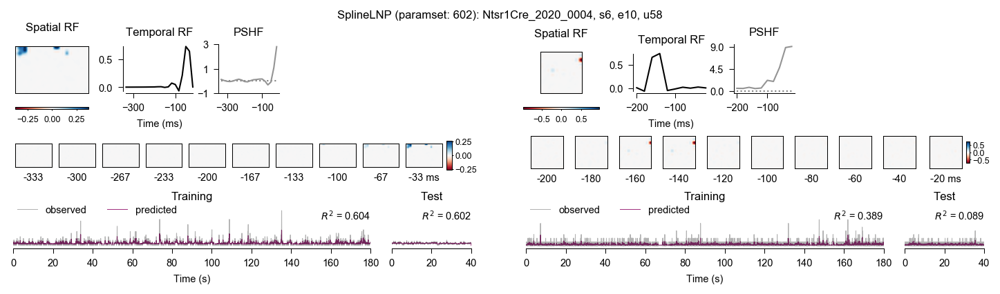

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 61, 'spl_paramset': 602}
hmov RF pos (x,y): [3 8]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 61, 'spl_paramset': 3}
spnoise  RF pos (x,y): [1 8]


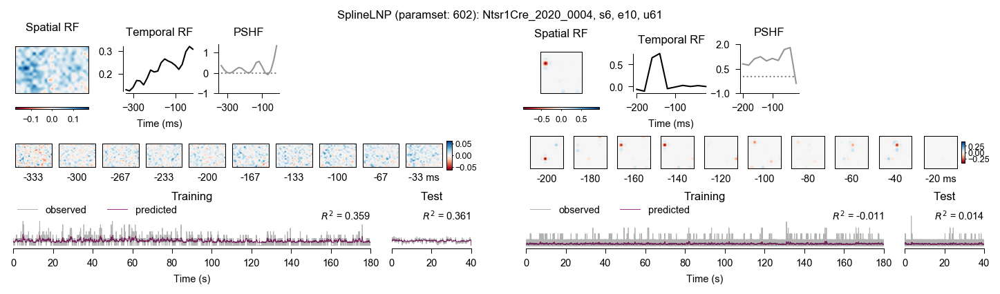

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 66, 'spl_paramset': 602}
hmov RF pos (x,y): [5 1]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 66, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 9]


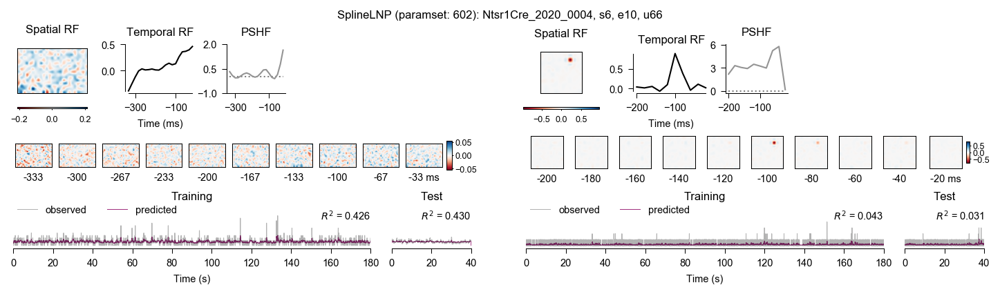

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 68, 'spl_paramset': 602}
hmov RF pos (x,y): [19 11]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 68, 'spl_paramset': 3}
spnoise  RF pos (x,y): [7 3]


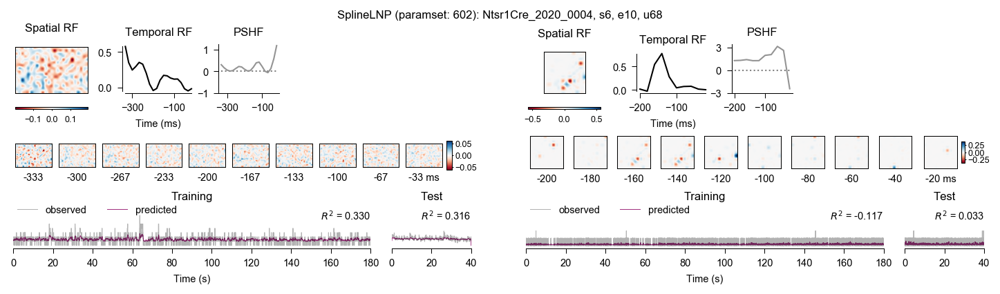

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 70, 'spl_paramset': 602}
hmov RF pos (x,y): [5 2]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 70, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 2]


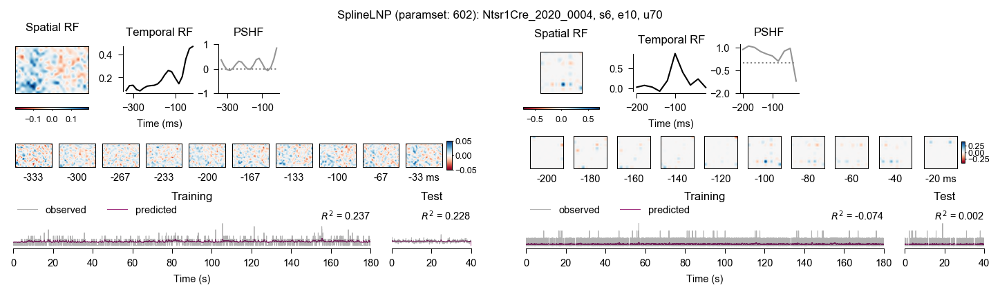

In [5]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((Unit.Properties() & HmovUnit() & SplineLNP() & {'m': 'Ntsr1Cre_2020_0004'}).fetch(dj.key, as_dict=True))

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=len(units)).iterrows():

    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # unit = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 19}
    unit = unit.to_dict()

    # Plot best hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov'}).fetch(dj.key)  # gets all hmov models for unit
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=True, gs=gs[0])
        print(f'hmov key: {key}')

        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'hmov RF pos (x,y): {rf_pos}')        

    # Plot best sparse noise model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise'}).fetch(dj.key)  # gets all spnoise models for unit
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'spnoise key: {key}')
        
        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'spnoise  RF pos (x,y): {rf_pos}')

    plt.show()

#### 2019_0008

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 5, 'spl_paramset': 603}
hmov RF pos (x,y): [13 10]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 5, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 7]


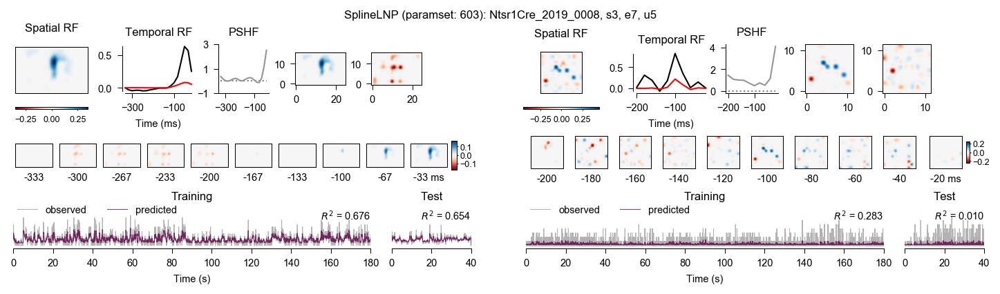

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 6, 'spl_paramset': 604}
hmov RF pos (x,y): [22 17]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 6, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 9]


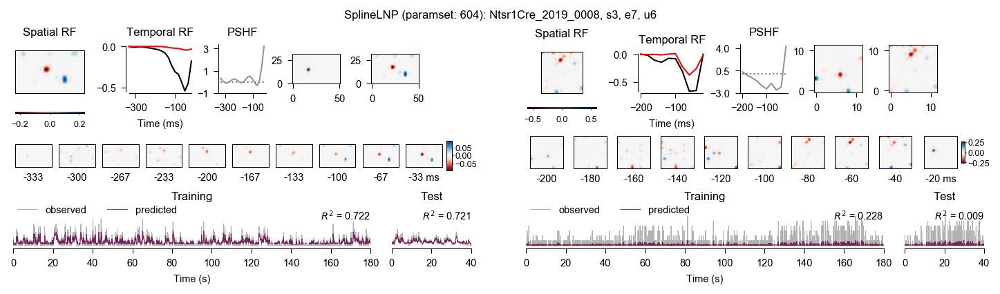

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'u': 11}.
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 11, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 8]


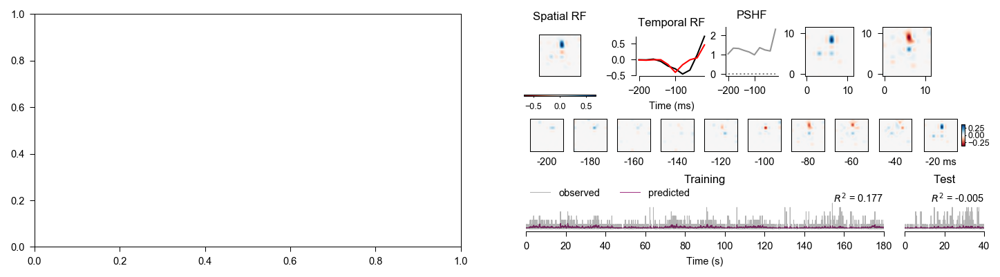

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 14, 'spl_paramset': 601}
hmov RF pos (x,y): [13  7]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 14, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 6]


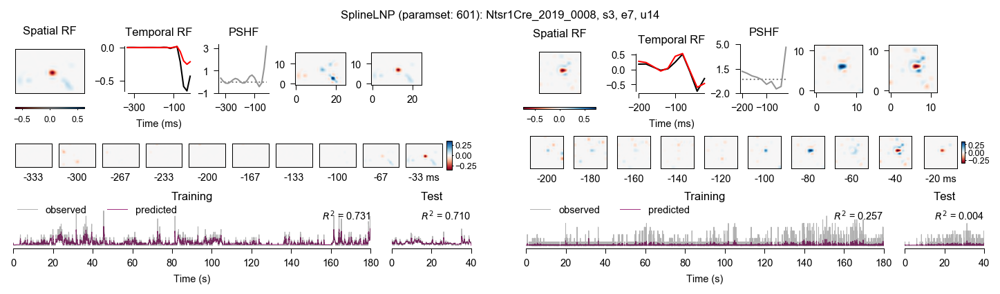

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 17, 'spl_paramset': 603}
hmov RF pos (x,y): [13  5]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 17, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 0 11]


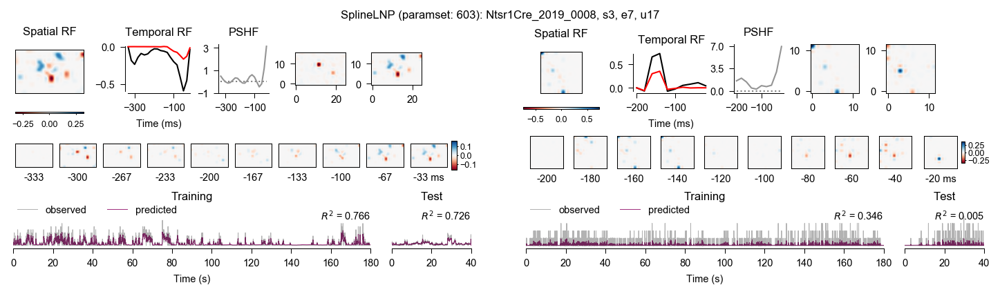

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 18, 'spl_paramset': 602}
hmov RF pos (x,y): [13  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 18, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 7]


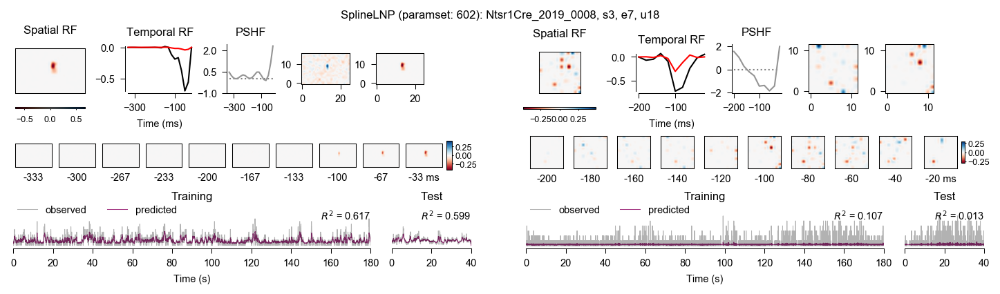

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 20, 'spl_paramset': 601}
hmov RF pos (x,y): [14  6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 20, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 4]


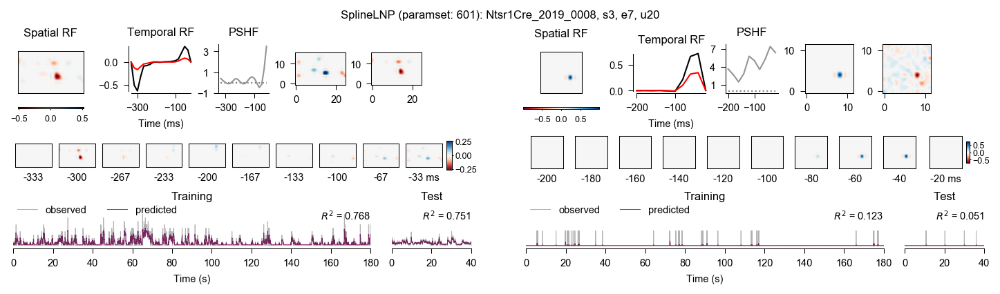

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 22, 'spl_paramset': 602}
hmov RF pos (x,y): [13 10]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 22, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  6]


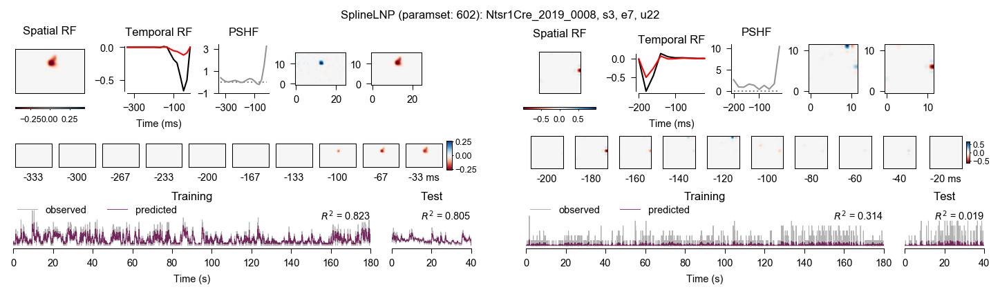

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 25, 'spl_paramset': 602}
hmov RF pos (x,y): [12 11]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 25, 'spl_paramset': 4}
spnoise  RF pos (x,y): [5 3]


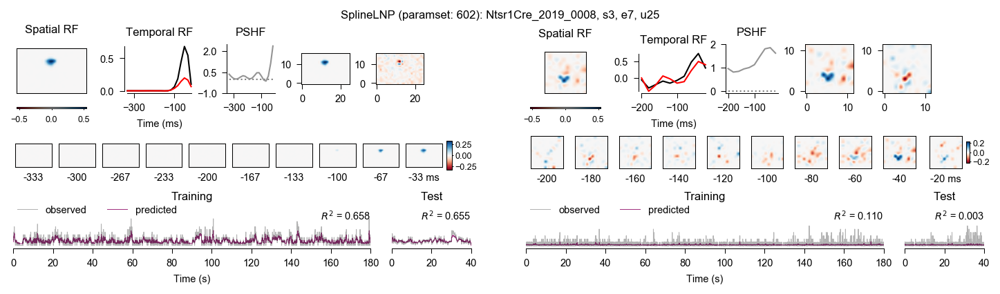

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'u': 26}.
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 26, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 4]


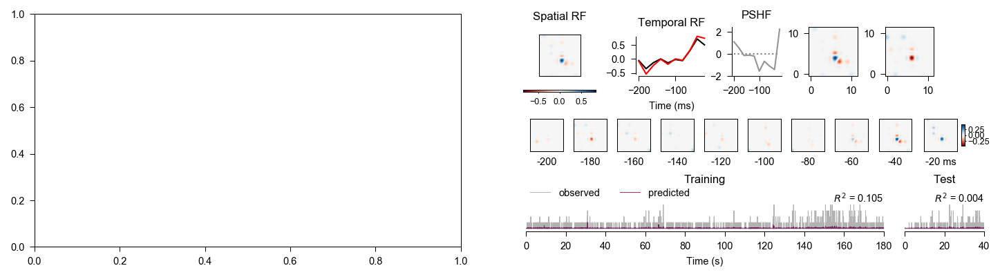

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 30, 'spl_paramset': 602}
hmov RF pos (x,y): [ 8 10]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 30, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 3]


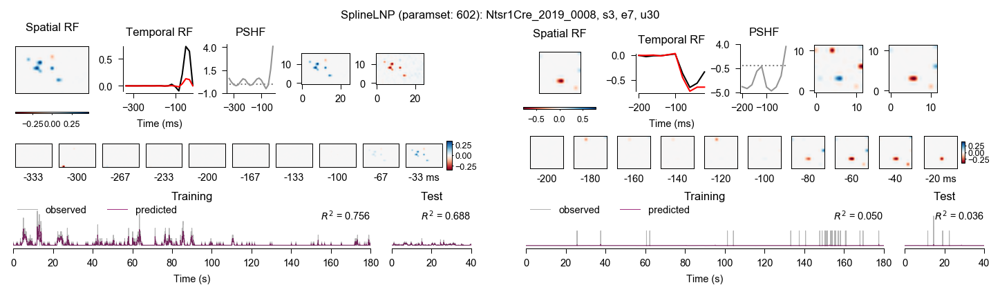

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 34, 'spl_paramset': 602}
hmov RF pos (x,y): [10  0]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 34, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 2]


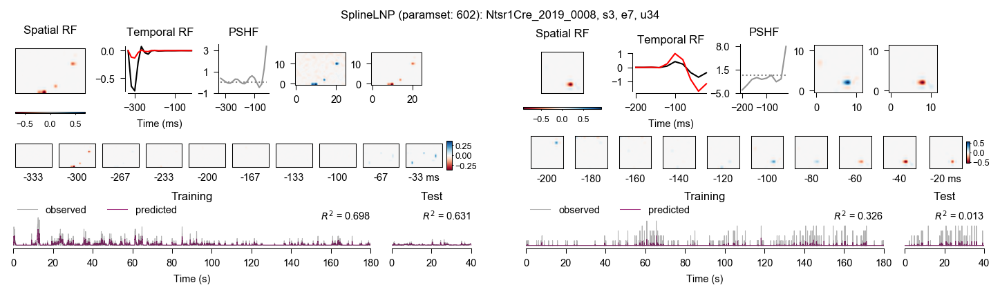

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 36, 'spl_paramset': 602}
hmov RF pos (x,y): [ 5 13]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 36, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 0]


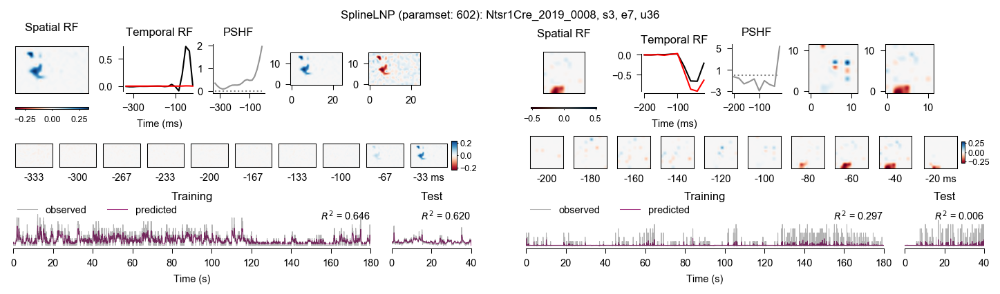

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 19, 'spl_paramset': 603}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 19, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 7]


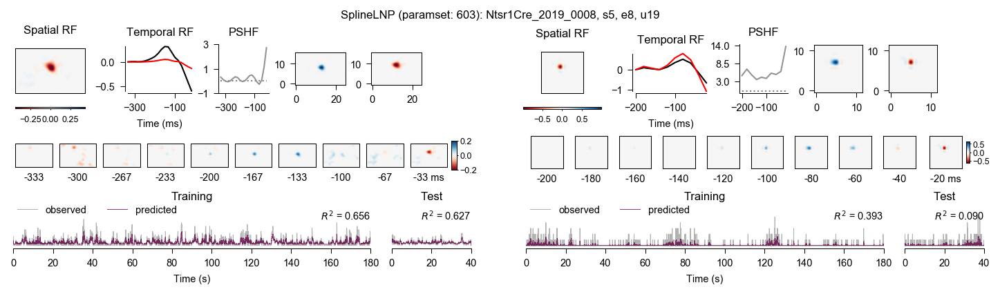

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 21, 'spl_paramset': 601}
hmov RF pos (x,y): [13  8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 21, 'spl_paramset': 4}
spnoise  RF pos (x,y): [4 9]


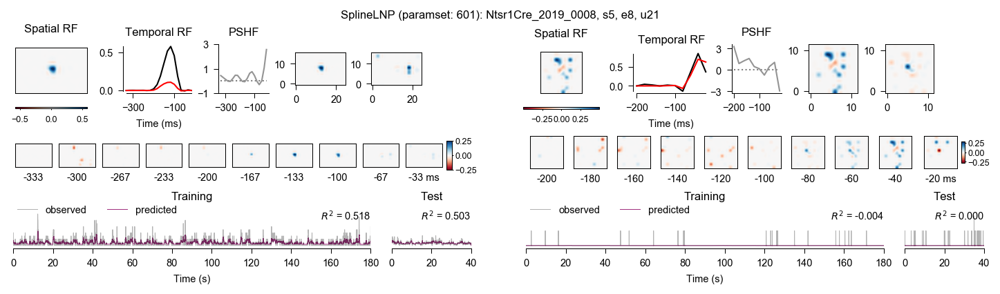

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 27, 'spl_paramset': 604}
hmov RF pos (x,y): [27 14]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 27, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 6]


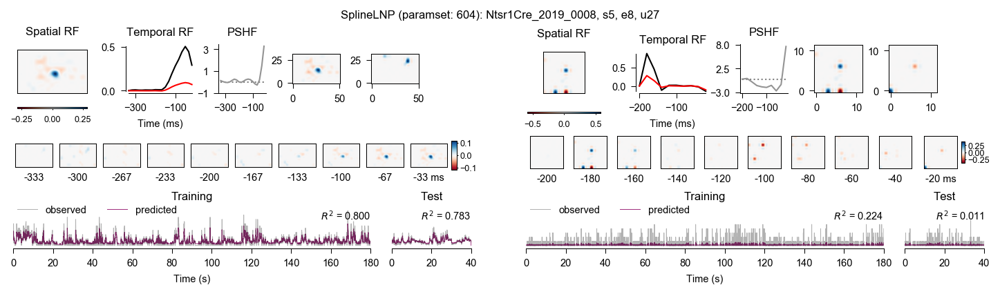

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 602}
hmov RF pos (x,y): [13  1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 48, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 1]


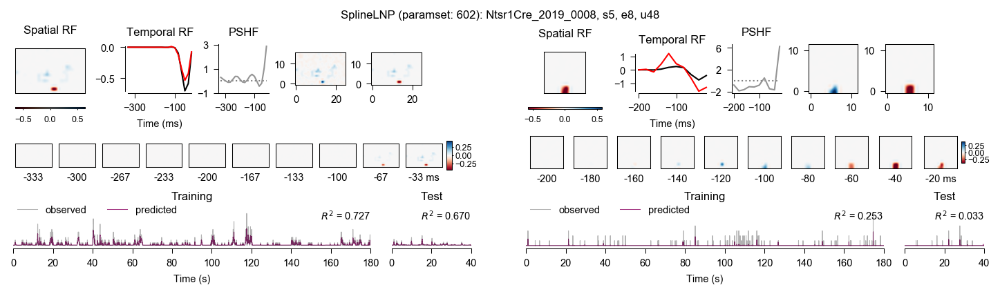

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 54, 'spl_paramset': 601}
hmov RF pos (x,y): [11  2]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 54, 'spl_paramset': 3}
spnoise  RF pos (x,y): [0 8]


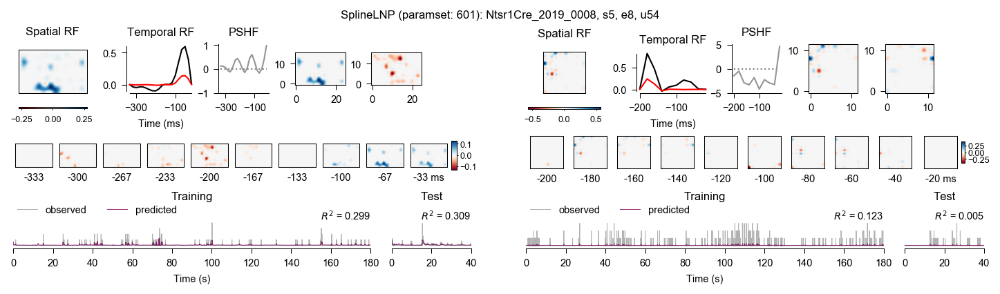

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 58, 'spl_paramset': 603}
hmov RF pos (x,y): [10  1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 58, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 8]


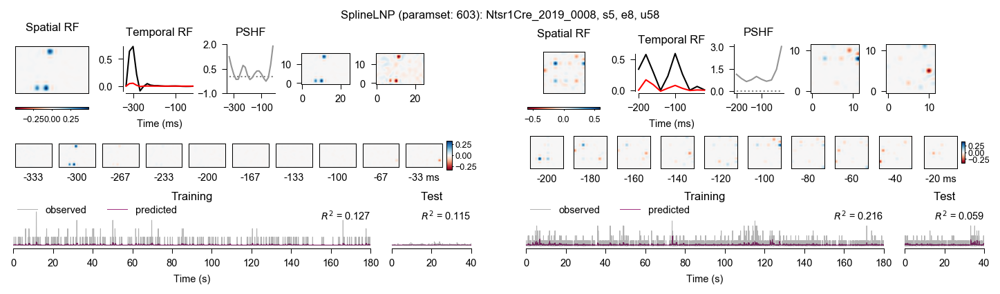

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 23, 'spl_paramset': 601}
hmov RF pos (x,y): [10 11]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 23, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  3]


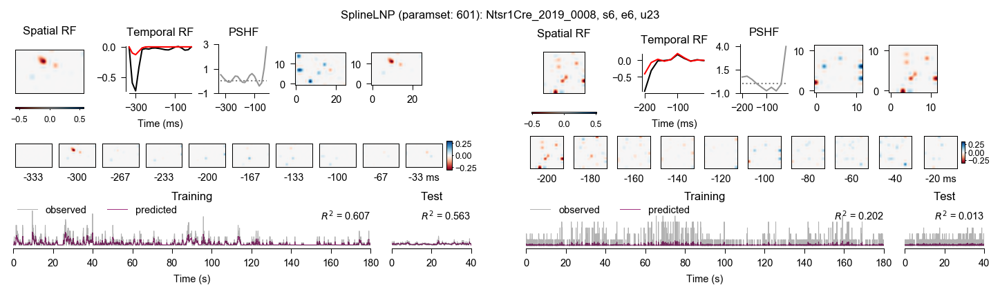

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 30, 'spl_paramset': 603}
hmov RF pos (x,y): [9 8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 30, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 6]


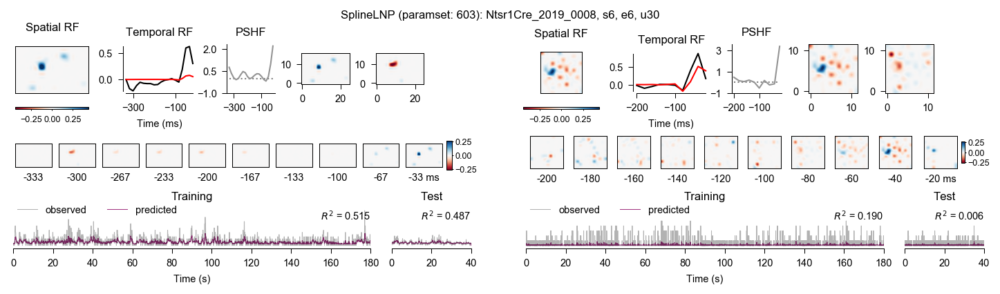

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 31, 'spl_paramset': 601}
hmov RF pos (x,y): [1 1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 31, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 0 11]


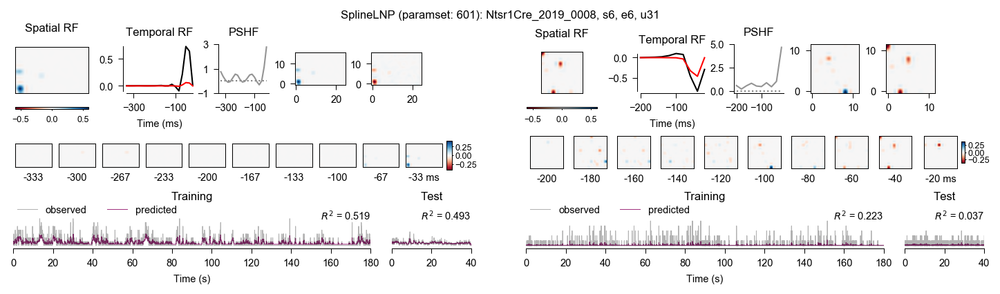

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 35, 'spl_paramset': 601}
hmov RF pos (x,y): [10  8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 35, 'spl_paramset': 1}
spnoise  RF pos (x,y): [0 5]


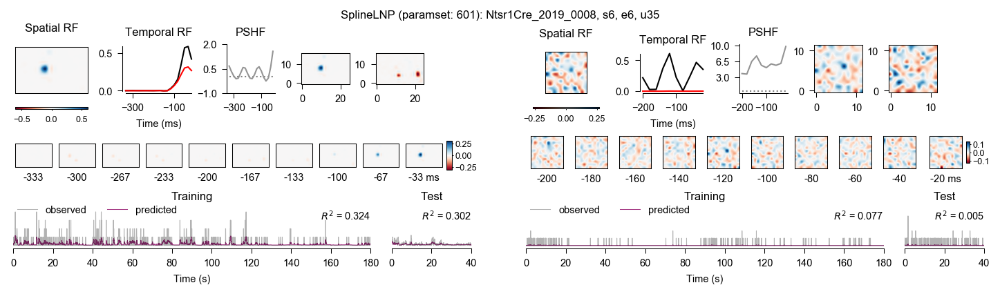

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 40, 'spl_paramset': 601}
hmov RF pos (x,y): [10  7]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 40, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 4]


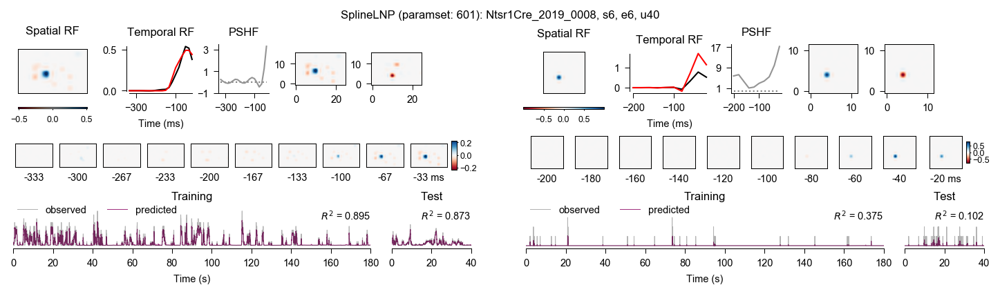

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 46, 'spl_paramset': 601}
hmov RF pos (x,y): [9 6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 46, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 4]


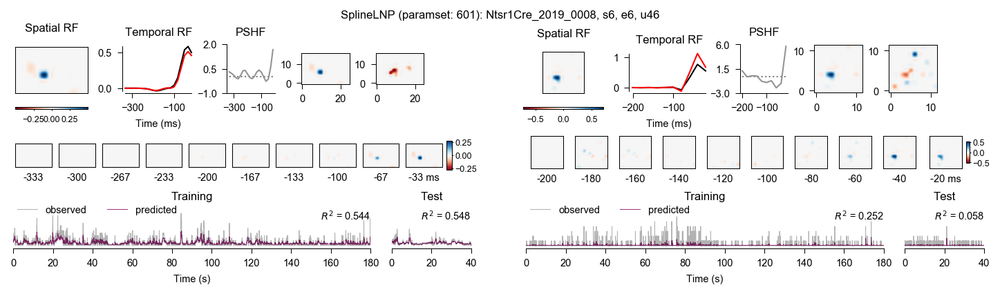

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 50, 'spl_paramset': 601}
hmov RF pos (x,y): [13  2]
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'u': 50}.


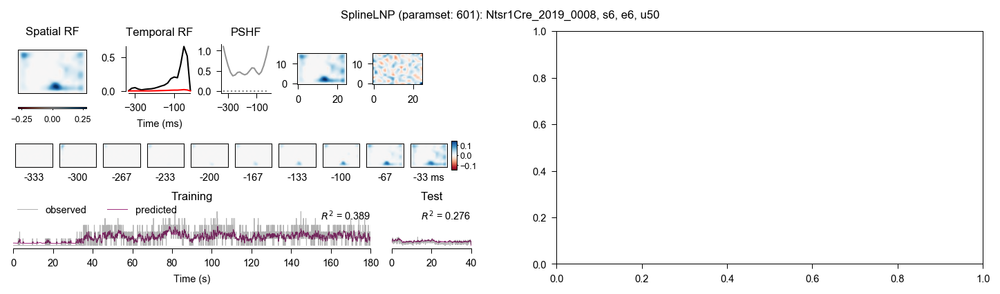

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 51, 'spl_paramset': 601}
hmov RF pos (x,y): [4 4]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 51, 'spl_paramset': 1}
spnoise  RF pos (x,y): [2 2]


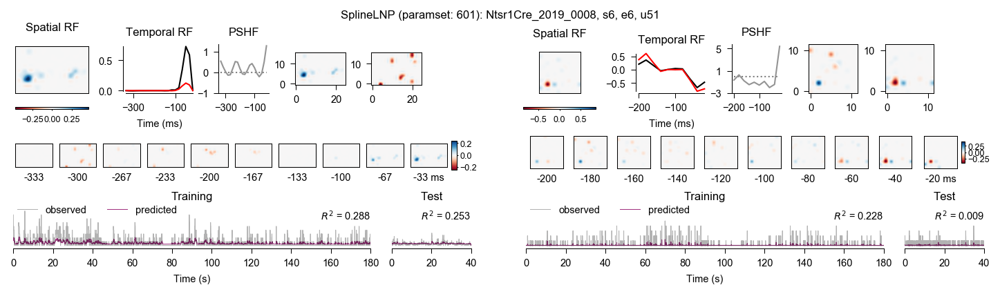

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 1, 'spl_paramset': 603}
hmov RF pos (x,y): [10  8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 1, 'spl_paramset': 1}
spnoise  RF pos (x,y): [10  7]


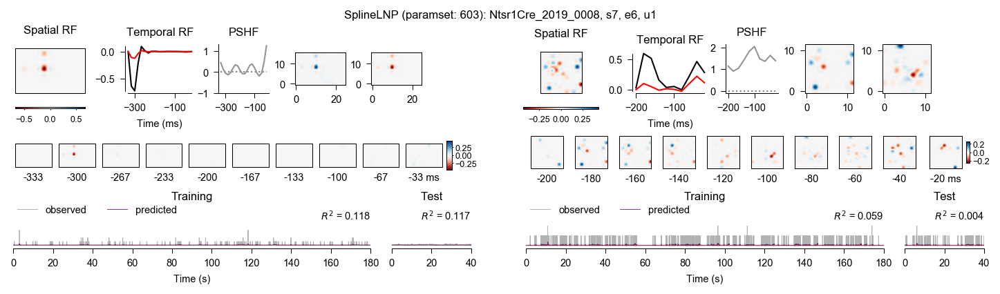

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 2, 'spl_paramset': 601}
hmov RF pos (x,y): [20  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 2, 'spl_paramset': 1}
spnoise  RF pos (x,y): [0 5]


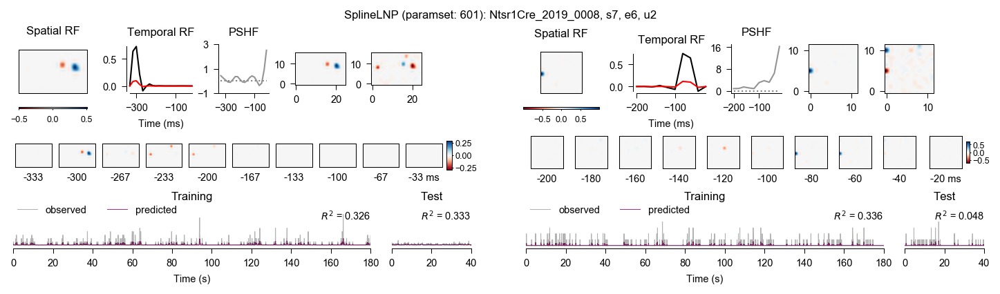

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 3, 'spl_paramset': 601}
hmov RF pos (x,y): [23  7]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 3, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  6]


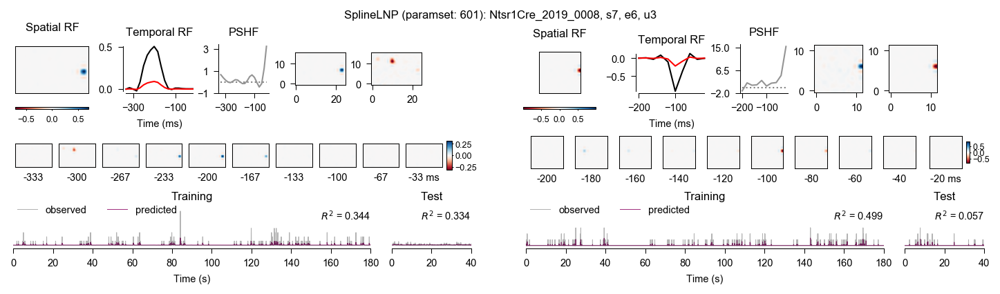

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 4, 'spl_paramset': 601}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 4, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 6 11]


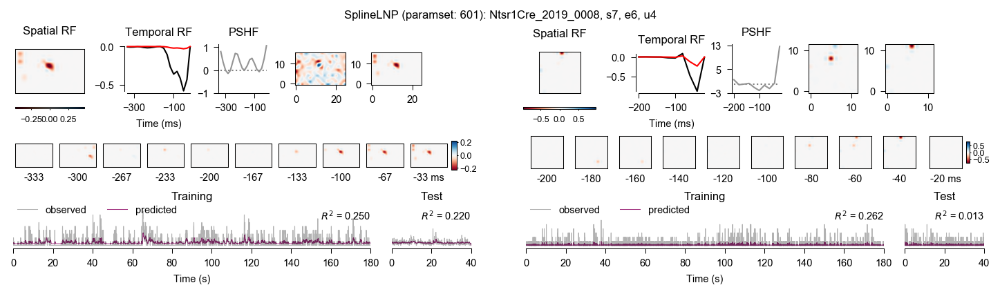

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 5, 'spl_paramset': 601}
hmov RF pos (x,y): [8 8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 5, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 8 11]


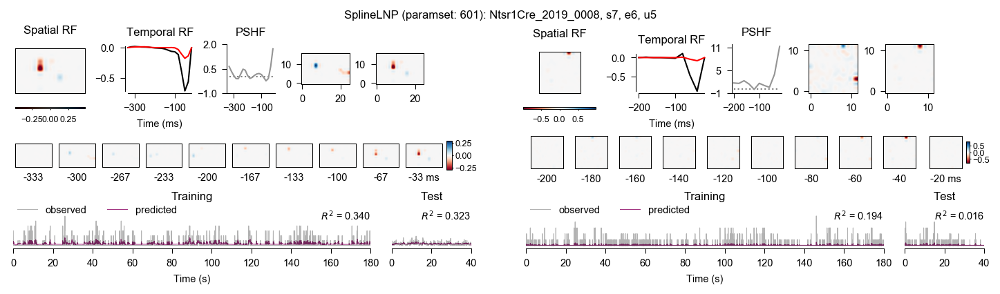

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 6, 'spl_paramset': 601}
hmov RF pos (x,y): [11  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 6, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 6]


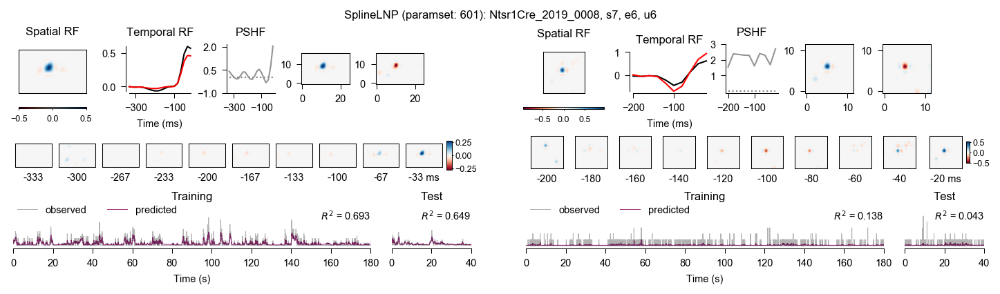

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 7, 'spl_paramset': 601}
hmov RF pos (x,y): [17  4]
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'u': 7}.


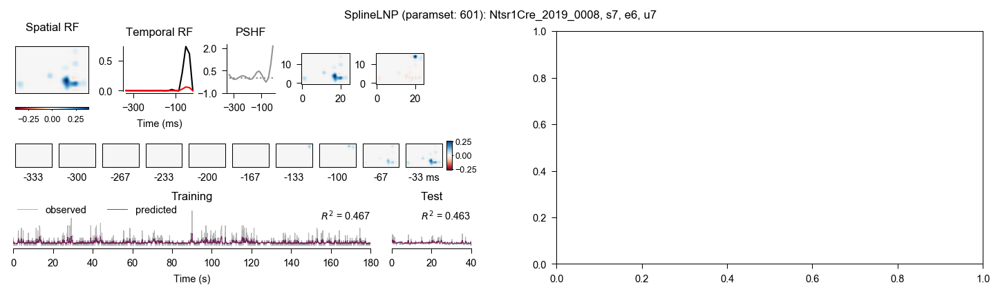

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 8, 'spl_paramset': 601}
hmov RF pos (x,y): [21  6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 8, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 4]


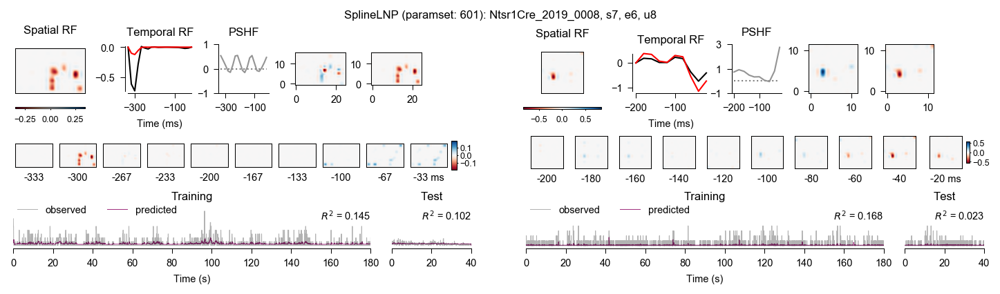

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 9, 'spl_paramset': 604}
hmov RF pos (x,y): [11  6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 9, 'spl_paramset': 3}
spnoise  RF pos (x,y): [10  9]


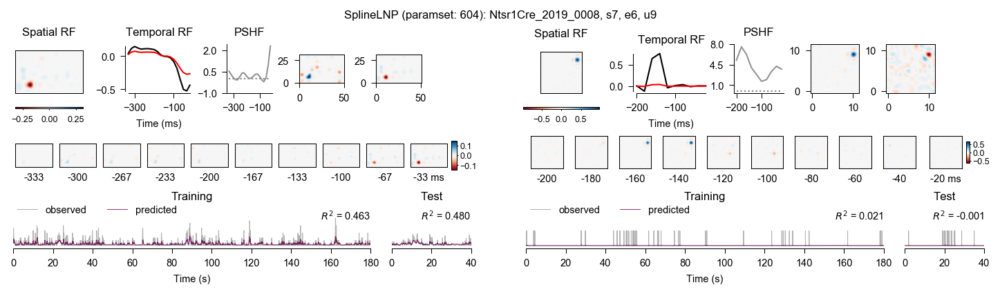

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 10, 'spl_paramset': 601}
hmov RF pos (x,y): [7 1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 10, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 5]


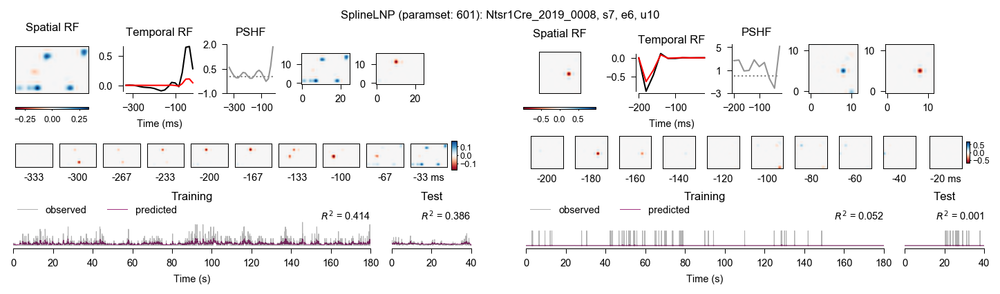

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 11, 'spl_paramset': 603}
hmov RF pos (x,y): [23 14]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 11, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  9]


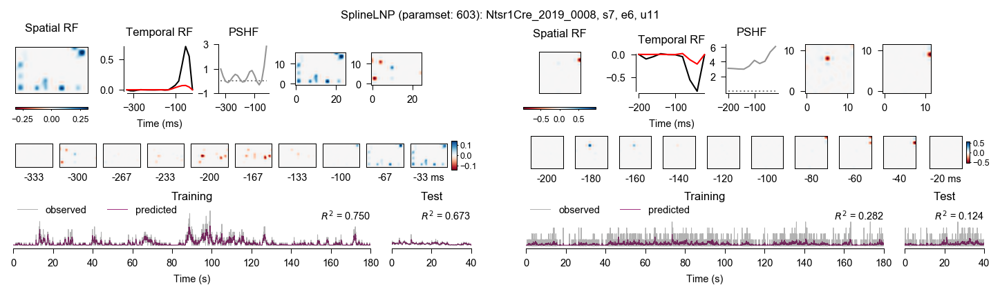

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 12, 'spl_paramset': 603}
hmov RF pos (x,y): [16  0]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 12, 'spl_paramset': 1}
spnoise  RF pos (x,y): [0 3]


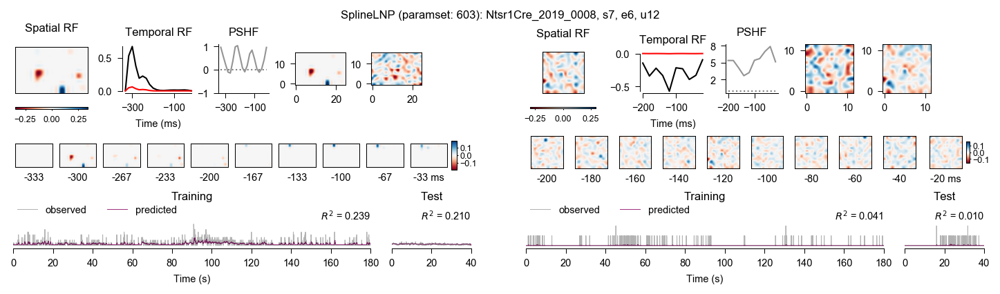

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 13, 'spl_paramset': 601}
hmov RF pos (x,y): [ 6 14]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 13, 'spl_paramset': 1}
spnoise  RF pos (x,y): [8 8]


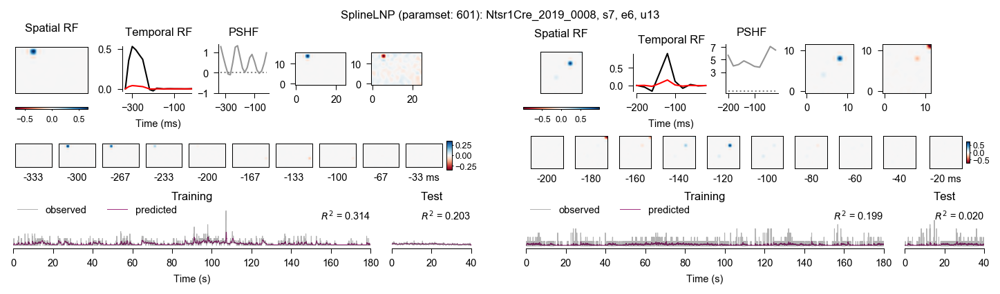

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 14, 'spl_paramset': 602}
hmov RF pos (x,y): [24  4]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 14, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 6]


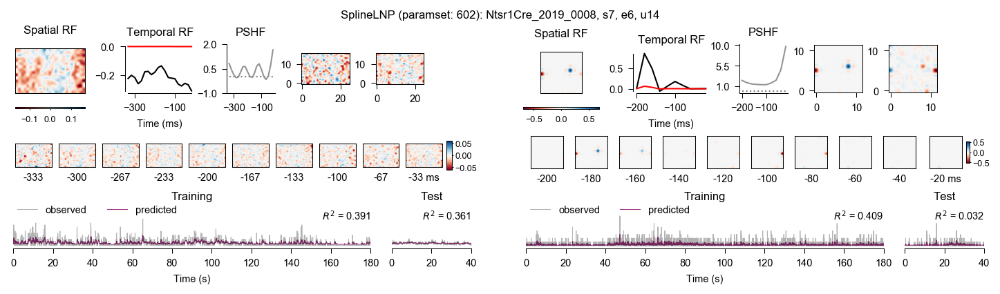

In [6]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((Unit.Properties() & HmovUnit() & SplineLNP() & {'m': 'Ntsr1Cre_2019_0008'}).fetch(dj.key, as_dict=True))

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=len(units)).iterrows():

    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # unit = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 19}
    unit = unit.to_dict()

    # Plot best hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov'}).fetch(dj.key)  # gets all hmov models for unit
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=True, gs=gs[0])
        print(f'hmov key: {key}')

        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'hmov RF pos (x,y): {rf_pos}')        

    # Plot best sparse noise model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise'}).fetch(dj.key)  # gets all spnoise models for unit
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'spnoise key: {key}')
        
        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'spnoise  RF pos (x,y): {rf_pos}')

    plt.show()

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 5, 'spl_paramset': 603}
hmov RF pos (x,y): [13 10]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 5, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 7]


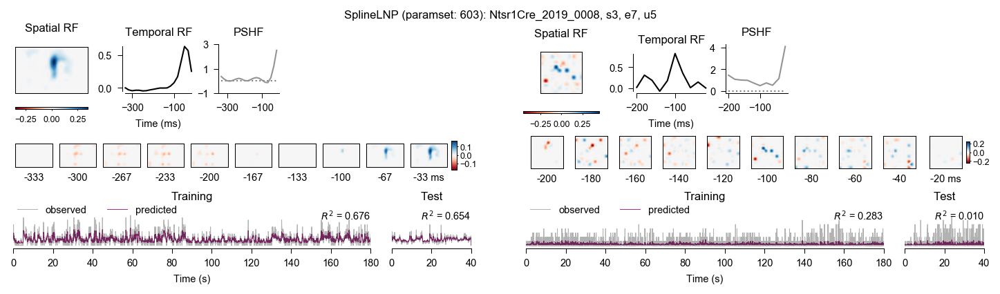

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 6, 'spl_paramset': 604}
hmov RF pos (x,y): [22 17]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 6, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 9]


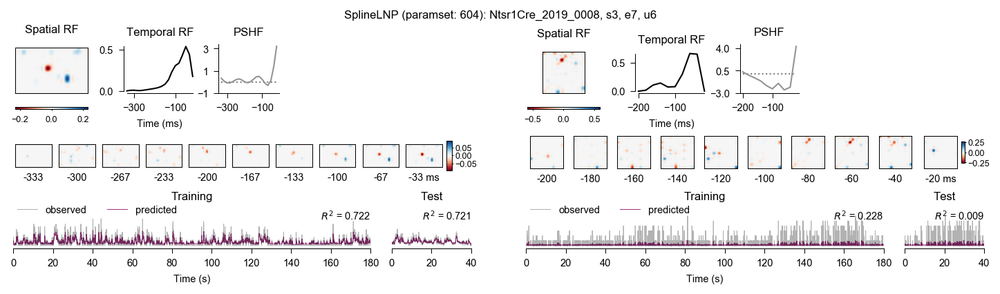

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'u': 11}.
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 11, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 8]


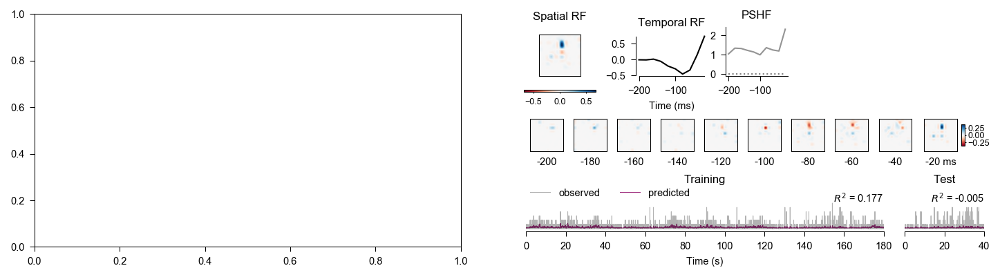

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 14, 'spl_paramset': 601}
hmov RF pos (x,y): [13  7]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 14, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 6]


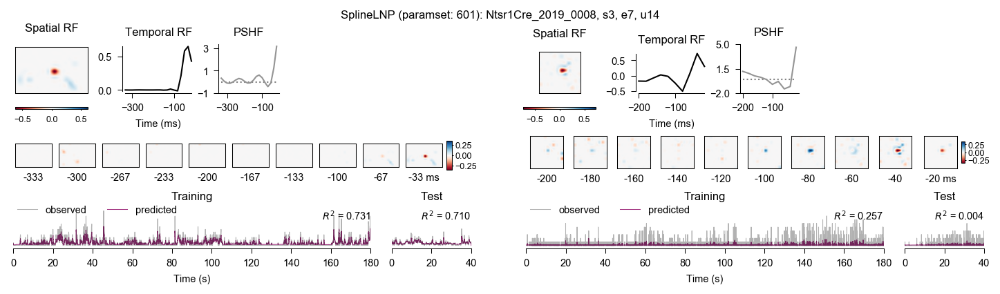

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 17, 'spl_paramset': 603}
hmov RF pos (x,y): [13  5]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 17, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 0 11]


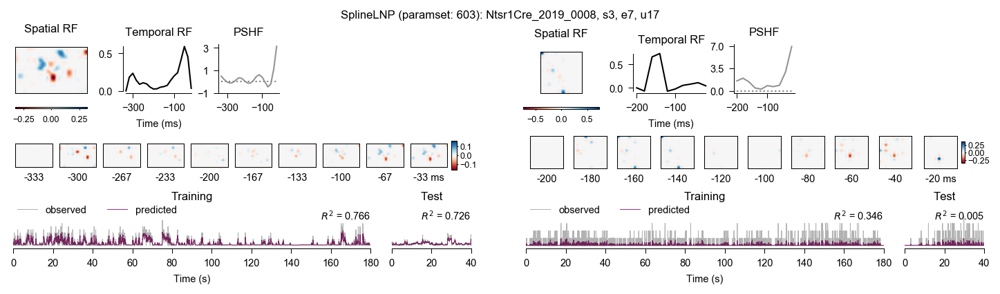

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 18, 'spl_paramset': 602}
hmov RF pos (x,y): [13  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 18, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 7]


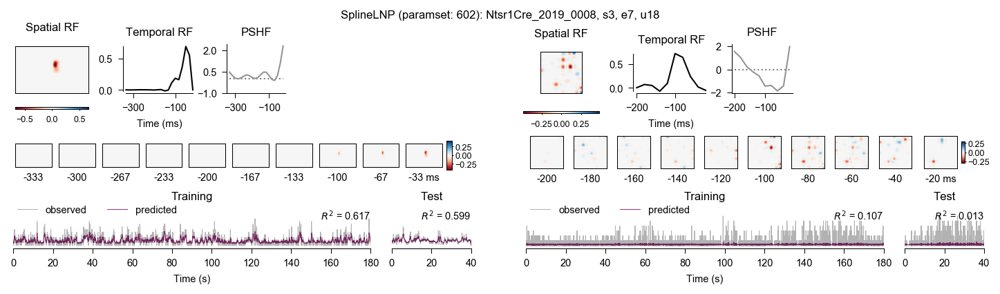

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 20, 'spl_paramset': 601}
hmov RF pos (x,y): [14  6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 20, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 4]


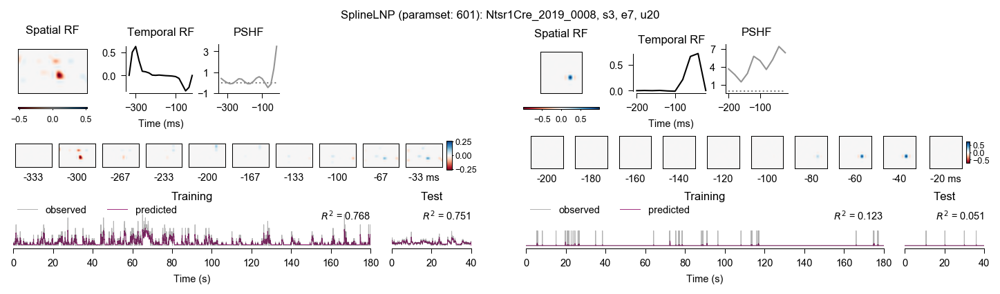

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 22, 'spl_paramset': 602}
hmov RF pos (x,y): [13 10]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 22, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  6]


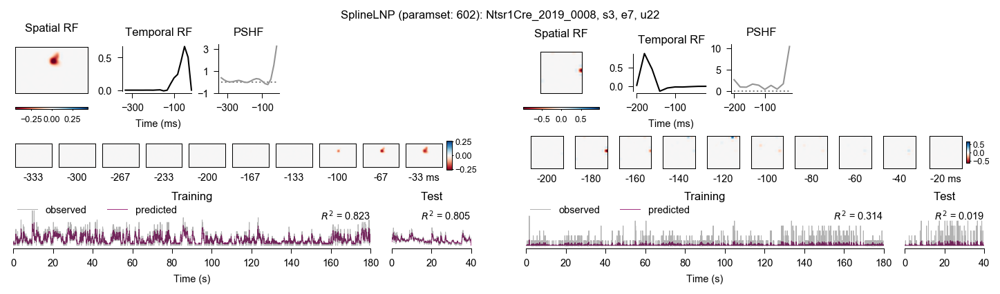

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 25, 'spl_paramset': 602}
hmov RF pos (x,y): [12 11]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 25, 'spl_paramset': 4}
spnoise  RF pos (x,y): [5 3]


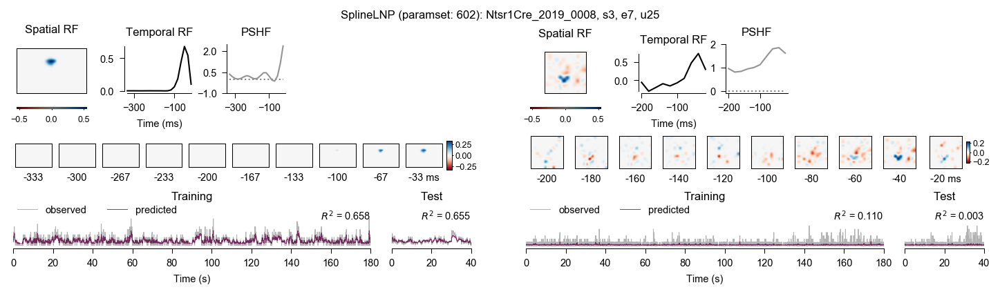

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'u': 26}.
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 26, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 4]


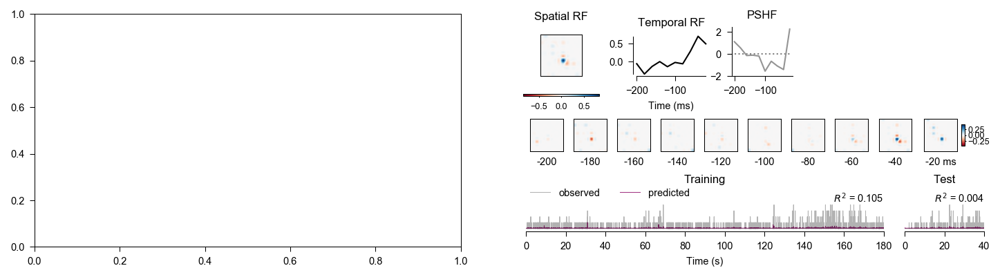

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 30, 'spl_paramset': 602}
hmov RF pos (x,y): [ 8 10]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 30, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 3]


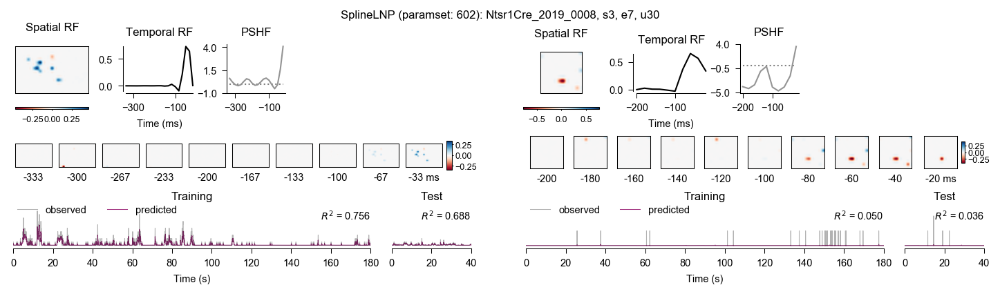

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 34, 'spl_paramset': 602}
hmov RF pos (x,y): [10  0]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 34, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 2]


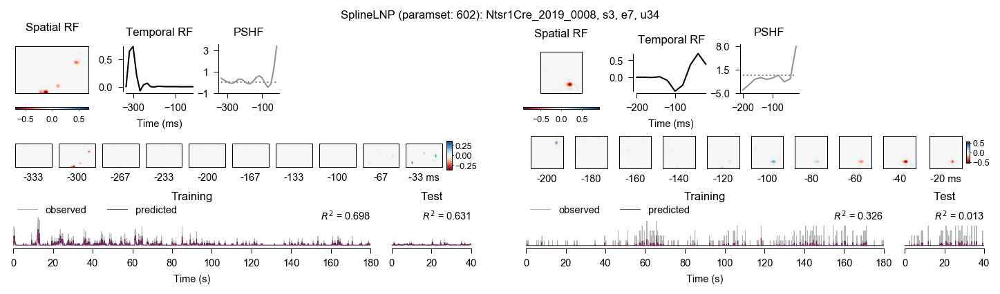

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 36, 'spl_paramset': 602}
hmov RF pos (x,y): [ 5 13]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 36, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 0]


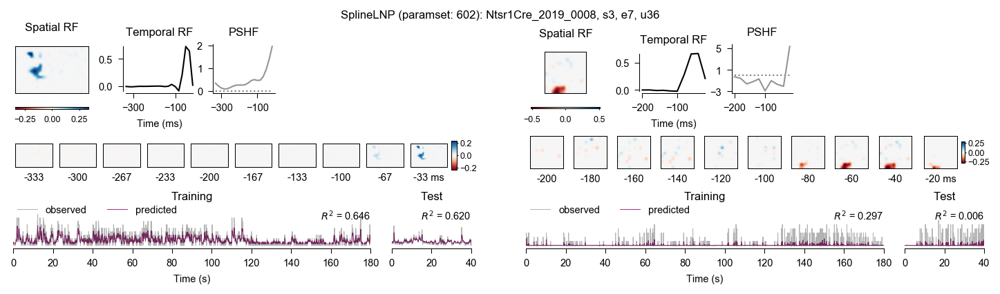

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 19, 'spl_paramset': 603}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 19, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 7]


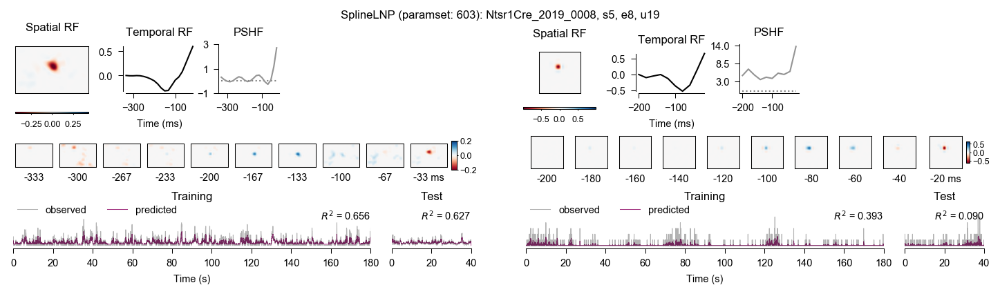

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 21, 'spl_paramset': 601}
hmov RF pos (x,y): [13  8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 21, 'spl_paramset': 4}
spnoise  RF pos (x,y): [4 9]


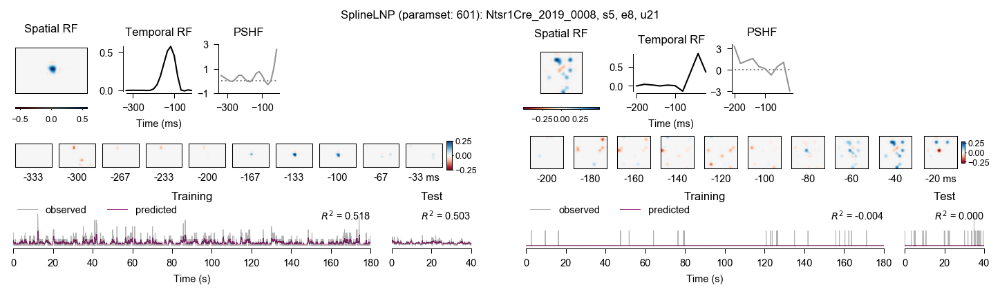

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 27, 'spl_paramset': 604}
hmov RF pos (x,y): [27 14]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 27, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 6]


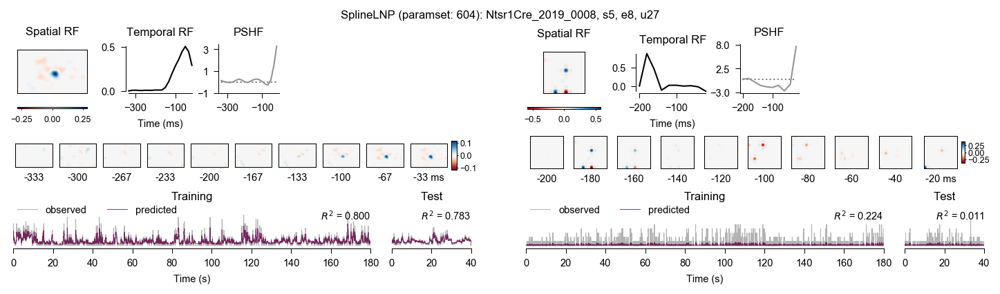

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 602}
hmov RF pos (x,y): [13  1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 48, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 1]


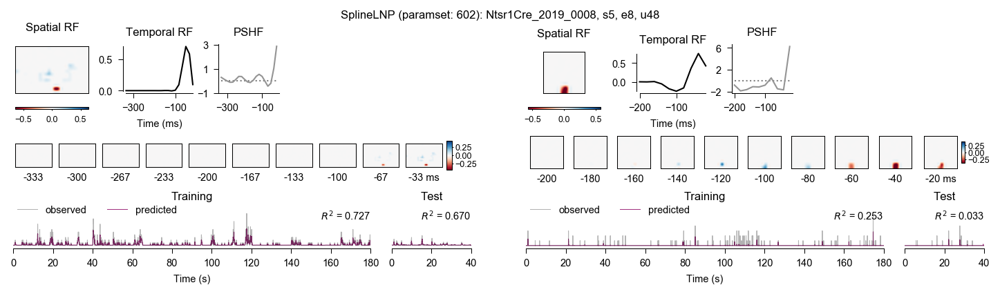

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 54, 'spl_paramset': 601}
hmov RF pos (x,y): [11  2]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 54, 'spl_paramset': 3}
spnoise  RF pos (x,y): [0 8]


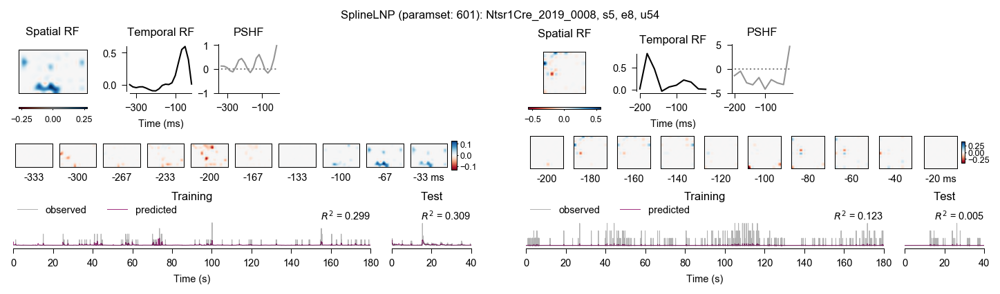

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 58, 'spl_paramset': 603}
hmov RF pos (x,y): [10  1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 58, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 8]


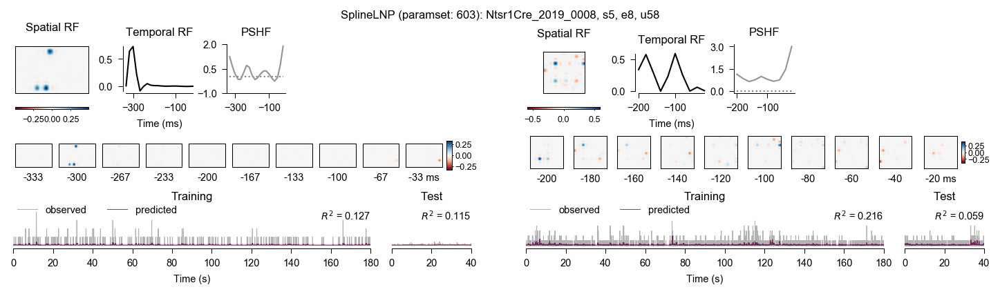

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 23, 'spl_paramset': 601}
hmov RF pos (x,y): [10 11]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 23, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  3]


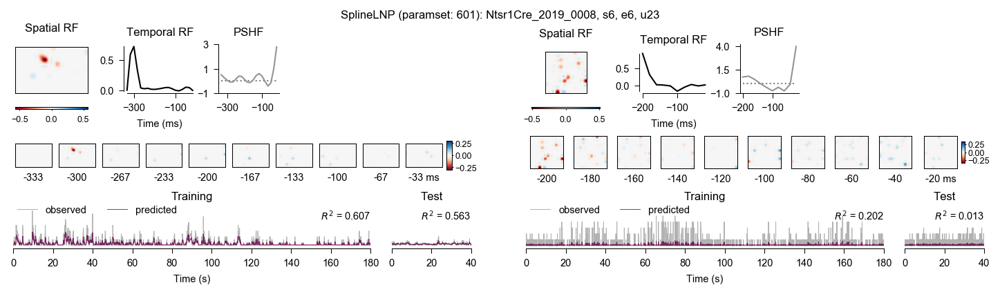

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 30, 'spl_paramset': 603}
hmov RF pos (x,y): [9 8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 30, 'spl_paramset': 1}
spnoise  RF pos (x,y): [3 6]


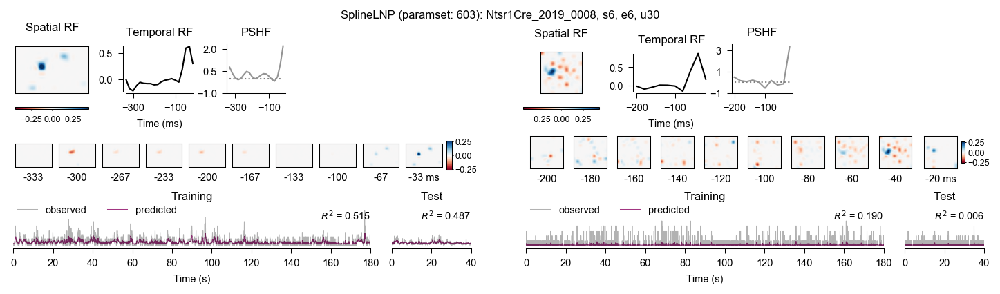

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 31, 'spl_paramset': 601}
hmov RF pos (x,y): [1 1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 31, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 0 11]


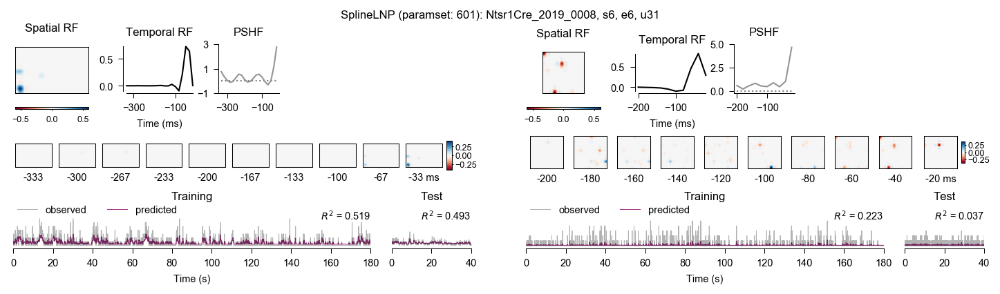

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 35, 'spl_paramset': 601}
hmov RF pos (x,y): [10  8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 35, 'spl_paramset': 1}
spnoise  RF pos (x,y): [0 5]


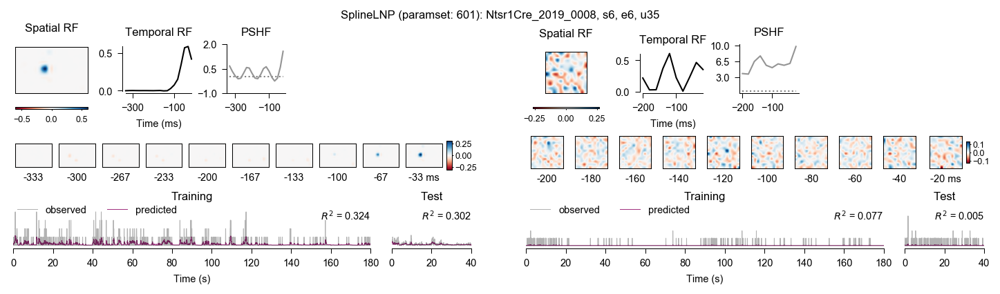

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 40, 'spl_paramset': 601}
hmov RF pos (x,y): [10  7]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 40, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 4]


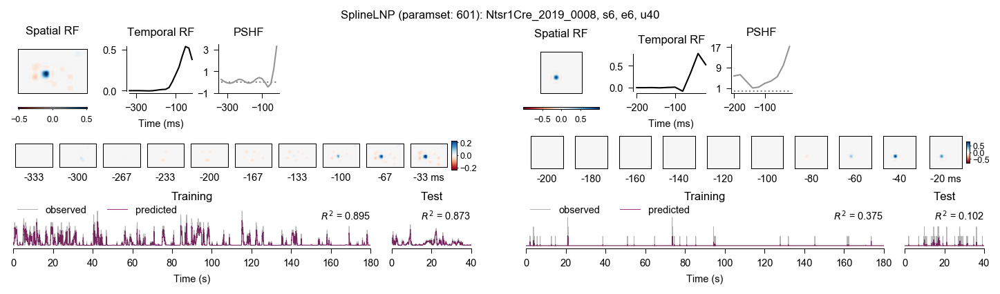

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 46, 'spl_paramset': 601}
hmov RF pos (x,y): [9 6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 46, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 4]


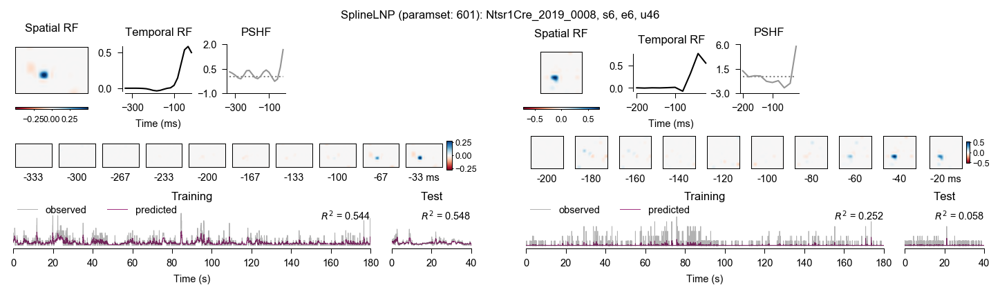

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 50, 'spl_paramset': 601}
hmov RF pos (x,y): [13  2]
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'u': 50}.


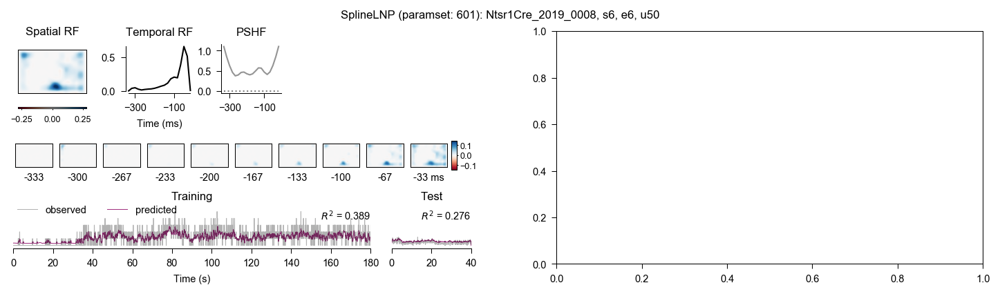

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 51, 'spl_paramset': 601}
hmov RF pos (x,y): [4 4]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 51, 'spl_paramset': 1}
spnoise  RF pos (x,y): [2 2]


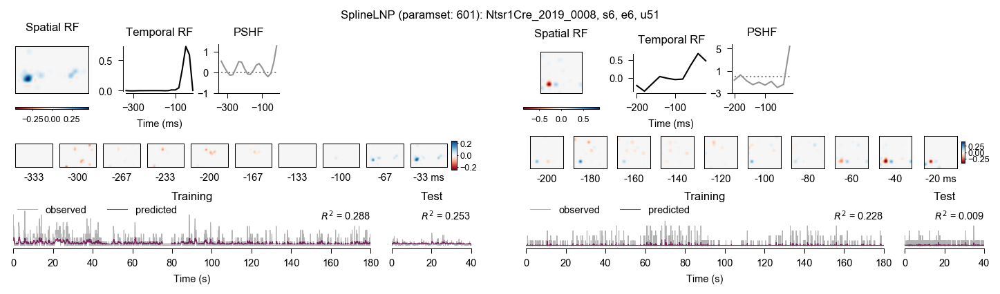

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 1, 'spl_paramset': 603}
hmov RF pos (x,y): [10  8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 1, 'spl_paramset': 1}
spnoise  RF pos (x,y): [10  7]


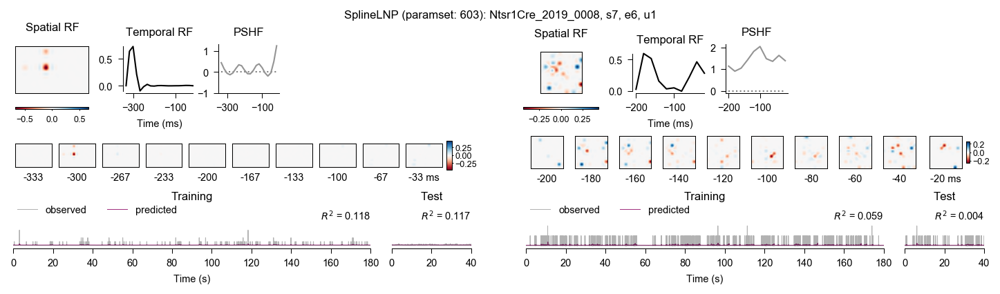

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 2, 'spl_paramset': 601}
hmov RF pos (x,y): [20  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 2, 'spl_paramset': 1}
spnoise  RF pos (x,y): [0 5]


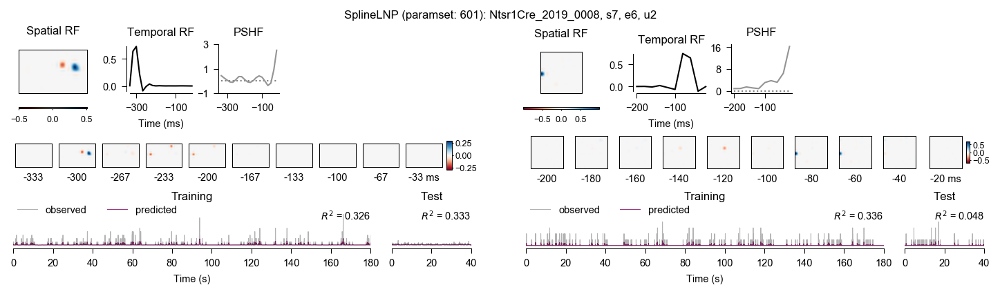

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 3, 'spl_paramset': 601}
hmov RF pos (x,y): [23  7]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 3, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  6]


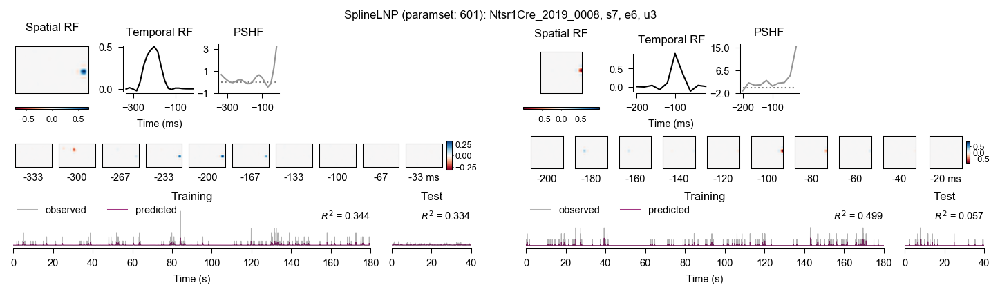

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 4, 'spl_paramset': 601}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 4, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 6 11]


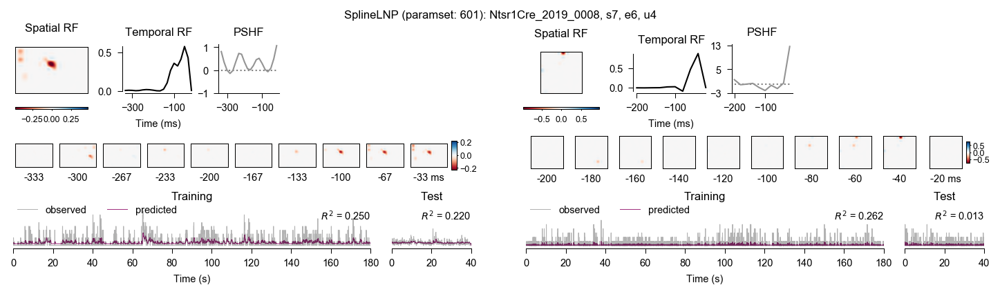

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 5, 'spl_paramset': 601}
hmov RF pos (x,y): [8 8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 5, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 8 11]


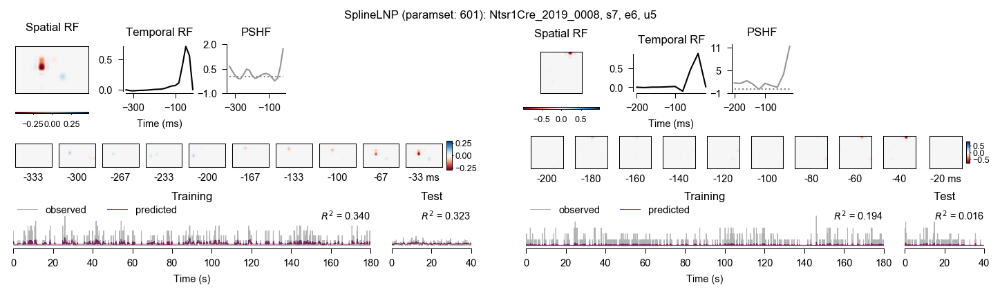

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 6, 'spl_paramset': 601}
hmov RF pos (x,y): [11  9]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 6, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 6]


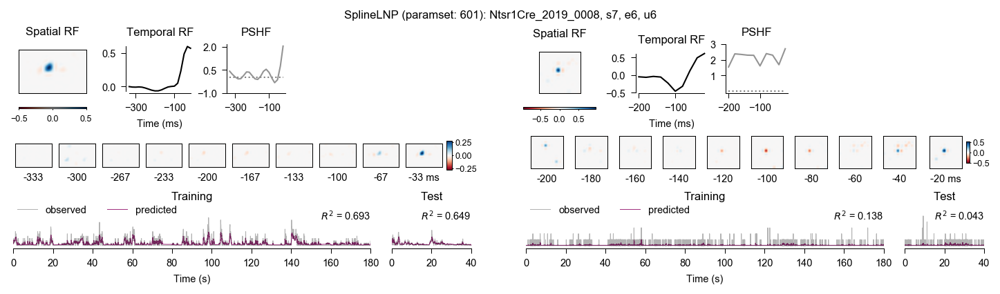

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 7, 'spl_paramset': 601}
hmov RF pos (x,y): [17  4]
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'u': 7}.


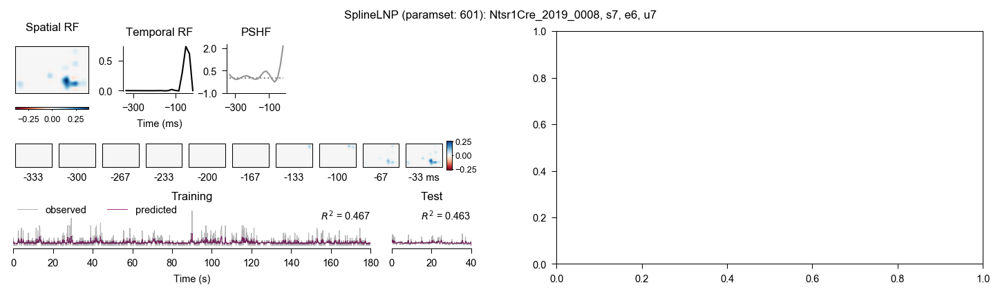

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 8, 'spl_paramset': 601}
hmov RF pos (x,y): [21  6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 8, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 4]


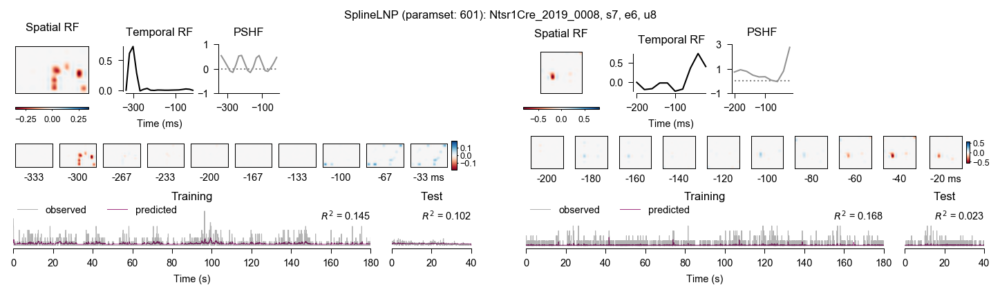

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 9, 'spl_paramset': 604}
hmov RF pos (x,y): [11  6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 9, 'spl_paramset': 3}
spnoise  RF pos (x,y): [10  9]


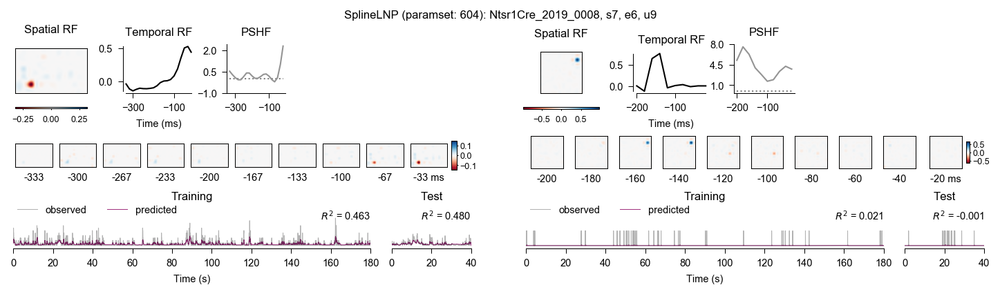

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 10, 'spl_paramset': 601}
hmov RF pos (x,y): [7 1]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 10, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 5]


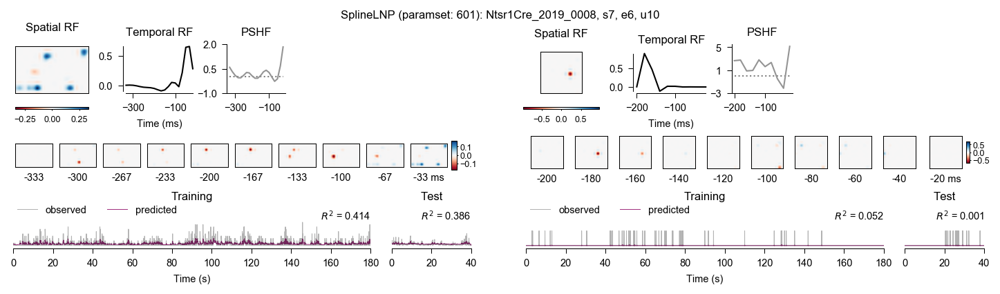

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 11, 'spl_paramset': 603}
hmov RF pos (x,y): [23 14]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 11, 'spl_paramset': 3}
spnoise  RF pos (x,y): [11  9]


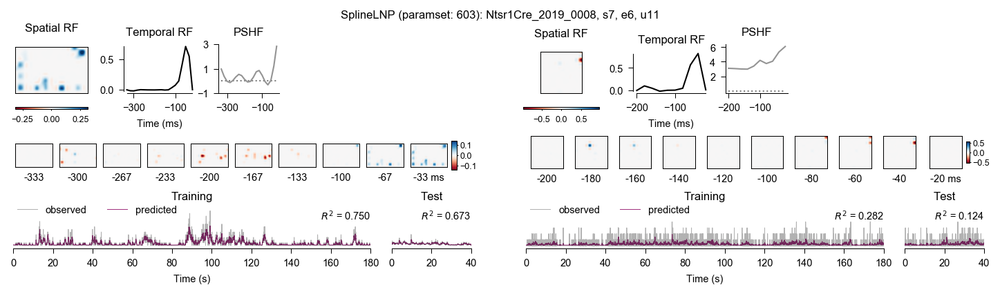

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 12, 'spl_paramset': 603}
hmov RF pos (x,y): [16  0]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 12, 'spl_paramset': 1}
spnoise  RF pos (x,y): [0 3]


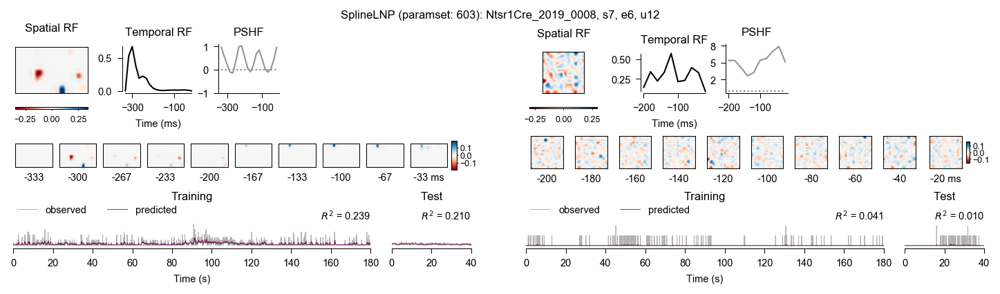

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 13, 'spl_paramset': 601}
hmov RF pos (x,y): [ 6 14]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 13, 'spl_paramset': 1}
spnoise  RF pos (x,y): [8 8]


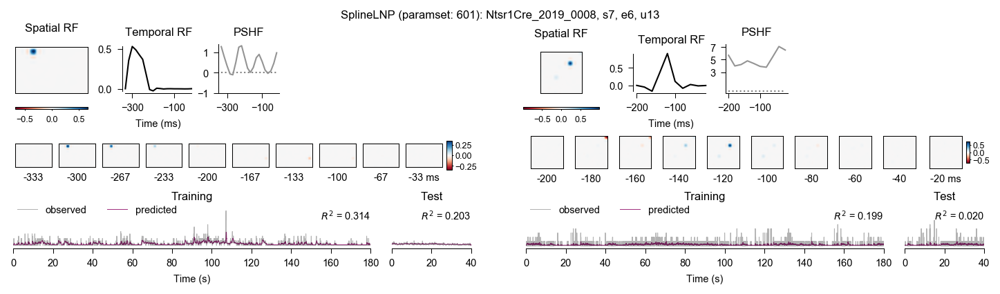

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 14, 'spl_paramset': 602}
hmov RF pos (x,y): [24  4]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 14, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 6]


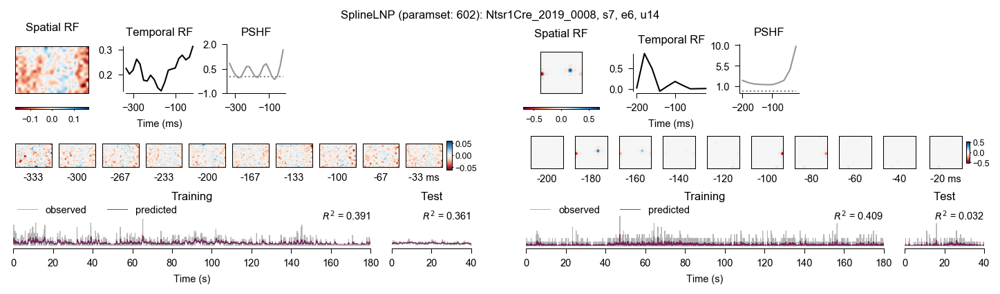

In [4]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((Unit.Properties() & HmovUnit() & SplineLNP() & {'m': 'Ntsr1Cre_2019_0008'}).fetch(dj.key, as_dict=True))

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=len(units)).iterrows():

    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # unit = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 19}
    unit = unit.to_dict()

    # Plot best hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov'}).fetch(dj.key)  # gets all hmov models for unit
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=True, gs=gs[0])
        print(f'hmov key: {key}')

        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'hmov RF pos (x,y): {rf_pos}')        

    # Plot best sparse noise model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise'}).fetch(dj.key)  # gets all spnoise models for unit
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
        key = get_best_model(key, crit='spl_r_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'spnoise key: {key}')
        
        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'spnoise  RF pos (x,y): {rf_pos}')

    plt.show()

## Check effect of double resolution (32x51) images vs old 16x25 images on model performance

In [7]:
SplineLNPParams & {'spl_paramset': 604}  # high-res

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
604,hmov,softplus,1.0,1.4,0.2,1000,12,12,True,20,10,200,corrcoef,False,20,1,0.12,60.0,False,0,0,False,0,0,False,0,0,True


In [8]:
SplineLNPParams & {'spl_paramset': 601}  # equivalent low-res

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
603,hmov,softplus,1.0,1.0,0.2,1000,12,12,True,20,10,200,corrcoef,False,20,1,0.06,60.0,False,0,0,False,0,0,False,0,0,True


In [4]:
df = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 604 OR spl_paramset = 601').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
df

,m,s,e,u,paramset,stim,r_test,rf_qi,rf_area
0,Ntsr1Cre_2019_0007,6,9,1,601,hmov,0.911217,2.579130e-01,0.25
1,Ntsr1Cre_2019_0007,6,9,1,604,hmov,0.907523,6.237740e-01,0.74
2,Ntsr1Cre_2019_0007,6,9,2,601,hmov,0.862299,9.251950e-02,0.25
3,Ntsr1Cre_2019_0007,6,9,2,604,hmov,0.858156,4.285260e-10,0.06
4,Ntsr1Cre_2019_0007,6,9,3,601,hmov,0.852358,4.245900e-01,0.75
...,...,...,...,...,...,...,...,...,...
507,Ntsr1Cre_2020_0004,6,10,66,604,hmov,0.832561,9.503480e-02,0.25
508,Ntsr1Cre_2020_0004,6,10,68,601,hmov,0.748764,1.402850e-01,0.50
509,Ntsr1Cre_2020_0004,6,10,68,604,hmov,0.748350,8.647950e-01,2.51
510,Ntsr1Cre_2020_0004,6,10,70,601,hmov,0.652966,7.844740e-01,1.00


In [5]:
df[['paramset', 'r_test', 'rf_qi', 'rf_area']].groupby('paramset').describe()

r_test                                                                        rf_qi            ...                     rf_area                                                  
          count      mean       std       min       25%       50%       75%       max  count      mean  ...       75%       max   count      mean       std  min   25%   50%   75%    max
paramset                                                                                                ...                                                                              
601       256.0  0.823477  0.176573 -0.441323  0.778601  0.870344  0.926198  0.975571  256.0  0.583141  ...  0.941513  0.982334   256.0  2.042969  2.061579  0.0  0.50  1.50  3.00  14.00
604       256.0  0.813926  0.171856 -0.323196  0.771811  0.862345  0.915210  0.973540  256.0  0.507101  ...  0.832285  0.965690   256.0  1.559297  1.724381  0.0  0.37  0.92  2.33  15.87

[2 rows x 24 columns]

            r_test                     rf_qi                   rf_area                
              mean       std count      mean       std count      mean       std count
paramset                                                                              
601       0.823477  0.176573   256  0.583141  0.353567   256  2.042969  2.061579   256
604       0.813926  0.171856   256  0.507101  0.321466   256  1.559297  1.724381   256


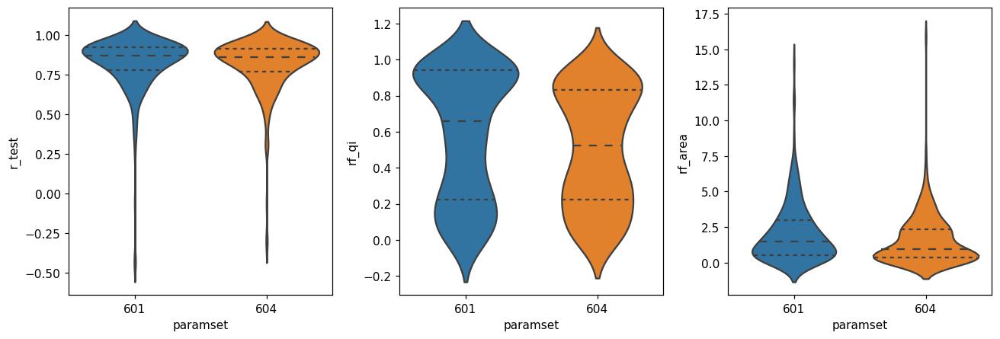

In [6]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=cm2inch((30,10)), dpi=110, constrained_layout=True)

sns.violinplot(data=df, x='paramset', y='r_test', inner='quartile', ax=axs[0])
# sns.swarmplot(data=df, x='paramset', y='r_test', color='white', edgecolor='gray', alpha=0.5, size=3.5, ax=axs)
# sns.kdeplot(data=df, y='paramset', hue='r_test', ax=axs)
sns.violinplot(data=df, x='paramset', y='rf_qi', inner='quartile', ax=axs[1])
sns.violinplot(data=df, x='paramset', y='rf_area', inner='quartile', ax=axs[2])

print(df[['paramset', 'r_test', 'rf_qi', 'rf_area']].groupby('paramset').agg(['mean', 'std', 'count']))

In [7]:
df[['paramset', 'r_test', 'rf_qi', 'rf_area']].groupby('paramset').describe().T

paramset                601           604
r_test  count  2.560000e+02  2.560000e+02
        mean   8.234771e-01  8.139264e-01
        std    1.765731e-01  1.718557e-01
        min   -4.413230e-01 -3.231960e-01
        25%    7.786013e-01  7.718108e-01
        50%    8.703440e-01  8.623455e-01
        75%    9.261983e-01  9.152098e-01
        max    9.755710e-01  9.735400e-01
rf_qi   count  2.560000e+02  2.560000e+02
        mean   5.831407e-01  5.071013e-01
        std    3.535668e-01  3.214656e-01
        min    2.167900e-10  4.285260e-10
        25%    2.220755e-01  2.237908e-01
        50%    6.583195e-01  5.242455e-01
        75%    9.415127e-01  8.322850e-01
        max    9.823340e-01  9.656900e-01
rf_area count  2.560000e+02  2.560000e+02
        mean   2.042969e+00  1.559297e+00
        std    2.061579e+00  1.724381e+00
        min    0.000000e+00  0.000000e+00
        25%    5.000000e-01  3.700000e-01
        50%    1.500000e+00  9.200000e-01
        75%    3.000000e+00  2.330000e+00
        max    1.400000e+01  1.587000e+01

### Test stats
Use paired data for better comparison

In [8]:
df1 = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 603').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df1.columns = df1.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)

df2 = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 604').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df2.columns = df2.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)

df = df1.merge(df2, on=['m','s','e','u'], how='inner')
df

,m,s,e,u,paramset_x,stim_x,r_test_x,rf_qi_x,rf_area_x,paramset_y,stim_y,r_test_y,rf_qi_y,rf_area_y
0,Ntsr1Cre_2019_0007,6,9,1,603,hmov,0.911332,0.564455,0.50,604,hmov,0.907523,6.237740e-01,0.74
1,Ntsr1Cre_2019_0007,6,9,2,603,hmov,0.860125,0.816781,1.50,604,hmov,0.858156,4.285260e-10,0.06
2,Ntsr1Cre_2019_0007,6,9,3,603,hmov,0.870217,0.359450,0.75,604,hmov,0.817484,3.406280e-01,0.43
3,Ntsr1Cre_2019_0007,6,9,4,603,hmov,0.742330,0.087687,0.25,604,hmov,0.685686,1.668600e-01,0.25
4,Ntsr1Cre_2019_0007,6,9,5,603,hmov,0.481087,0.677283,0.00,604,hmov,0.512705,3.045380e-01,0.37
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251,Ntsr1Cre_2020_0004,6,10,58,603,hmov,0.974299,0.043028,0.25,604,hmov,0.973540,5.144930e-10,0.06
252,Ntsr1Cre_2020_0004,6,10,61,603,hmov,0.754139,0.217585,0.50,604,hmov,0.751183,3.597510e-01,0.55
253,Ntsr1Cre_2020_0004,6,10,66,603,hmov,0.828472,0.115619,0.25,604,hmov,0.832561,9.503480e-02,0.25
254,Ntsr1Cre_2020_0004,6,10,68,603,hmov,0.748659,0.171824,0.25,604,hmov,0.748350,8.647950e-01,2.51


In [9]:
df.iloc[:, 4::].describe()

,paramset_x,r_test_x,rf_qi_x,rf_area_x,paramset_y,r_test_y,rf_qi_y,rf_area_y
count,256.0,256.000000,2.560000e+02,256.000000,256.0,256.000000,2.560000e+02,256.000000
mean,603.0,0.823915,5.390263e-01,2.031250,604.0,0.813926,5.071013e-01,1.559297
std,0.0,0.160975,3.388487e-01,2.317664,0.0,0.171856,3.214656e-01,1.724381
min,603.0,-0.407958,2.156830e-10,0.000000,604.0,-0.323196,4.285260e-10,0.000000
25%,603.0,0.775069,1.853555e-01,0.500000,604.0,0.771811,2.237908e-01,0.370000
50%,603.0,0.870023,5.904680e-01,1.250000,604.0,0.862345,5.242455e-01,0.920000
75%,603.0,0.923051,8.840920e-01,2.812500,604.0,0.915210,8.322850e-01,2.330000
max,603.0,0.974299,9.851970e-01,19.750000,604.0,0.973540,9.656900e-01,15.870000


ShapiroResult(statistic=0.7225291132926941, pvalue=2.2372765336831677e-20)
ShapiroResult(statistic=0.7045320868492126, pvalue=5.688424541195921e-21)
ShapiroResult(statistic=0.8941996693611145, pvalue=2.102093022218754e-12)
ShapiroResult(statistic=0.9104687571525574, pvalue=3.0508581772004106e-11)
ShapiroResult(statistic=0.7308117747306824, pvalue=4.297604270939611e-20)
ShapiroResult(statistic=0.758022665977478, pvalue=4.1036326791179134e-19)


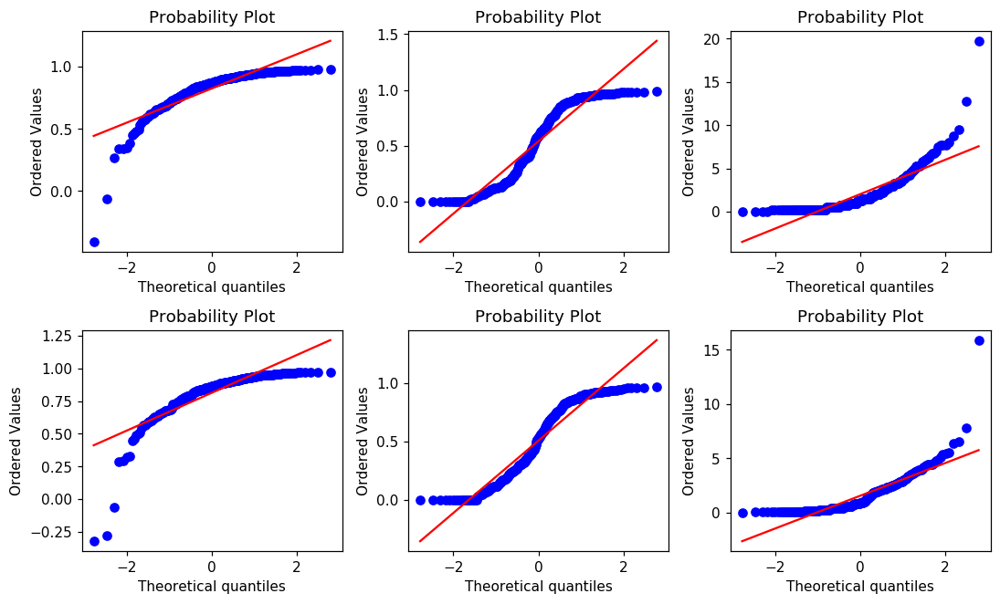

In [10]:
# Test for normality of model test performace
fig, axs = plt.subplots(nrows=2, ncols=3, figsize=cm2inch((25,15)), dpi=110, constrained_layout=True)

stats.probplot(df['r_test_x'], dist="norm", plot=axs[0,0]);
stats.probplot(df['r_test_y'], dist="norm", plot=axs[1,0]);

stats.probplot(df['rf_qi_x'], dist="norm", plot=axs[0,1]);
stats.probplot(df['rf_qi_y'], dist="norm", plot=axs[1,1]);

stats.probplot(df['rf_area_x'], dist="norm", plot=axs[0,2]);
stats.probplot(df['rf_area_y'], dist="norm", plot=axs[1,2]);

print(stats.shapiro(df['r_test_x']))
print(stats.shapiro(df['r_test_y']))
print(stats.shapiro(df['rf_qi_x']))
print(stats.shapiro(df['rf_qi_y']))
print(stats.shapiro(df['rf_area_x']))
print(stats.shapiro(df['rf_area_y']))

In [11]:
print('r test performance:', stats.wilcoxon(df['r_test_x'], df['r_test_y']))
print('RF QI:', stats.wilcoxon(df['rf_qi_x'], df['rf_qi_y']))
print('RF area:', stats.wilcoxon(df['rf_area_x'], df['rf_area_y']))

r test performance: WilcoxonResult(statistic=3665.0, pvalue=4.308423739789437e-27)
RF QI: WilcoxonResult(statistic=11712.0, pvalue=6.505861745297253e-05)
RF area: WilcoxonResult(statistic=7053.0, pvalue=1.9851319811813456e-13)


### Check model plots to see if double res images create more complex RFs
601 vs 604 most comparable

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 46, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [9 6]
  hmov RF QI: 0.959917
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 46, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [19 12]
  hmov RF QI: 0.96569


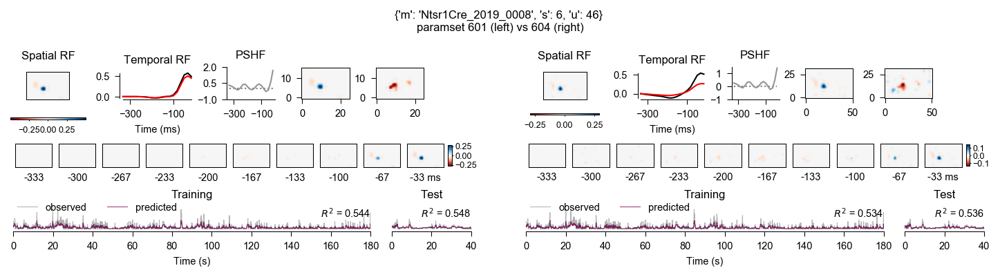

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 39, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  6]
  hmov RF QI: 0.96211
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 39, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [25 13]
  hmov RF QI: 0.960794


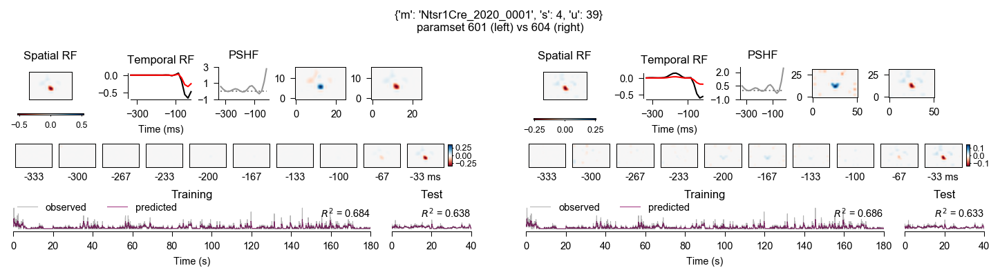

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 15, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  5]
  hmov RF QI: 0.964427
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 15, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [24 11]
  hmov RF QI: 0.960699


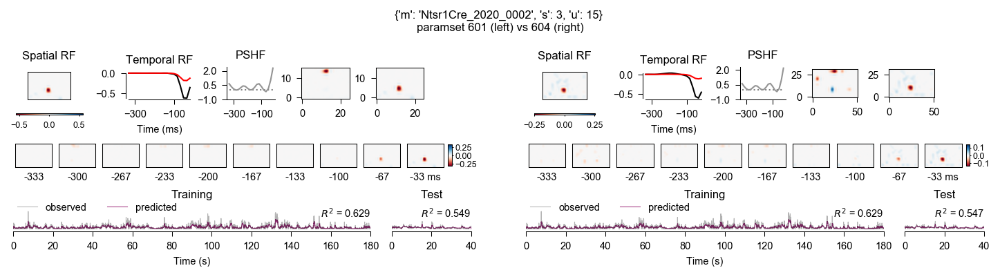

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 42, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [16 10]
  hmov RF QI: 0.937279
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 42, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [ 3 28]
  hmov RF QI: 0.345242


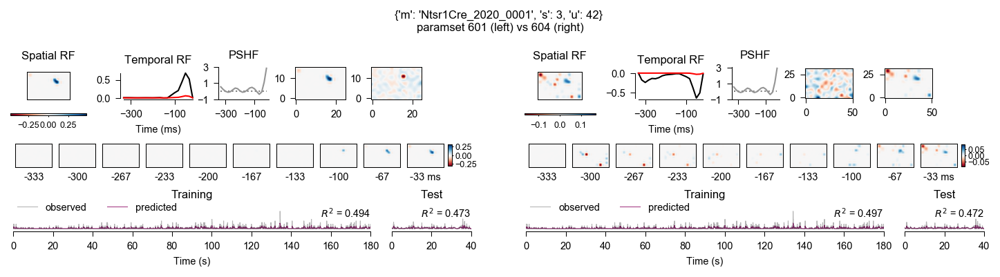

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 10, 'u': 22, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  9]
  hmov RF QI: 0.976543
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 10, 'u': 22, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [24 19]
  hmov RF QI: 0.957545


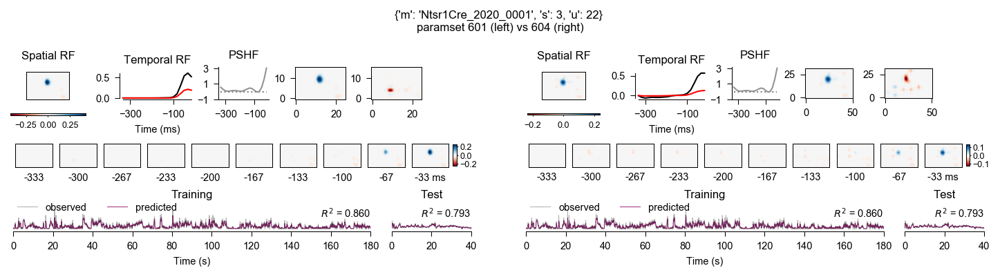

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 25, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [ 7 12]
  hmov RF QI: 0.244523
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 25, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [14 24]
  hmov RF QI: 0.233661


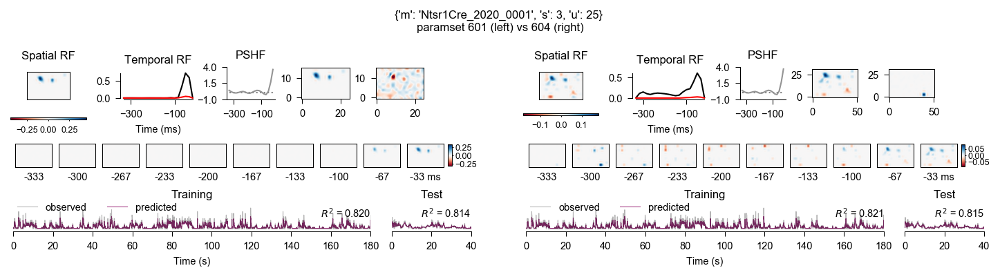

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 5, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  7]
  hmov RF QI: 0.934268
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 5, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [22 14]
  hmov RF QI: 0.942422


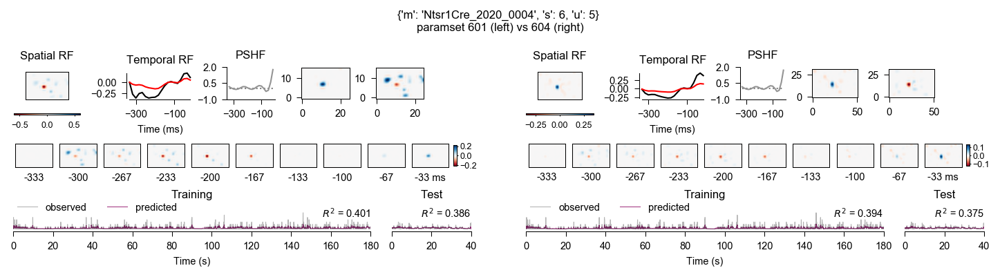

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 18, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [21  3]
  hmov RF QI: 5.74774e-10
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 18, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [47  3]
  hmov RF QI: 0.941311


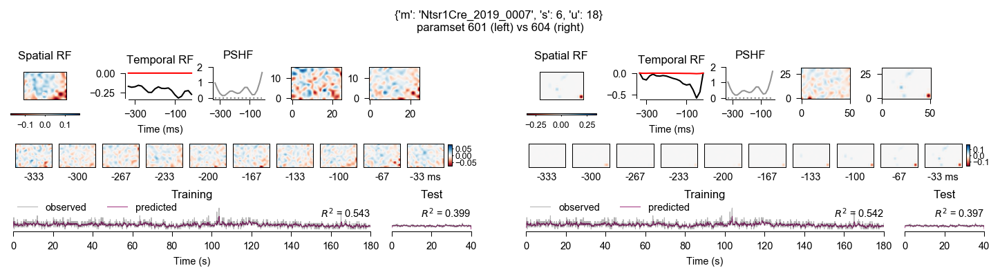

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 41, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  8]
  hmov RF QI: 0.944837
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 41, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [31  8]
  hmov RF QI: 0.937549


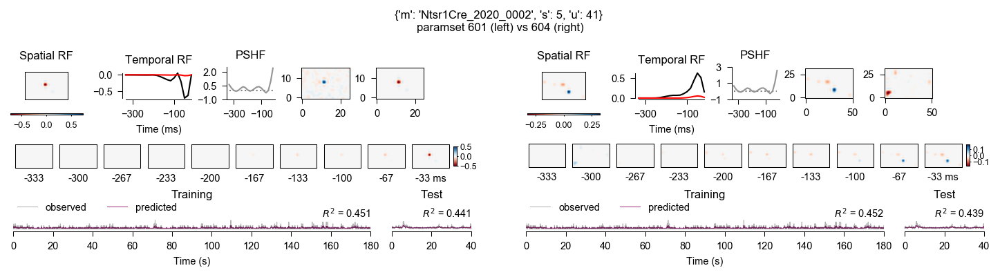

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 14, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  7]
  hmov RF QI: 0.967715
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 14, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [28 14]
  hmov RF QI: 0.936328


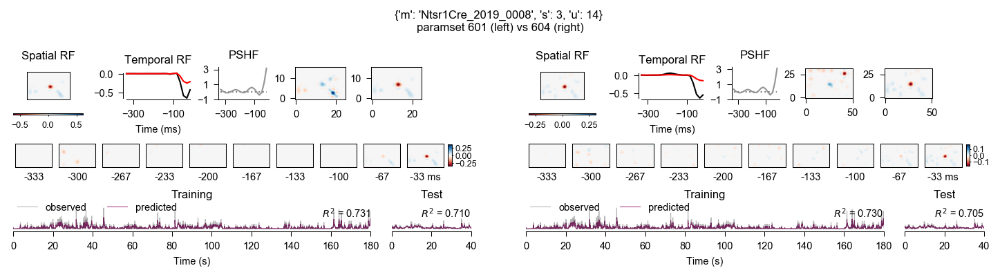

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  1]
  hmov RF QI: 0.959549
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [28  3]
  hmov RF QI: 0.935839


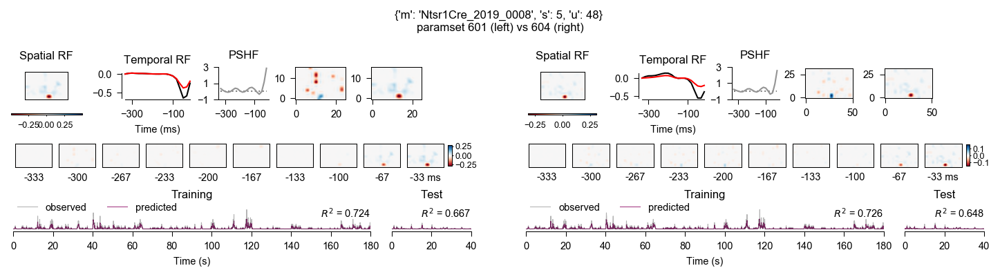

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 46, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  1]
  hmov RF QI: 0.930698
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 46, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [25  3]
  hmov RF QI: 0.933452


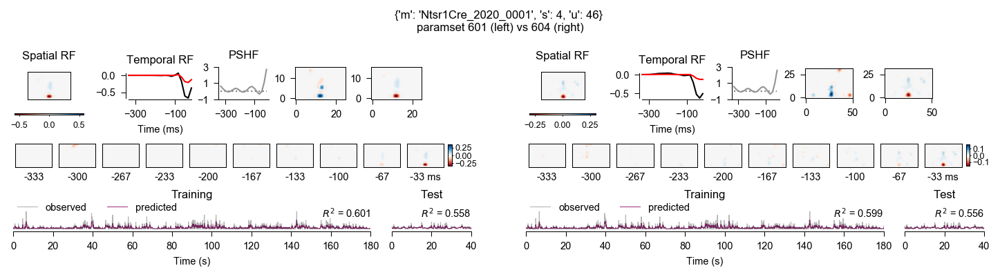

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 3, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  8]
  hmov RF QI: 0.972515
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 3, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [21 17]
  hmov RF QI: 0.932099


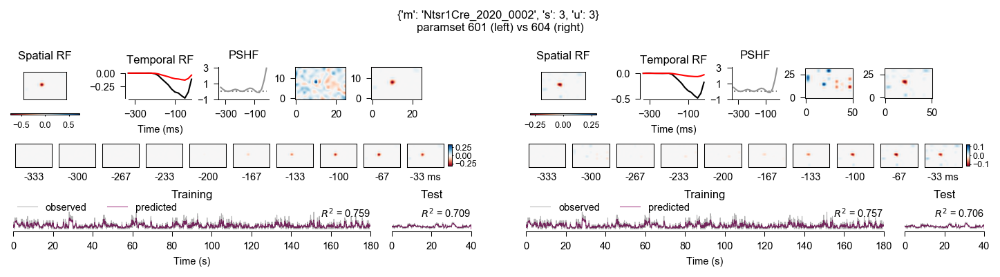

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 20, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  3]
  hmov RF QI: 0.952517
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 20, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [27  6]
  hmov RF QI: 0.931729


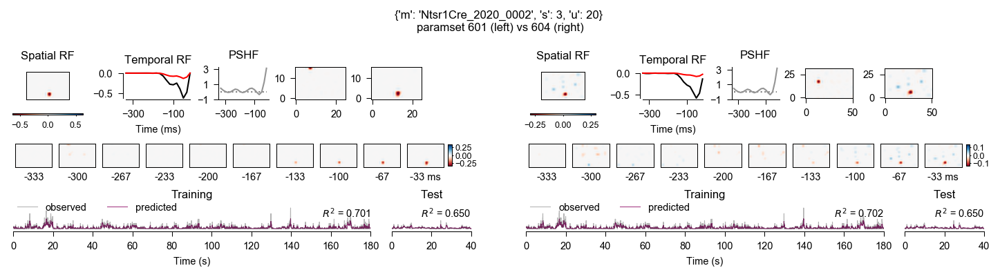

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 6, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  9]
  hmov RF QI: 0.96018
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 6, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [22 18]
  hmov RF QI: 0.930646


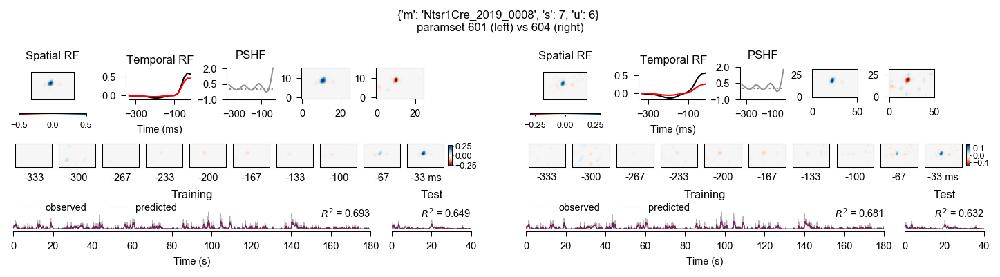

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 51, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  3]
  hmov RF QI: 0.942903
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 51, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [26  6]
  hmov RF QI: 0.929996


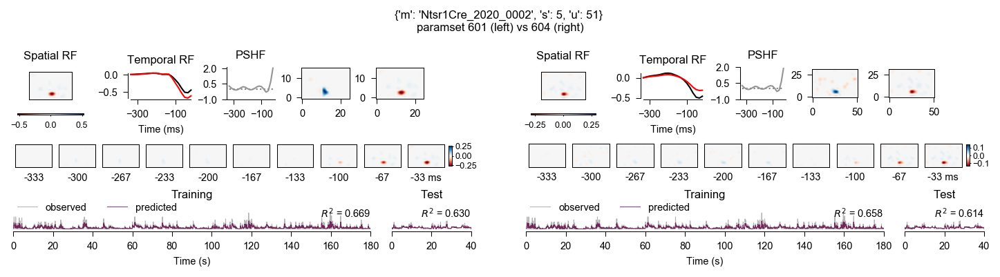

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 7, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  5]
  hmov RF QI: 0.949717
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 7, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [20 11]
  hmov RF QI: 0.925766


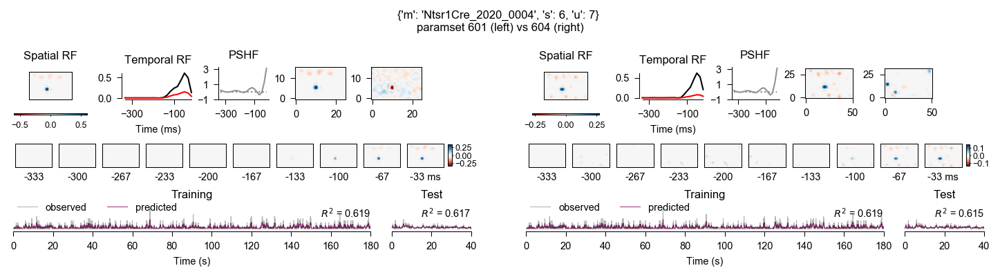

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 12, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11 11]
  hmov RF QI: 0.967595
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 12, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [23 22]
  hmov RF QI: 0.925328


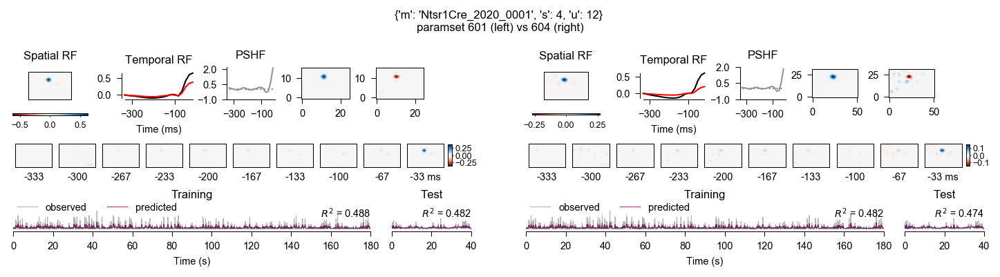

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 18, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  3]
  hmov RF QI: 0.942376
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 18, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [22  6]
  hmov RF QI: 0.922042


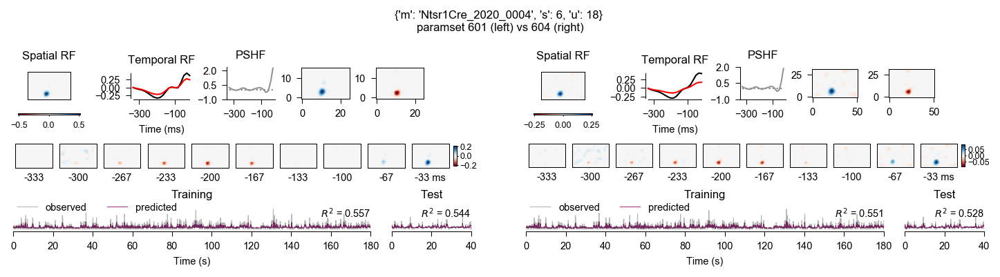

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 33, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  1]
  hmov RF QI: 0.904029
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 33, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [28  3]
  hmov RF QI: 0.921796


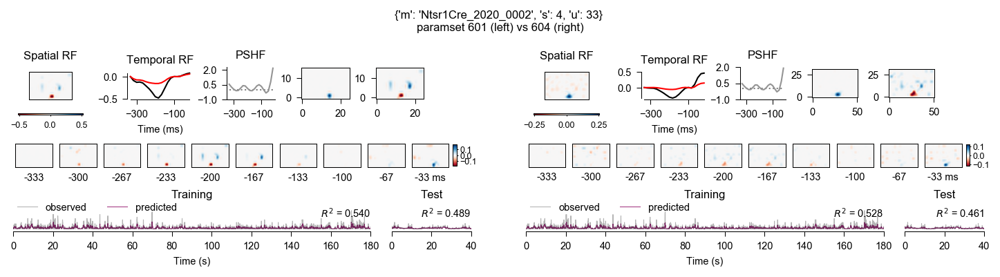

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 20, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  3]
  hmov RF QI: 0.982334
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 20, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [21  7]
  hmov RF QI: 0.921781


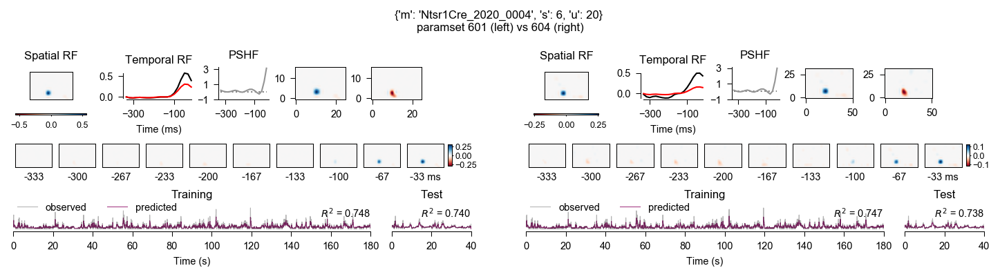

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 42, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [14  4]
  hmov RF QI: 0.841738
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 42, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [29  7]
  hmov RF QI: 0.920538


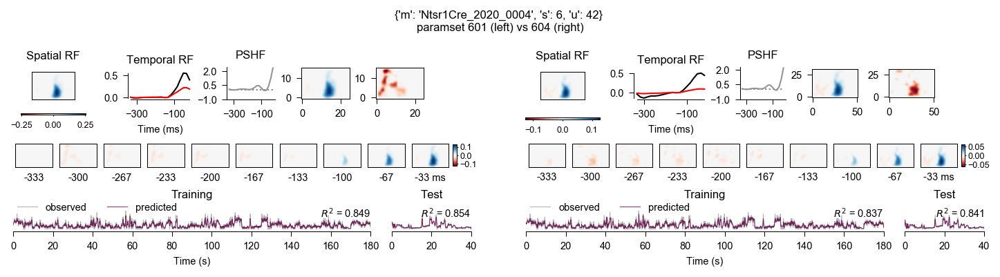

hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 35, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  7]
  hmov RF QI: 0.945964
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 35, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [27 15]
  hmov RF QI: 0.919285


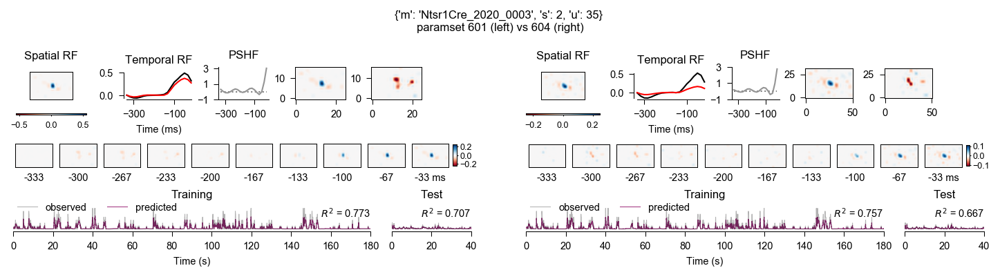

hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 129, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [3 8]
  hmov RF QI: 0.270617
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 129, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [25 22]
  hmov RF QI: 0.918655


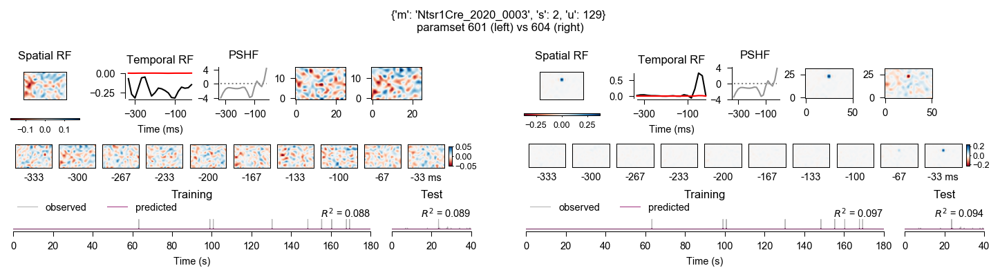

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 14, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13 10]
  hmov RF QI: 0.96151
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 14, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [26 20]
  hmov RF QI: 0.915642


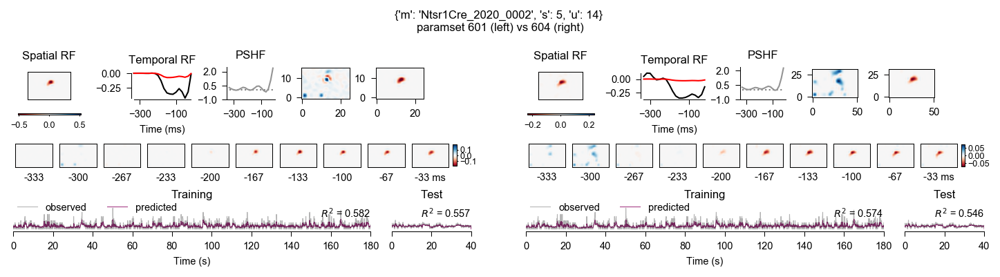

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 8, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [16  9]
  hmov RF QI: 0.950669
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 8, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [32 18]
  hmov RF QI: 0.913875


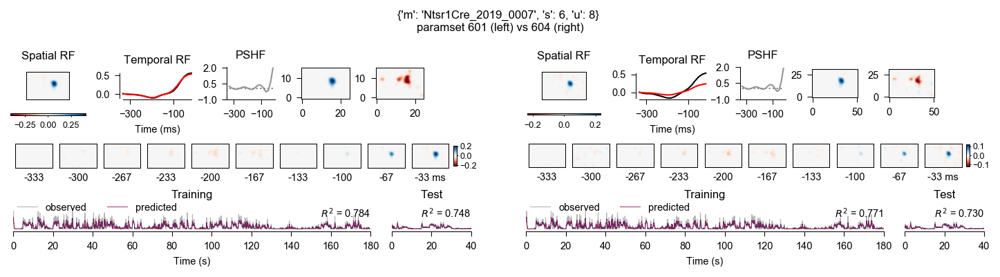

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 25, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  4]
  hmov RF QI: 0.97863
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 25, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [25  9]
  hmov RF QI: 0.912139


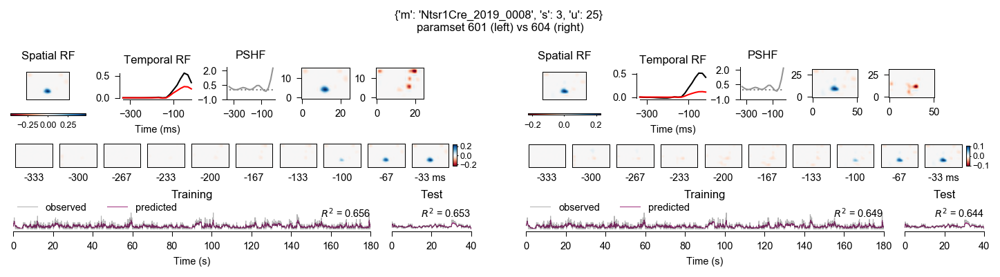

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 19, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  9]
  hmov RF QI: 0.960772
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 19, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [26 18]
  hmov RF QI: 0.911326


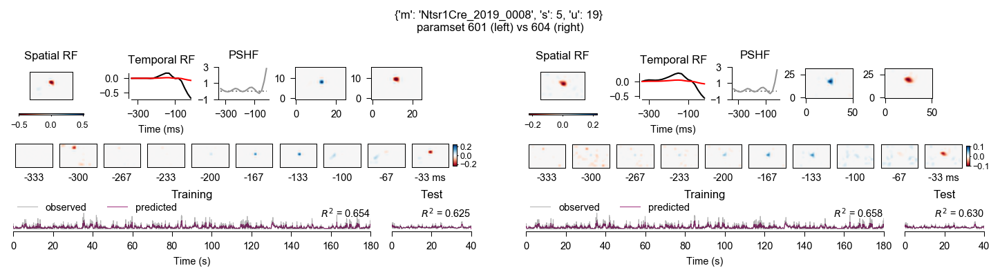

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 27, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [15  7]
  hmov RF QI: 0.260439
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 27, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [25  2]
  hmov RF QI: 0.908938


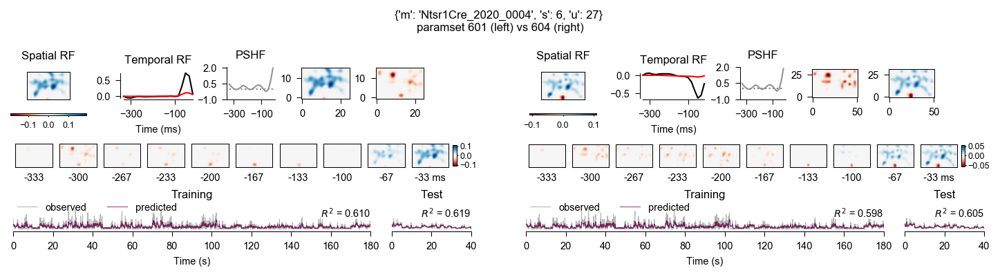

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 6, 'e': 6, 'u': 23, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  1]
  hmov RF QI: 0.973928
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 6, 'e': 6, 'u': 23, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [28  4]
  hmov RF QI: 0.90833


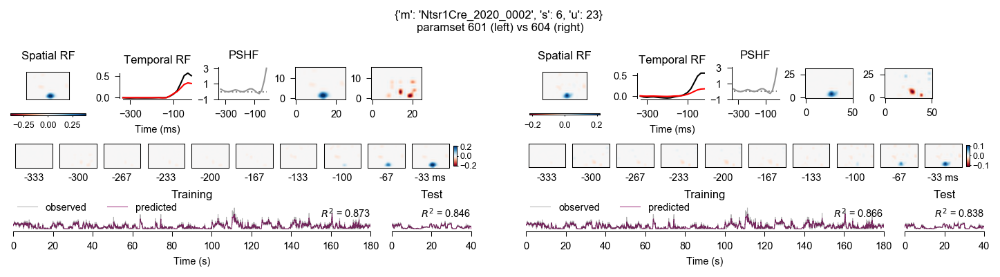

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 6, 'e': 6, 'u': 15, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  6]
  hmov RF QI: 0.974614
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 6, 'e': 6, 'u': 15, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [24 13]
  hmov RF QI: 0.907962


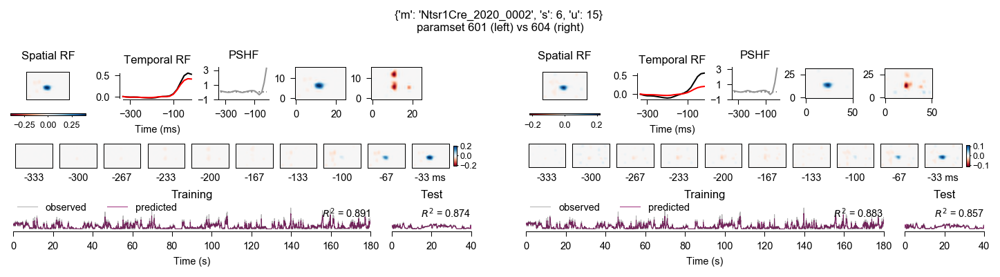

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 9, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  7]
  hmov RF QI: 0.657718
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 9, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [19 11]
  hmov RF QI: 0.905734


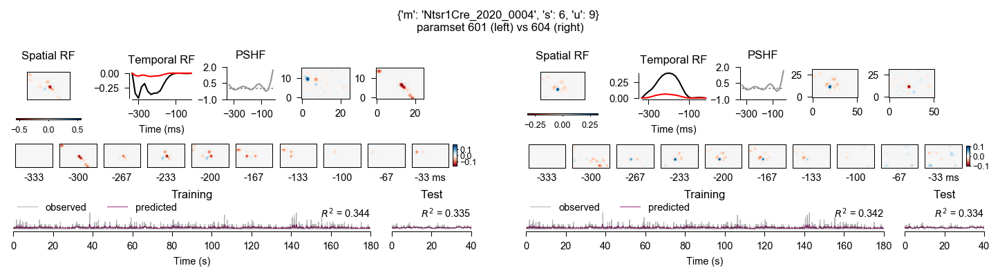

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 9, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [5 3]
  hmov RF QI: 0.910647
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 9, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [11  6]
  hmov RF QI: 0.905023


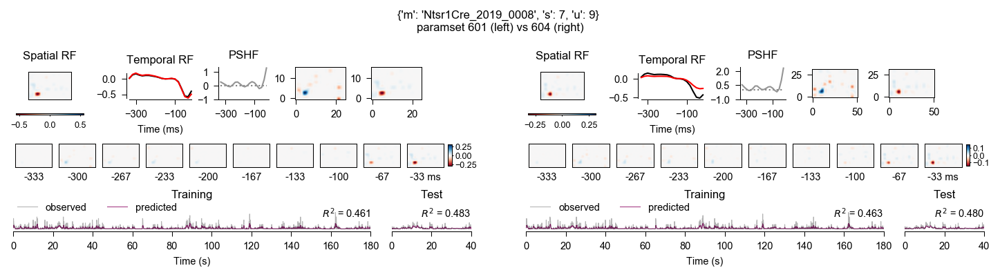

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 18, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  6]
  hmov RF QI: 0.977918
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 18, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [27 12]
  hmov RF QI: 0.903489


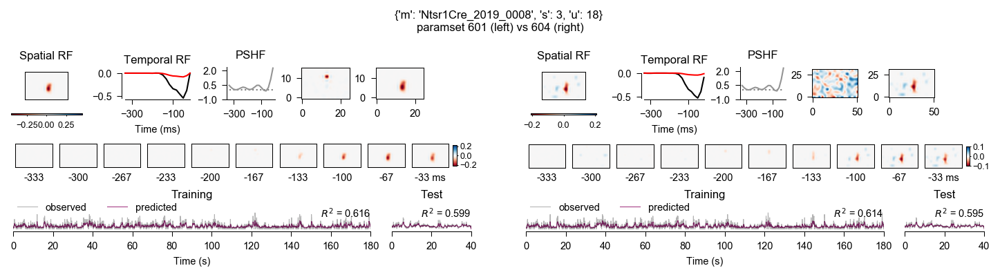

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 13, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [ 7 12]
  hmov RF QI: 0.103093
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 13, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [ 3 18]
  hmov RF QI: 0.213718


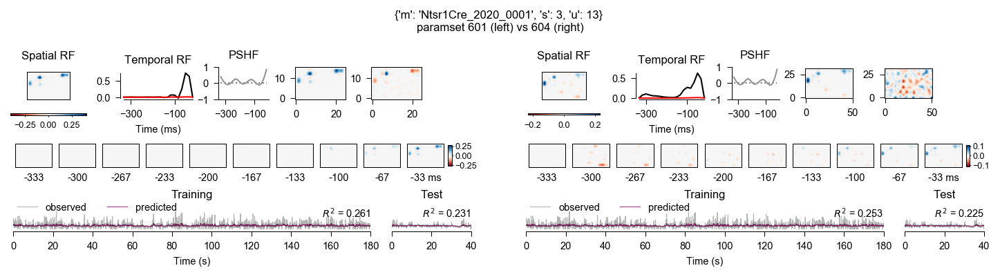

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 6, 'e': 6, 'u': 30, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [6 4]
  hmov RF QI: 0.537224
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 6, 'e': 6, 'u': 30, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [28 20]
  hmov RF QI: 0.902339


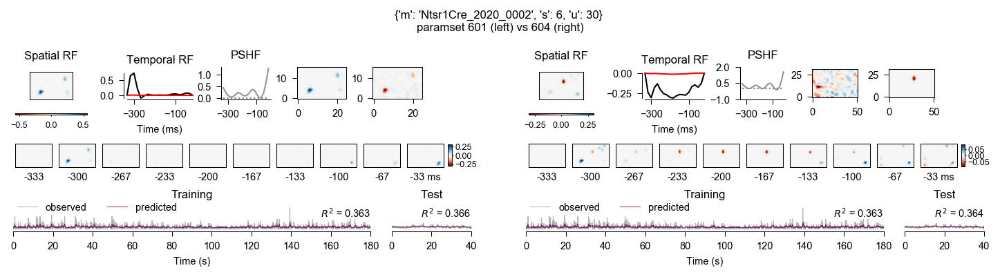

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 40, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  7]
  hmov RF QI: 0.90216
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 40, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [20 14]
  hmov RF QI: 0.900754


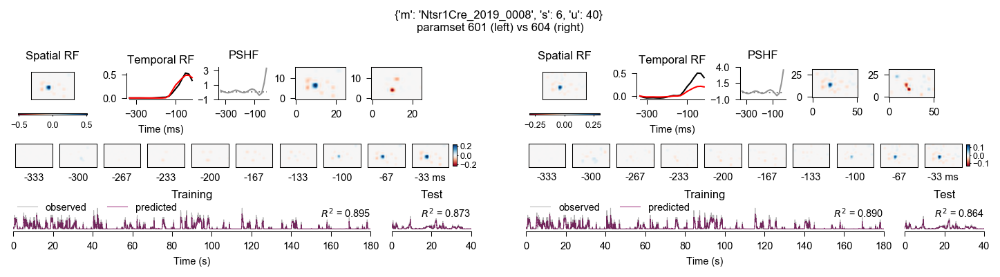

hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 116, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [14  4]
  hmov RF QI: 0.890691
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 116, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [30  8]
  hmov RF QI: 0.898056


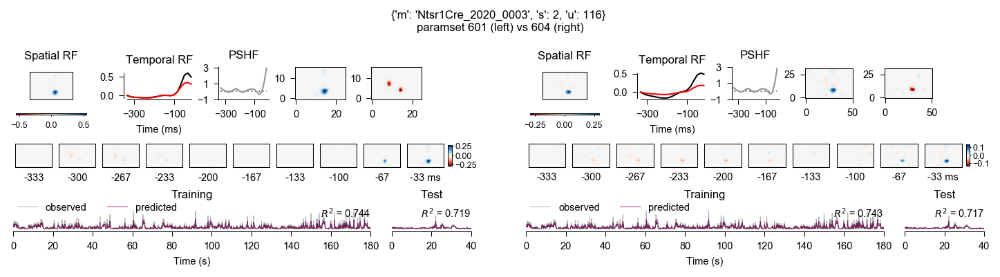

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 27, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  7]
  hmov RF QI: 0.963622
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 27, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [27 14]
  hmov RF QI: 0.89414


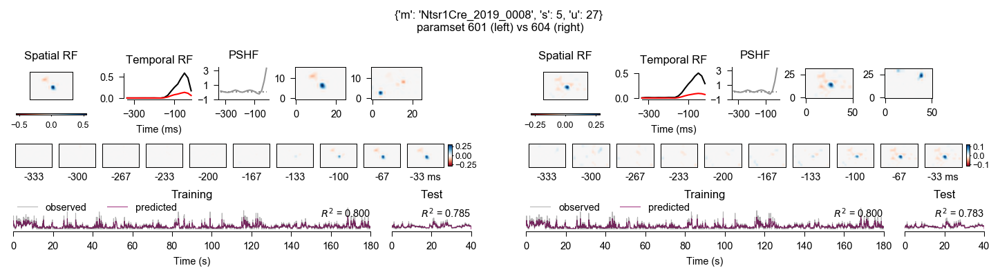

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 23, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  2]
  hmov RF QI: 0.958409
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 23, 'spl_paramset': 604, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [25  5]
  hmov RF QI: 0.891534


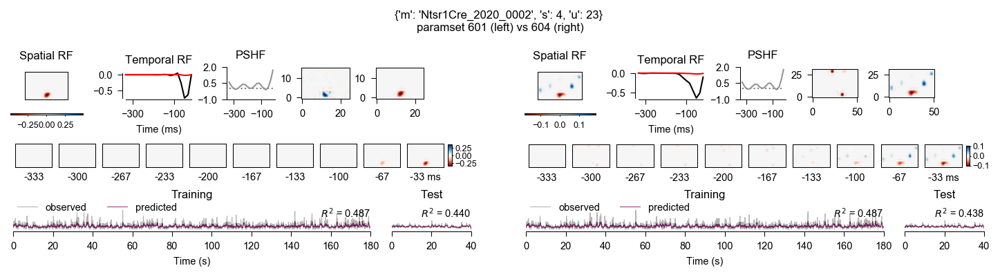

In [12]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 604').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
# df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
units = units.sort_values('spl_rf_qi', ascending=False)

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=40).iterrows():    
    unit = unit[['m','s','u']]
    unit = unit.to_dict()
    
    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # Plot 601 hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 601}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[0])
        print(f'hmov key: {key}')

        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        rf_qi = (SplineLNP.Eval() & key).fetch1('spl_rf_qi') 
        print(f'  hmov RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')

    # Plot 604 model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 604}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'hmov key: {key}')
        
        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        rf_qi = (SplineLNP.Eval() & key).fetch1('spl_rf_qi')         
        print(f'  hmov  RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
    fig.suptitle(f'{unit} \nparamset 601 (left) vs 604 (right)', fontsize=8)

    plt.show()

## Check effect of higher spatial DF on model performance

In [4]:
SplineLNPParams & {'spl_paramset': 407}  # spat_df = 6

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
407,hmov,softplus,1.0,1.4,0.1,1500,6,7,True,20,10,200,corrcoef,False,20,1,0.06,60.0,False,0,0,False,0,0,False,0,0,True


In [44]:
SplineLNPParams & {'spl_paramset': 601}  # spat_df = 12

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
601,hmov,softplus,1.0,1.4,0.2,1000,12,12,True,20,10,200,corrcoef,False,20,1,0.06,60.0,False,0,0,False,0,0,False,0,0,True


In [47]:
SplineLNPParams & {'spl_paramset': 602}  # spat_df = 16

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
602,hmov,softplus,1.0,1.4,0.2,1000,16,12,True,20,10,200,corrcoef,False,20,1,0.06,60.0,False,0,0,False,0,0,False,0,0,True


In [5]:
df = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 407 OR spl_paramset = 601 OR spl_paramset = 602').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
df

,m,s,e,u,paramset,stim,r_test,rf_qi,rf_area
0,Ntsr1Cre_2019_0007,6,9,1,407,hmov,0.903087,8.226940e-10,0.25
1,Ntsr1Cre_2019_0007,6,9,1,601,hmov,0.911217,2.579130e-01,0.25
2,Ntsr1Cre_2019_0007,6,9,1,602,hmov,0.910257,2.414890e-01,0.25
3,Ntsr1Cre_2019_0007,6,9,2,407,hmov,0.828924,5.967900e-01,0.25
4,Ntsr1Cre_2019_0007,6,9,2,601,hmov,0.862299,9.251950e-02,0.25
...,...,...,...,...,...,...,...,...,...
738,Ntsr1Cre_2020_0004,6,10,68,601,hmov,0.748764,1.402850e-01,0.50
739,Ntsr1Cre_2020_0004,6,10,68,602,hmov,0.749024,1.203780e-01,0.25
740,Ntsr1Cre_2020_0004,6,10,70,407,hmov,0.621671,1.991780e-01,0.75
741,Ntsr1Cre_2020_0004,6,10,70,601,hmov,0.652966,7.844740e-01,1.00


            r_test                     rf_qi                   rf_area                
              mean       std count      mean       std count      mean       std count
paramset                                                                              
407       0.799119  0.177639   256  0.514999  0.296501   256  6.091797  6.674606   256
601       0.823477  0.176573   256  0.583141  0.353567   256  2.042969  2.061579   256
602       0.835930  0.160023   231  0.458483  0.393796   231  1.066017  1.742444   231


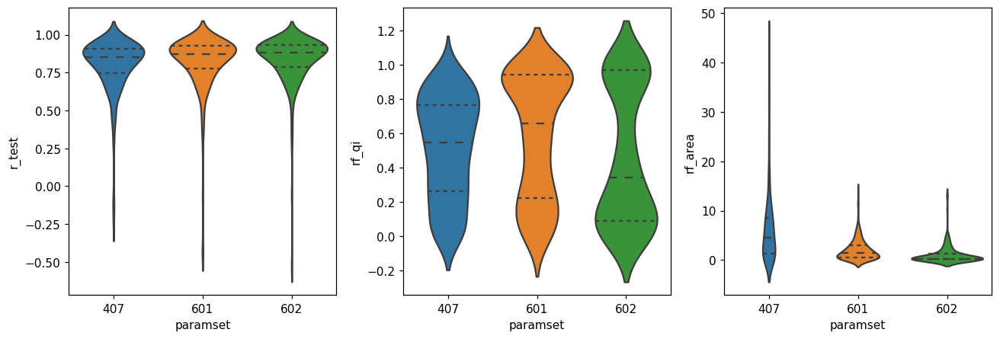

In [6]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=cm2inch((30,10)), dpi=110, constrained_layout=True)

sns.violinplot(data=df, x='paramset', y='r_test', inner='quartile', ax=axs[0])
# sns.swarmplot(data=df, x='paramset', y='r_test', color='white', edgecolor='gray', alpha=0.5, size=3.5, ax=axs)
# sns.kdeplot(data=df, y='paramset', hue='r_test', ax=axs)
sns.violinplot(data=df, x='paramset', y='rf_qi', inner='quartile', ax=axs[1])
sns.violinplot(data=df, x='paramset', y='rf_area', inner='quartile', ax=axs[2])

print(df[['paramset', 'r_test', 'rf_qi', 'rf_area']].groupby('paramset').agg(['mean', 'std', 'count']))

### Test stats
Use paired data for better comparison

In [7]:
df1 = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 601').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df1.columns = df1.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)

df2 = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 602').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df2.columns = df2.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)

df3 = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 407').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df3.columns = df3.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)

df = df1.merge(df2, on=['m','s','e','u'], how='inner')
df = df.merge(df3, on=['m','s','e','u'], how='inner')
df

,m,s,e,u,paramset_x,stim_x,r_test_x,rf_qi_x,rf_area_x,paramset_y,stim_y,r_test_y,rf_qi_y,rf_area_y,paramset,stim,r_test,rf_qi,rf_area
0,Ntsr1Cre_2019_0007,6,9,1,601,hmov,0.911217,0.257913,0.25,602,hmov,0.910257,2.414890e-01,0.25,407,hmov,0.903087,8.226940e-10,0.25
1,Ntsr1Cre_2019_0007,6,9,2,601,hmov,0.862299,0.092520,0.25,602,hmov,0.861850,4.262670e-02,0.25,407,hmov,0.828924,5.967900e-01,0.25
2,Ntsr1Cre_2019_0007,6,9,3,601,hmov,0.852358,0.424590,0.75,602,hmov,0.852501,7.065550e-10,0.00,407,hmov,0.833723,6.135330e-10,0.25
3,Ntsr1Cre_2019_0007,6,9,4,601,hmov,0.744305,0.128857,0.50,602,hmov,0.746072,3.200990e-01,0.25,407,hmov,0.613258,4.535360e-10,0.00
4,Ntsr1Cre_2019_0007,6,9,5,601,hmov,0.490190,0.954054,0.75,602,hmov,0.532165,1.042460e-01,0.25,407,hmov,0.371718,5.019240e-02,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,Ntsr1Cre_2020_0004,6,10,58,601,hmov,0.975571,0.084604,0.25,602,hmov,0.979791,2.674830e-10,0.25,407,hmov,0.944187,3.090970e-01,3.00
227,Ntsr1Cre_2020_0004,6,10,61,601,hmov,0.756284,0.245828,0.50,602,hmov,0.757258,1.952720e-01,0.25,407,hmov,0.739635,1.762990e-01,1.75
228,Ntsr1Cre_2020_0004,6,10,66,601,hmov,0.833381,0.320255,0.25,602,hmov,0.844978,2.011500e-01,0.25,407,hmov,0.830973,6.525610e-10,0.00
229,Ntsr1Cre_2020_0004,6,10,68,601,hmov,0.748764,0.140285,0.50,602,hmov,0.749024,1.203780e-01,0.25,407,hmov,0.730415,9.113900e-01,13.50


In [8]:
df.iloc[:, 4::].describe()

,paramset_x,r_test_x,rf_qi_x,rf_area_x,paramset_y,r_test_y,rf_qi_y,rf_area_y,paramset,r_test,rf_qi,rf_area
count,231.0,231.000000,2.310000e+02,231.000000,231.0,231.000000,2.310000e+02,231.000000,231.0,231.000000,2.310000e+02,231.000000
mean,601.0,0.829874,5.744327e-01,2.064935,602.0,0.835930,4.584833e-01,1.066017,407.0,0.807080,5.163293e-01,6.275974
std,0.0,0.176544,3.552568e-01,2.138316,0.0,0.160023,3.937957e-01,1.742444,0.0,0.175096,3.001692e-01,6.836712
min,601.0,-0.441323,2.167900e-10,0.000000,602.0,-0.524691,2.154350e-10,0.000000,407.0,-0.244994,4.535360e-10,0.000000
25%,601.0,0.785108,2.133935e-01,0.500000,602.0,0.788130,8.932345e-02,0.250000,407.0,0.756503,2.612905e-01,1.250000
50%,601.0,0.879934,6.577180e-01,1.500000,602.0,0.881640,3.426320e-01,0.250000,407.0,0.854418,5.579230e-01,4.500000
75%,601.0,0.927299,9.390605e-01,3.000000,602.0,0.930362,9.657810e-01,1.250000,407.0,0.913227,7.665285e-01,9.000000
max,601.0,0.975571,9.823340e-01,14.000000,602.0,0.979791,9.898480e-01,13.250000,407.0,0.970420,9.706250e-01,44.000000


ShapiroResult(statistic=0.6239817142486572, pvalue=3.146446567596693e-22)
ShapiroResult(statistic=0.6646376848220825, pvalue=4.007628675508331e-21)
ShapiroResult(statistic=0.7027184963226318, pvalue=5.423089153716562e-20)
ShapiroResult(statistic=0.8617372512817383, pvalue=1.3761902858608344e-13)
ShapiroResult(statistic=0.8244004845619202, pvalue=1.9207602867975845e-15)
ShapiroResult(statistic=0.9319623708724976, pvalue=7.453203387797203e-09)
ShapiroResult(statistic=0.7932280898094177, pvalue=8.704391145648968e-17)
ShapiroResult(statistic=0.5661499500274658, pvalue=1.1849086804594018e-23)
ShapiroResult(statistic=0.7918102741241455, pvalue=7.624452592912807e-17)


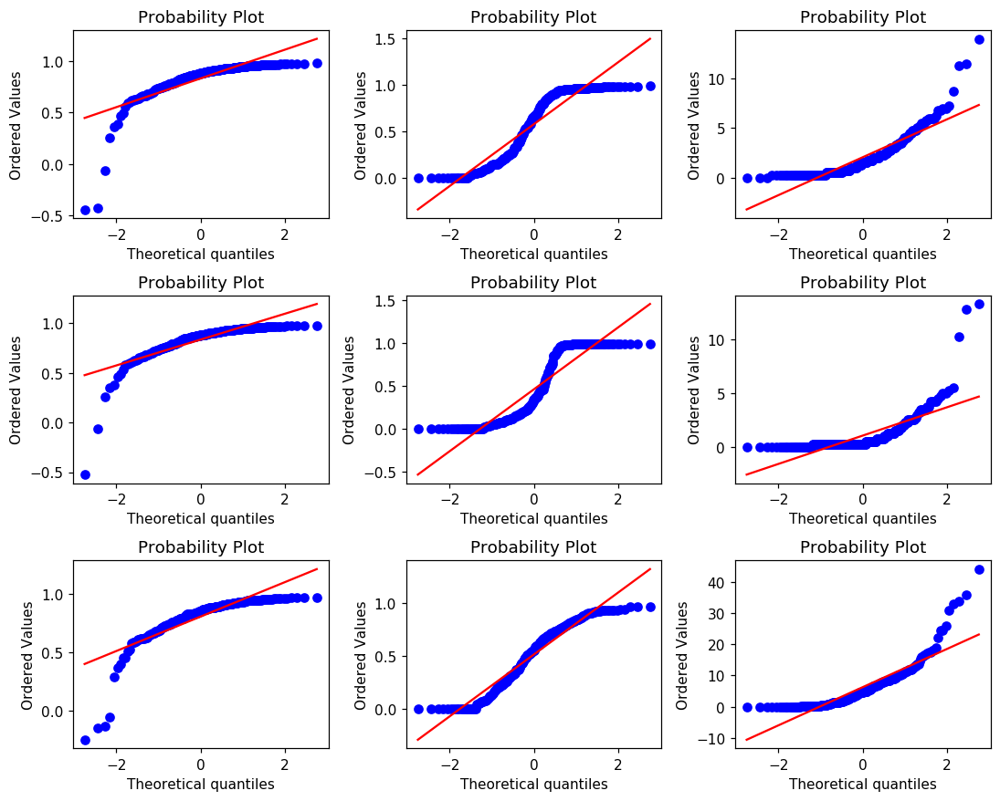

In [9]:
# Test for normality of model test performace
fig, axs = plt.subplots(nrows=3, ncols=3, figsize=cm2inch((25,20)), dpi=110, constrained_layout=True)

stats.probplot(df['r_test_x'], dist="norm", plot=axs[0,0]);
stats.probplot(df['r_test_y'], dist="norm", plot=axs[1,0]);
stats.probplot(df['r_test'], dist="norm", plot=axs[2,0]);

stats.probplot(df['rf_qi_x'], dist="norm", plot=axs[0,1]);
stats.probplot(df['rf_qi_y'], dist="norm", plot=axs[1,1]);
stats.probplot(df['rf_qi'], dist="norm", plot=axs[2,1]);

stats.probplot(df['rf_area_x'], dist="norm", plot=axs[0,2]);
stats.probplot(df['rf_area_y'], dist="norm", plot=axs[1,2]);
stats.probplot(df['rf_area'], dist="norm", plot=axs[2,2]);

print(stats.shapiro(df['r_test_x']))
print(stats.shapiro(df['r_test_y']))
print(stats.shapiro(df['r_test']))
print(stats.shapiro(df['rf_qi_x']))
print(stats.shapiro(df['rf_qi_y']))
print(stats.shapiro(df['rf_qi']))
print(stats.shapiro(df['rf_area_x']))
print(stats.shapiro(df['rf_area_y']))
print(stats.shapiro(df['rf_area']))

In [12]:
print('407 vs 601:')
print('r test performance:', stats.wilcoxon(df['r_test_x'], df['r_test']))
print('RF QI:', stats.wilcoxon(df['rf_qi_x'], df['rf_qi']))
print('RF area:', stats.wilcoxon(df['rf_area_x'], df['rf_area']))

print('\n601 vs 602:')
print('r test performance:', stats.wilcoxon(df['r_test_x'], df['r_test_y']))
print('RF QI:', stats.wilcoxon(df['rf_qi_x'], df['rf_qi_y']))
print('RF area:', stats.wilcoxon(df['rf_area_x'], df['rf_area_y']))

407 vs 601:
r test performance: WilcoxonResult(statistic=1654.0, pvalue=7.383808425194971e-31)
RF QI: WilcoxonResult(statistic=10198.0, pvalue=0.0016487984518492491)
RF area: WilcoxonResult(statistic=2047.5, pvalue=1.6052781379311552e-27)

601 vs 602:
r test performance: WilcoxonResult(statistic=6187.0, pvalue=1.3231212817901969e-12)
RF QI: WilcoxonResult(statistic=10521.0, pvalue=0.004662525530400311)
RF area: WilcoxonResult(statistic=934.0, pvalue=1.022360041420293e-26)


### Check bimodal RF QI distribution in paramset 602

RF QI: 0.989848
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 96, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [13 10]
spnoise key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 96, 'spl_paramset': 3}
spnoise  RF pos (x,y): [3 3]


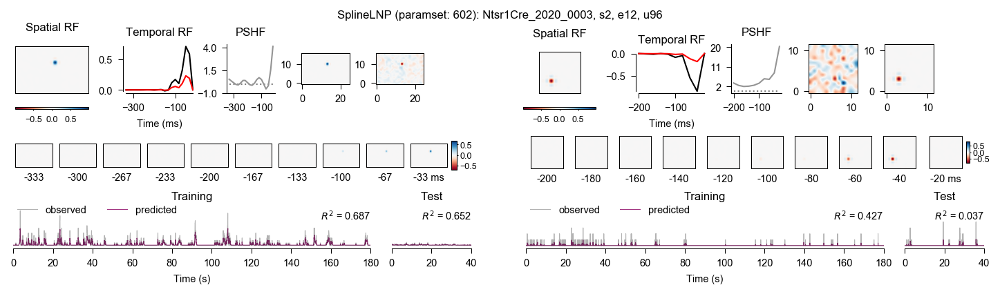

RF QI: 0.989833
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 13, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [ 0 15]
spnoise key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 2, 'u': 13, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 4]


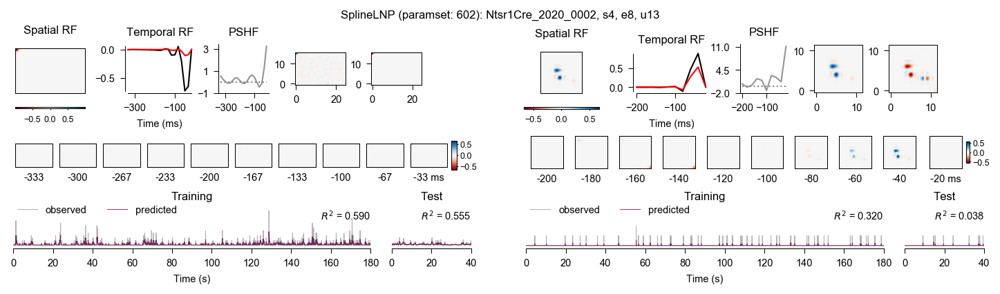

RF QI: 0.989666
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 34, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  7]
spnoise key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 34, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 4]


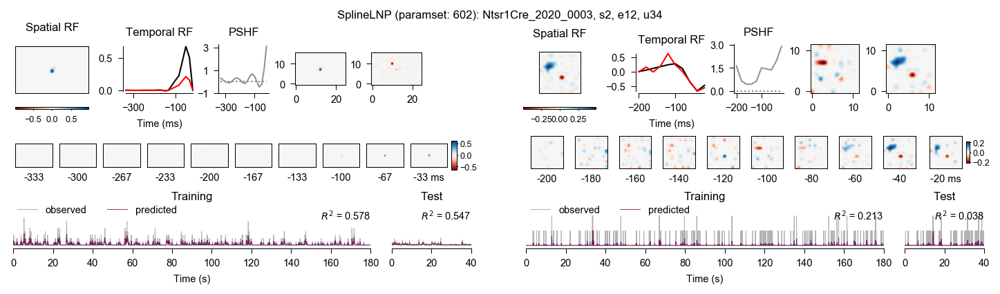

RF QI: 0.989393
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 14, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [13  8]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 14, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 6]


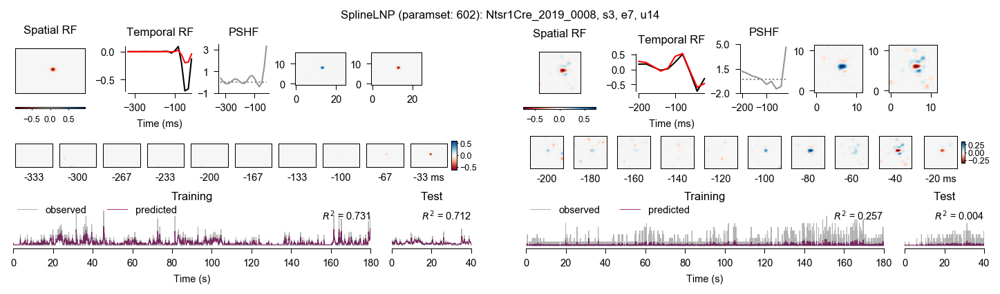

RF QI: 0.98935
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 3, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [10  8]
spnoise key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 1, 'u': 3, 'spl_paramset': 4}
spnoise  RF pos (x,y): [2 6]


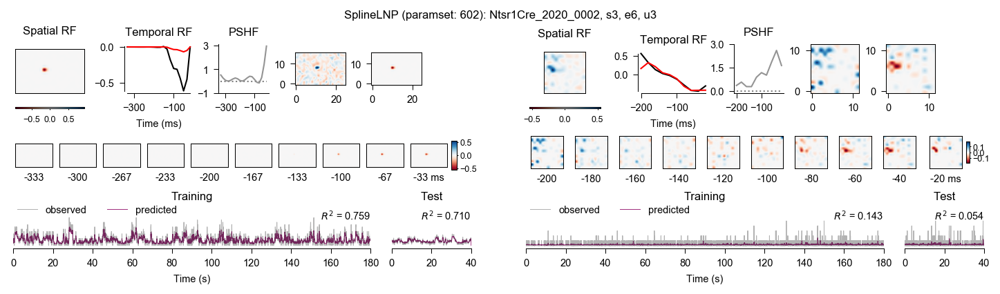

RF QI: 0.989251
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 14, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [16  5]
spnoise key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 13, 'u': 14, 'spl_paramset': 3}
spnoise  RF pos (x,y): [9 5]


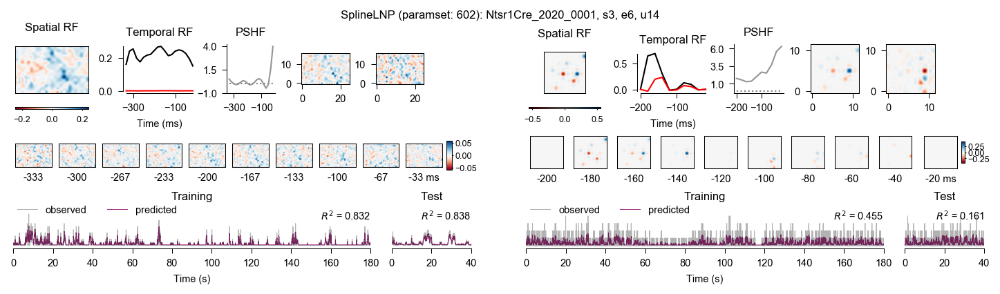

RF QI: 0.988817
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 112, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [13  7]
spnoise key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 112, 'spl_paramset': 1}
spnoise  RF pos (x,y): [6 6]


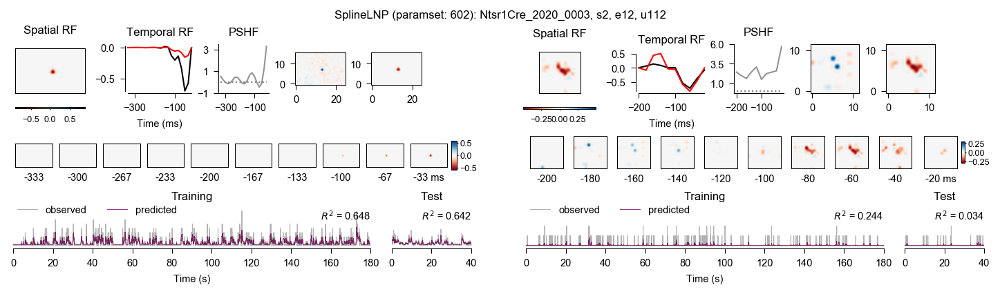

RF QI: 0.988521
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 20, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [13  2]
spnoise key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 1, 'u': 20, 'spl_paramset': 3}
spnoise  RF pos (x,y): [4 4]


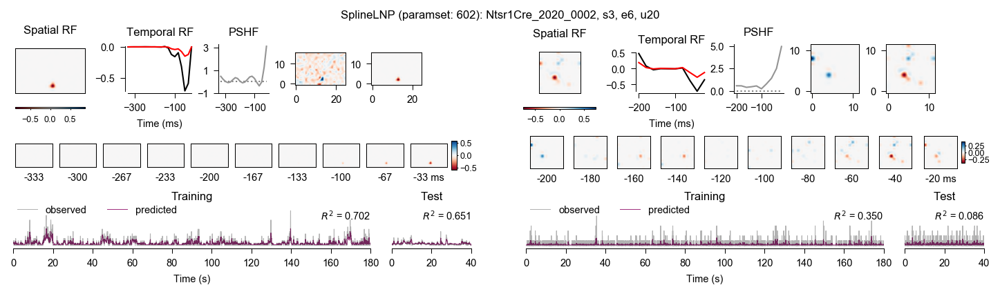

RF QI: 0.987819
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 6, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [11  6]
spnoise key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 6, 'spl_paramset': 3}
spnoise  RF pos (x,y): [5 9]


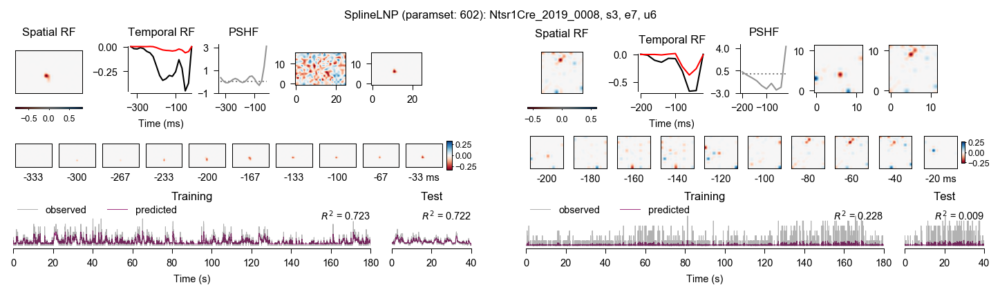

RF QI: 0.987562
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 39, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  6]
spnoise key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 39, 'spl_paramset': 4}
spnoise  RF pos (x,y): [5 4]


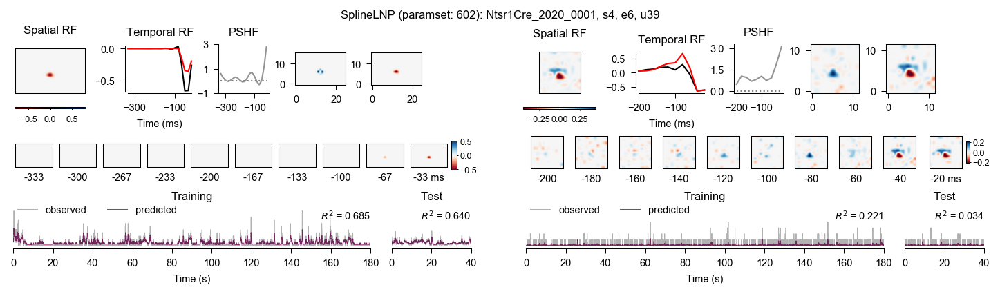

RF QI: 0.987279
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 4, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [13  7]
spnoise key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 4, 'spl_paramset': 4}
spnoise  RF pos (x,y): [7 5]


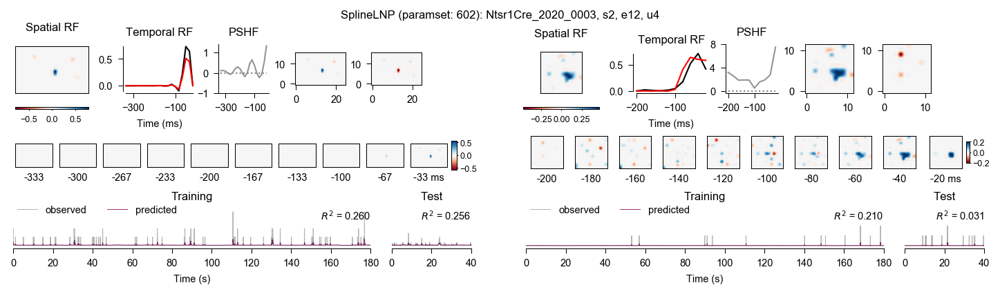

RF QI: 0.986683
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 10, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  5]
spnoise key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 10, 'spl_paramset': 1}
spnoise  RF pos (x,y): [2 9]


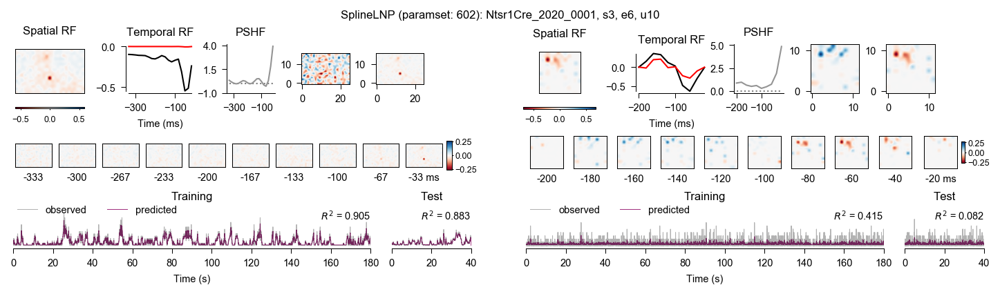

RF QI: 0.986531
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 16, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  5]
spnoise key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 1, 'u': 16, 'spl_paramset': 1}
spnoise  RF pos (x,y): [4 4]


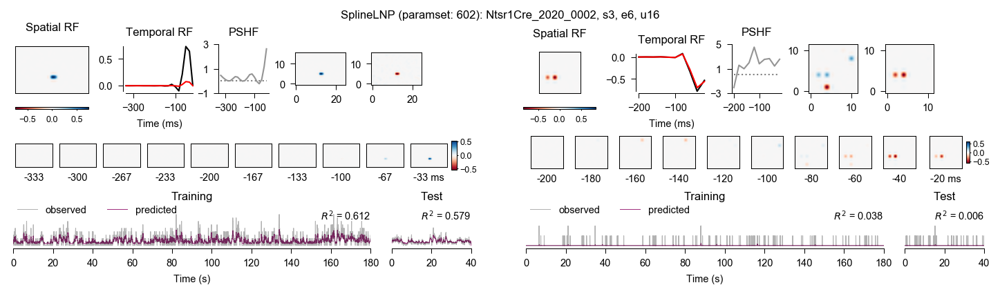

RF QI: 0.986515
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 19, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 19, 'spl_paramset': 1}
spnoise  RF pos (x,y): [ 9 10]


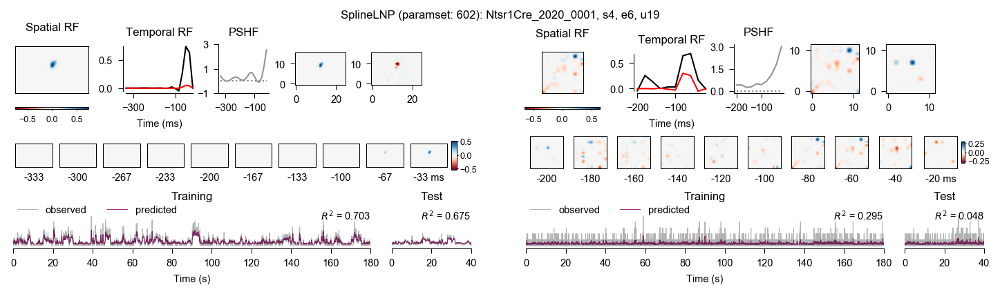

RF QI: 0.986286
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 48, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [9 6]
spnoise key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 48, 'spl_paramset': 1}
spnoise  RF pos (x,y): [11 11]


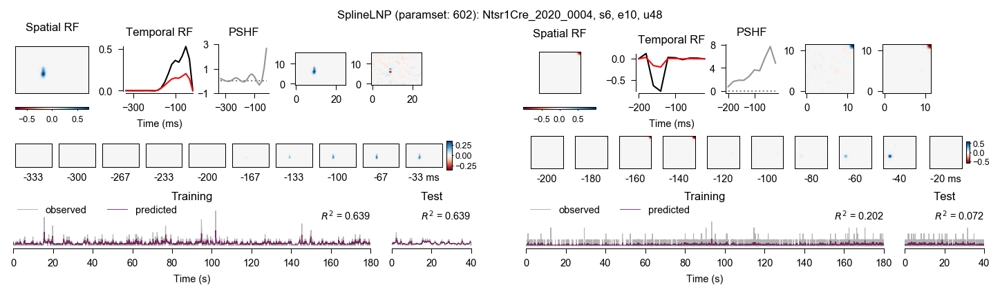

RF QI: 0.986024
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 4, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [10  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 1, 'u': 4, 'spl_paramset': 1}
spnoise  RF pos (x,y): [2 7]


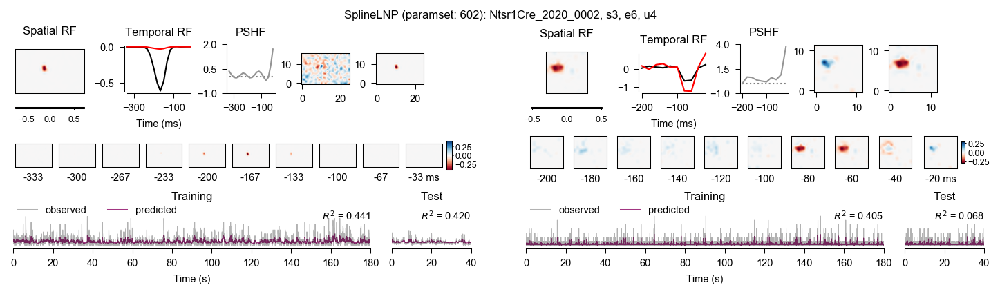

RF QI: 0.985992
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 3, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [24  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 13, 'u': 3, 'spl_paramset': 3}
spnoise  RF pos (x,y): [ 2 11]


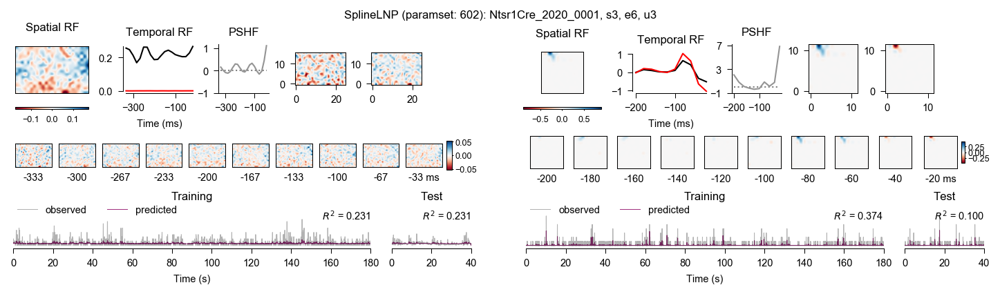

RF QI: 0.985938
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 33, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  7]
spnoise key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 33, 'spl_paramset': 3}
spnoise  RF pos (x,y): [6 3]


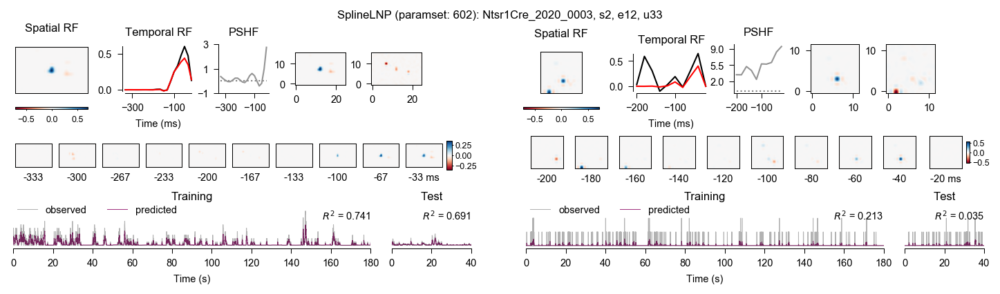

RF QI: 0.985819
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 14, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  9]
spnoise key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 1, 'u': 14, 'spl_paramset': 4}
spnoise  RF pos (x,y): [5 7]


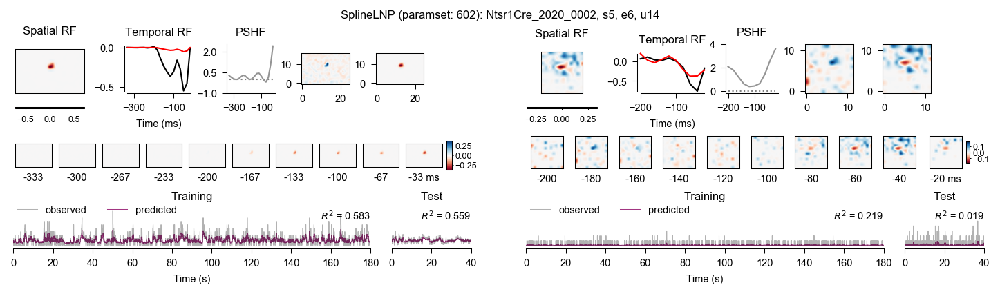

RF QI: 0.985688
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 22, 'spl_paramset': 602, 'spl_stim': 'hmov'}
hmov RF pos (x,y): [12  3]
spnoise key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 2, 'u': 22, 'spl_paramset': 3}
spnoise  RF pos (x,y): [8 7]


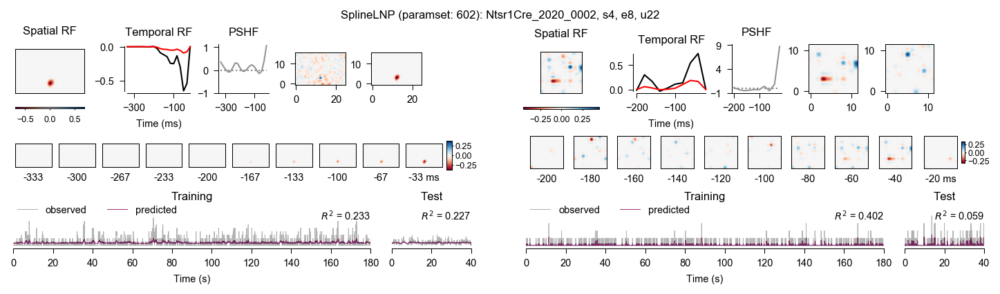

In [5]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 602').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
# df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
units = units.sort_values('spl_rf_qi', ascending=False)

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=20).iterrows():
    
    print('RF QI:', unit['spl_rf_qi'] )
    unit = unit[['m','s','u']]

    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # unit = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'u': 19}
    unit = unit.to_dict()

    # Plot best hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 602}).fetch(dj.key)[0]  # gets all hmov models for unit
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=True, gs=gs[0])
        print(f'hmov key: {key}')

        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'hmov RF pos (x,y): {rf_pos}')        

    # Plot best sparse noise model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise'}).fetch(dj.key)  # gets all spnoise models for unit
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
        key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'spnoise key: {key}')
        
        rf_pos = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix')  # test print rf pos to check top-down LGN RF progression
        print(f'spnoise  RF pos (x,y): {rf_pos}')

    plt.show()

## Compare RF areas between hmov and spnoise
Paramset 606 matches hmov image resolution and number of spline bases per degree visual angle to that of spnoise (copy text from above)
TODO: ensure that RF_area computation is correct - seems wrong

In [13]:
SplineLNPParams & {'spl_paramset': 1}  # spnoise

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
1,spnoise,softplus,1.0,0.05,0.1,1500,12,8,True,10,8,200,corrcoef,True,10,1,0.0,50.0,False,0,0,False,0,0,False,0,0,False


In [14]:
SplineLNPParams & {'spl_paramset': 606}  # matched hmov paramset

spl_paramset parameter set ID,spl_stim stimulus name ('hmov' or 'spnoise'),spl_distr nonlinearity in LNP,spl_alpha weighting betw. L2 and L1 penalty (alpha=1 only uses L1),spl_lambda regularization parameter of penalty term,spl_lr initial learning rate for the JAX optimizer,spl_max_iter maximum number of iterations for the solver,spl_spat_df degrees of freedom num of basis functions for spatial domain,spl_temp_df degrees of freedom num of basis functions for temp component,spl_pshf fit post-spike history filter,spl_pshf_len length of the post-spike history filter,spl_pshf_df number of basis functions for post-spike history filter,spl_verb when verbose=n progress will be printed in every n steps,"spl_metric 'None', 'mse', 'r2', or 'corrcoef'",spl_norm_y normalize observed responses,spl_nlag number of time steps of the kernel,spl_shift shift kernel to not predict itself,spl_spat_scaling scaling factor for spatial resolution of movie,spl_data_fs temporal sampling frequency of the data,spl_opto fit optogenetics filter,spl_opto_len length of the opto filter (number of time steps),spl_opto_df number of basis functions for opto filter,spl_run fit running filter,spl_run_len length of the running filter (number of time steps),spl_run_df number of basis functions for running filter,spl_eye fit eye filter,spl_eye_len length of the eye filter (number of time steps),spl_eye_df number of basis functions for eye filter,spl_eye_smooth smooth eye data
606,hmov,softplus,1.0,1.4,0.1,1500,13,8,True,20,10,200,corrcoef,False,20,1,0.0495,60.0,False,0,0,False,0,0,False,0,0,True


In [15]:
df = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 1 OR spl_paramset = 606').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
df

,m,s,e,u,paramset,stim,r_test,rf_qi,rf_area
0,Ntsr1Cre_2019_0002,3,1,13,1,spnoise,0.209741,0.934369,3.47
1,Ntsr1Cre_2019_0002,3,1,14,1,spnoise,0.334790,0.950912,2.78
2,Ntsr1Cre_2019_0002,3,1,19,1,spnoise,0.492860,0.987832,2.78
3,Ntsr1Cre_2019_0002,3,1,30,1,spnoise,0.093234,0.960110,2.08
4,Ntsr1Cre_2019_0002,3,1,40,1,spnoise,0.126494,0.945085,2.78
...,...,...,...,...,...,...,...,...,...
465,Ntsr1Cre_2020_0004,6,9,58,1,spnoise,0.299375,0.928529,0.00
466,Ntsr1Cre_2020_0004,6,9,61,1,spnoise,0.118243,0.746646,0.69
467,Ntsr1Cre_2020_0004,6,9,66,1,spnoise,0.179620,0.948474,0.69
468,Ntsr1Cre_2020_0004,6,9,68,1,spnoise,0.183586,0.338608,0.69


            r_test                     rf_qi                   rf_area                
              mean       std count      mean       std count      mean       std count
paramset                                                                              
1         0.175645  0.120916   310  0.507877  0.336971   310  1.007419  1.140808   310
606       0.805574  0.206879   160  0.571408  0.369658   160  1.626750  2.254638   160


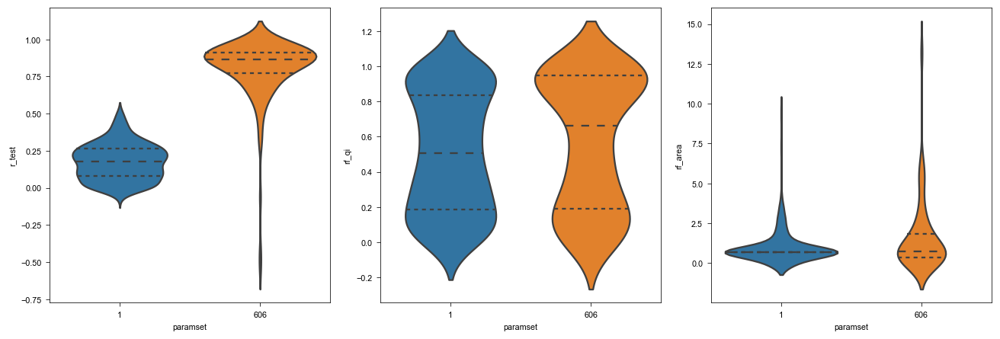

In [16]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=cm2inch((30,10)), dpi=110, constrained_layout=True)

sns.violinplot(data=df, x='paramset', y='r_test', inner='quartile', ax=axs[0])
# sns.swarmplot(data=df, x='paramset', y='r_test', color='white', edgecolor='gray', alpha=0.5, size=3.5, ax=axs)
# sns.kdeplot(data=df, y='paramset', hue='r_test', ax=axs)
sns.violinplot(data=df, x='paramset', y='rf_qi', inner='quartile', ax=axs[1])
sns.violinplot(data=df, x='paramset', y='rf_area', inner='quartile', ax=axs[2])

print(df[['paramset', 'r_test', 'rf_qi', 'rf_area']].groupby('paramset').agg(['mean', 'std', 'count']))

### Check model plots: are hmov RFs larger than spnoise RFs on a unit basis?

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 21, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [19  5]
  hmov RF QI: 0.276523
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 21, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [10  6]
  hmov RF QI: 0.979938
  hmov RF area: 0.69


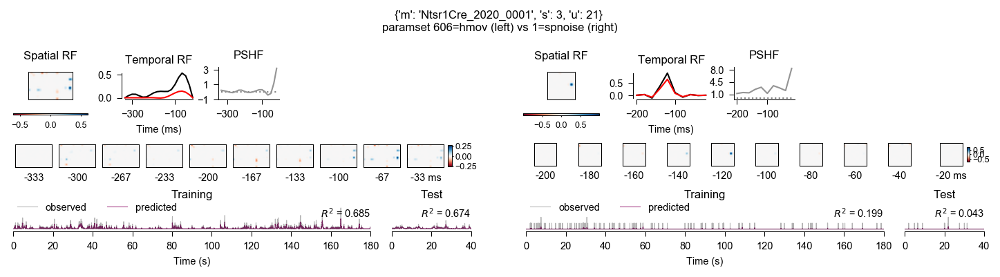

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 10, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  4]
  hmov RF QI: 0.119972
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 10, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [2 9]
  hmov RF QI: 0.518836
  hmov RF area: 0.69


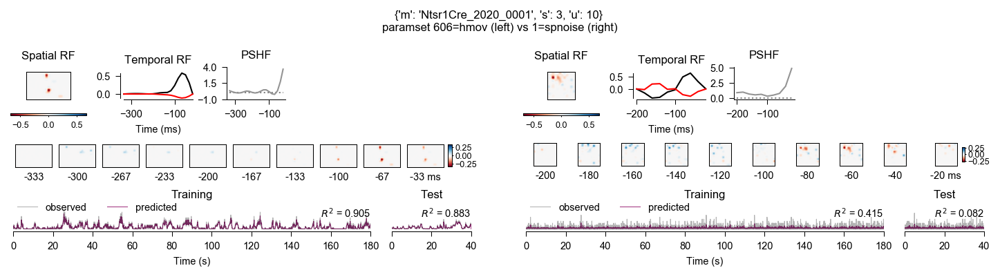

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 21, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [19  5]
  hmov RF QI: 0.276523
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 21, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [10  6]
  hmov RF QI: 0.979938
  hmov RF area: 0.69


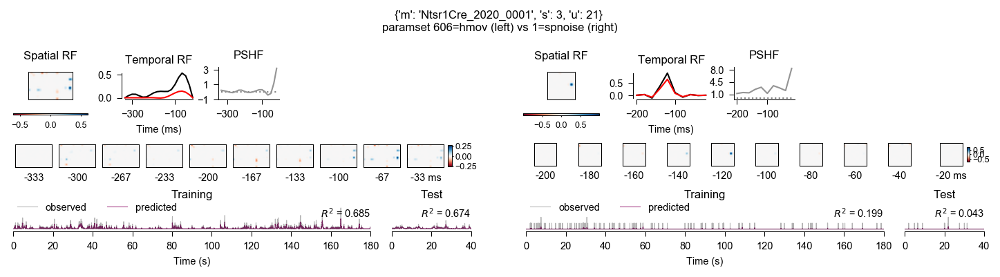

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 25, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [6 9]
  hmov RF QI: 0.4945
  hmov RF area: 1.47
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 25, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 5]
  hmov RF QI: 0.782037
  hmov RF area: 2.78


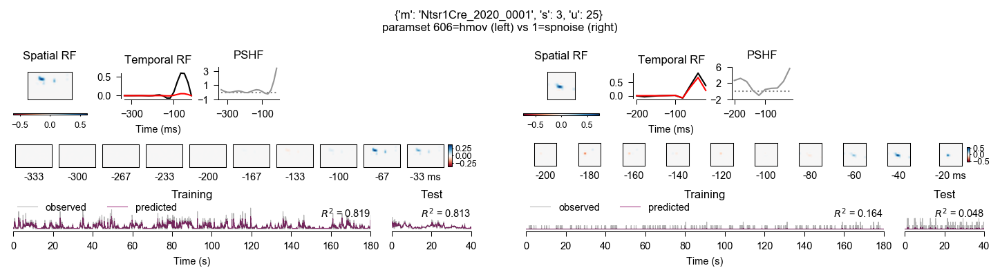

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 40, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [8 5]
  hmov RF QI: 0.908088
  hmov RF area: 1.83
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 40, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 4]
  hmov RF QI: 0.99
  hmov RF area: 0.69


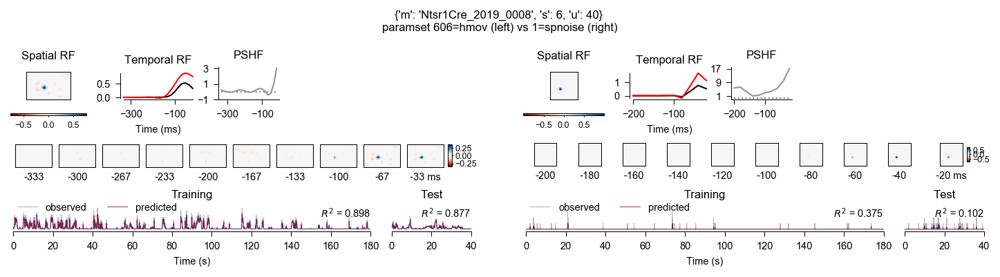

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 14, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  4]
  hmov RF QI: 0.868277
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 14, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [0 5]
  hmov RF QI: 0.319735
  hmov RF area: 0.0


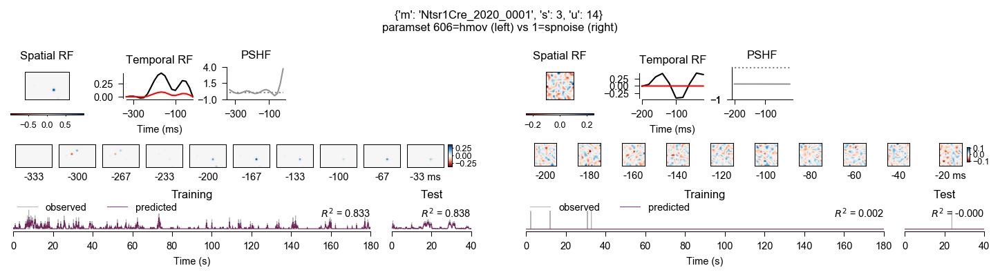

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 7, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [16  1]
  hmov RF QI: 0.450881
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 7, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 9]
  hmov RF QI: 0.725174
  hmov RF area: 1.39


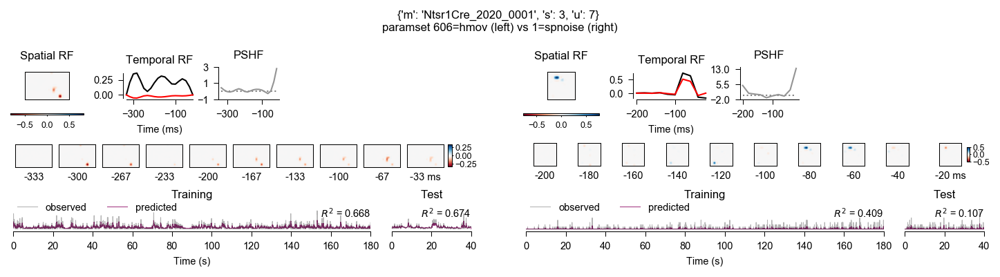

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 25, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [6 9]
  hmov RF QI: 0.4945
  hmov RF area: 1.47
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 25, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 5]
  hmov RF QI: 0.782037
  hmov RF area: 2.78


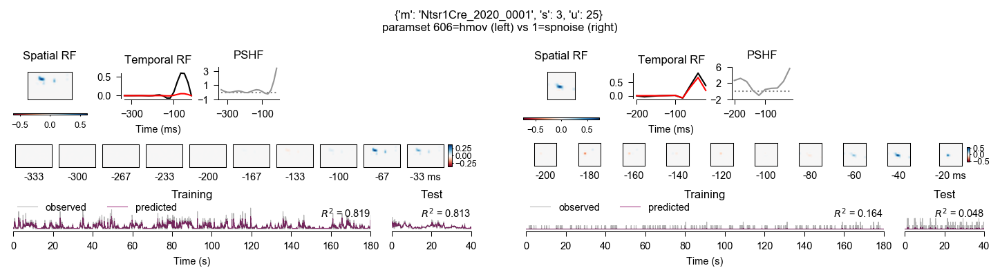

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 27, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  5]
  hmov RF QI: 0.987728
  hmov RF area: 1.83
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 27, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 4]
  hmov RF QI: 0.50928
  hmov RF area: 0.69


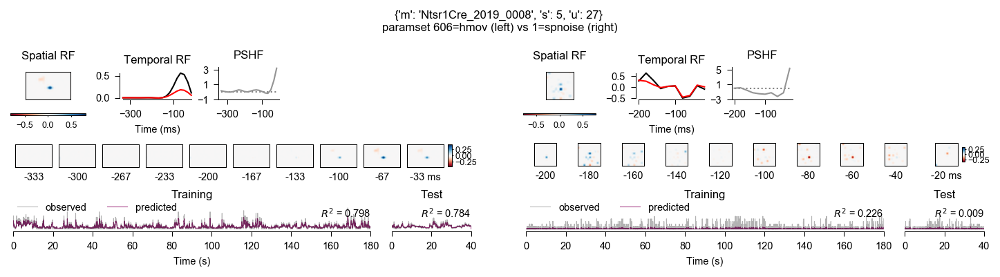

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 10, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  4]
  hmov RF QI: 0.119972
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 10, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [2 9]
  hmov RF QI: 0.518836
  hmov RF area: 0.69


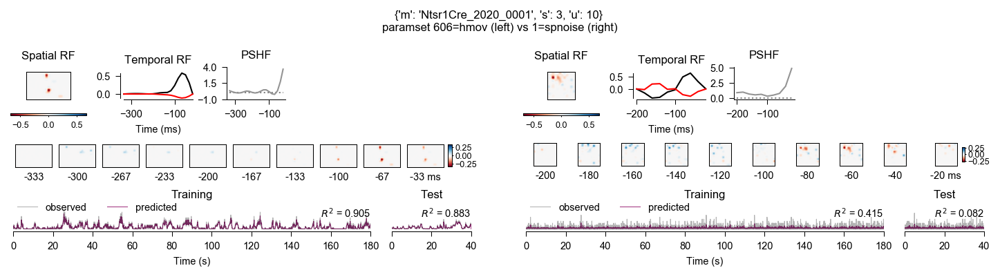

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 22, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  4]
  hmov RF QI: 0.976577
  hmov RF area: 6.59
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 22, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [ 9 11]
  hmov RF QI: 0.523146
  hmov RF area: 0.69


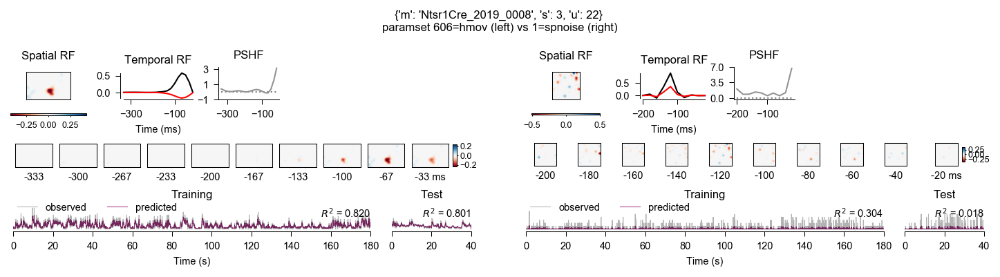

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 30, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  6]
  hmov RF QI: 0.896457
  hmov RF area: 5.13
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 30, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 5]
  hmov RF QI: 0.899326
  hmov RF area: 0.69


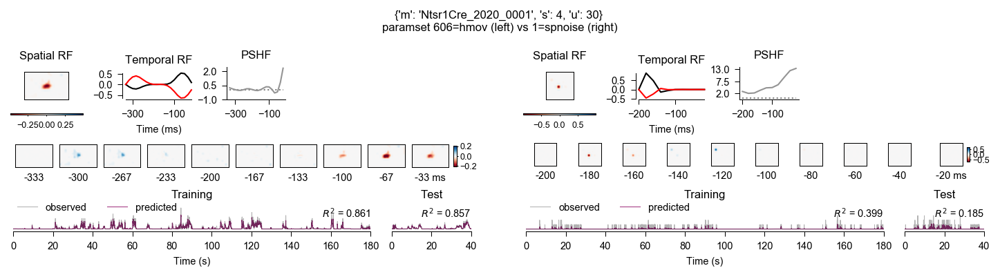

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 7, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [16  1]
  hmov RF QI: 0.450881
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 7, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 9]
  hmov RF QI: 0.725174
  hmov RF area: 1.39


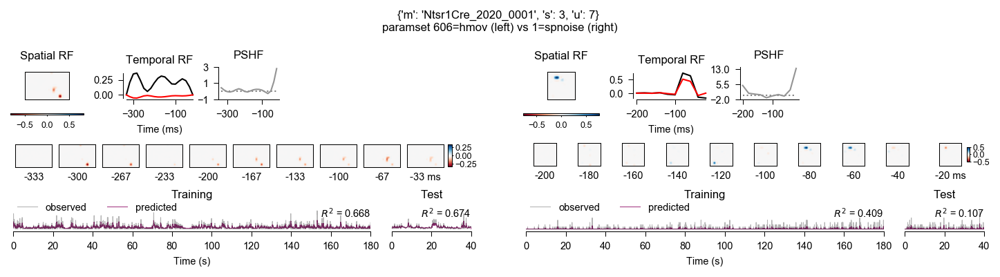

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 14, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  4]
  hmov RF QI: 0.868277
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 14, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [0 5]
  hmov RF QI: 0.319735
  hmov RF area: 0.0


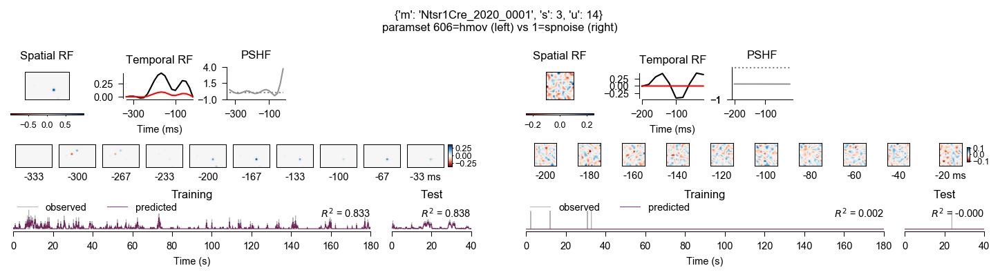

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 25, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [9 7]
  hmov RF QI: 0.986056
  hmov RF area: 1.1
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 25, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [7 2]
  hmov RF QI: 0.256431
  hmov RF area: 0.69


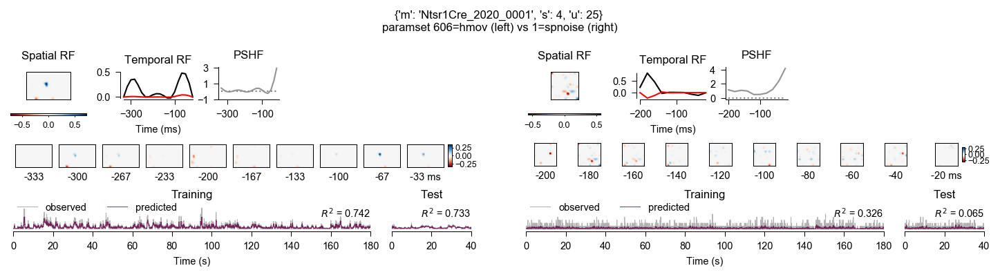

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 6, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [9 7]
  hmov RF QI: 0.985413
  hmov RF area: 2.93
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 6, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 9]
  hmov RF QI: 0.175915
  hmov RF area: 0.69


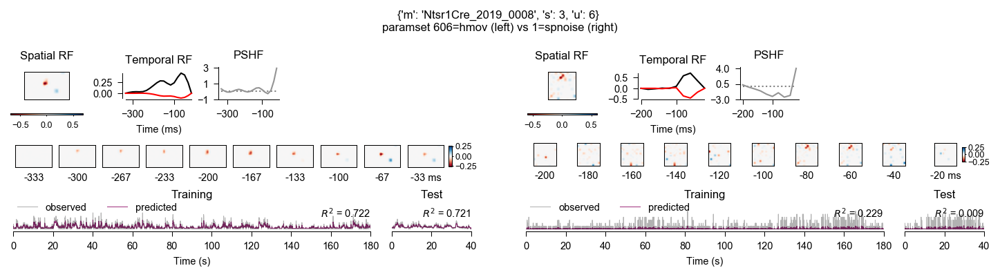

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 26, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  6]
  hmov RF QI: 0.885589
  hmov RF area: 3.3
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 26, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [1 4]
  hmov RF QI: 0.633849
  hmov RF area: 0.69


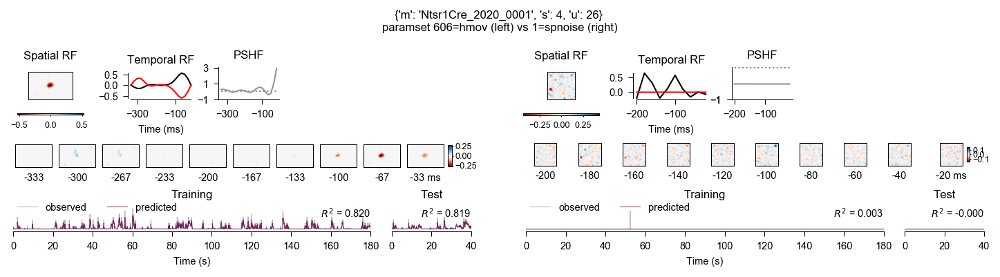

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 34, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  5]
  hmov RF QI: 0.85451
  hmov RF area: 5.86
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 34, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 5]
  hmov RF QI: 0.675486
  hmov RF area: 0.69


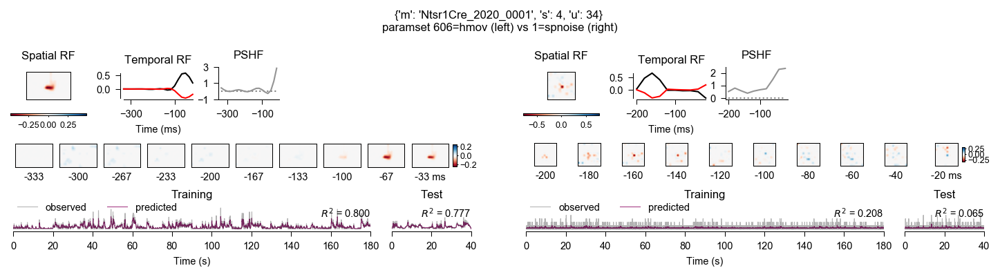

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 20, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  5]
  hmov RF QI: 0.528536
  hmov RF area: 1.1
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 20, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [8 4]
  hmov RF QI: 0.989999
  hmov RF area: 0.69


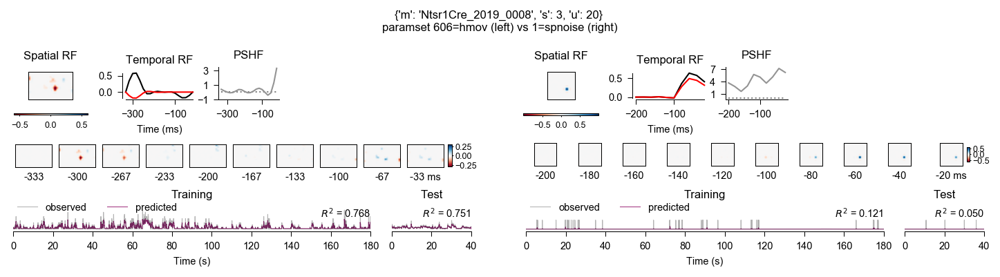

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 14, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  6]
  hmov RF QI: 0.986405
  hmov RF area: 1.83
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 14, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 6]
  hmov RF QI: 0.818438
  hmov RF area: 1.39


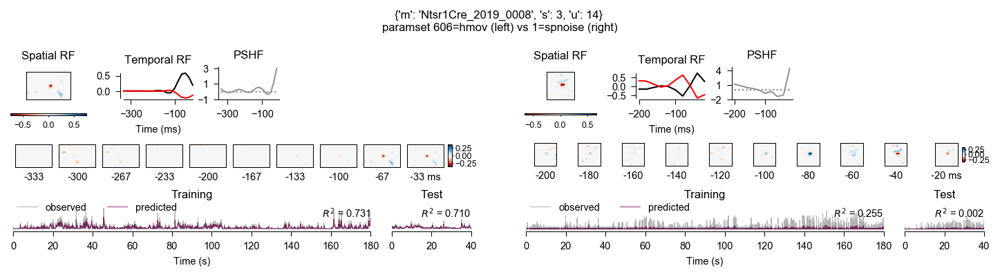

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 16, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [20  4]
  hmov RF QI: 0.23737
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 16, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [ 7 10]
  hmov RF QI: 0.437795
  hmov RF area: 0.69


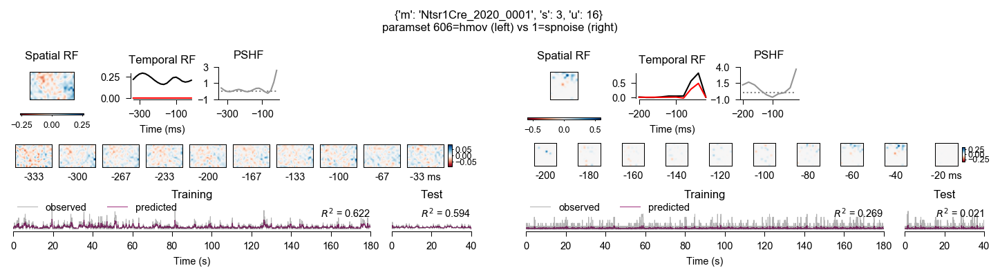

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 39, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [15  3]
  hmov RF QI: 0.0376722
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 1, 'u': 39, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [11  5]
  hmov RF QI: 0.341439
  hmov RF area: 0.69


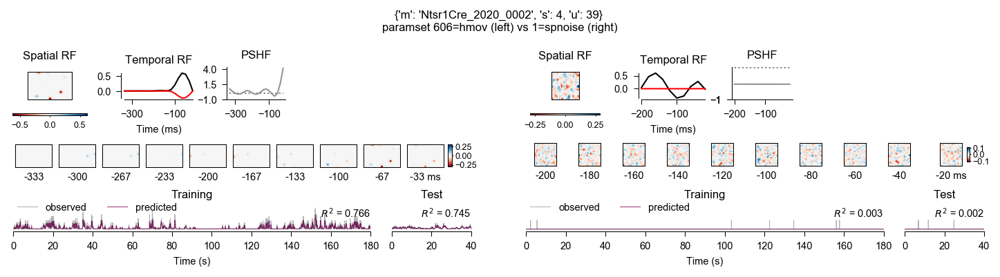

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 34, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  2]
  hmov RF QI: 0.982426
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 34, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [8 2]
  hmov RF QI: 0.929061
  hmov RF area: 2.78


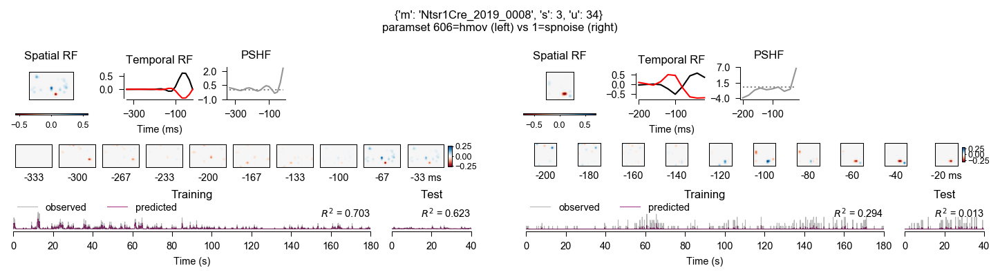

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 41, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [9 0]
  hmov RF QI: 0.987644
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 41, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 2]
  hmov RF QI: 0.232542
  hmov RF area: 0.69


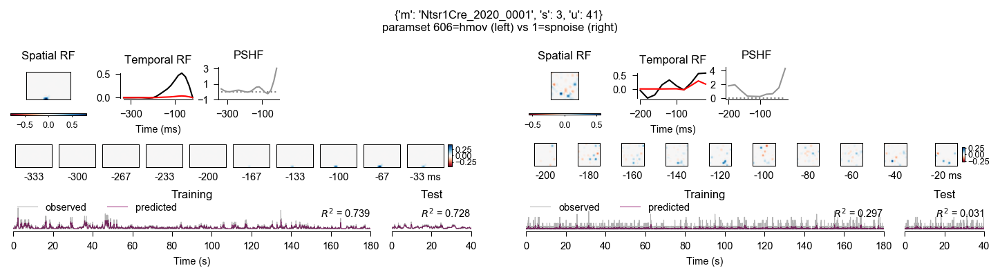

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 12, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [9 9]
  hmov RF QI: 0.825501
  hmov RF area: 5.86
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 12, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [7 1]
  hmov RF QI: 0.95996
  hmov RF area: 0.69


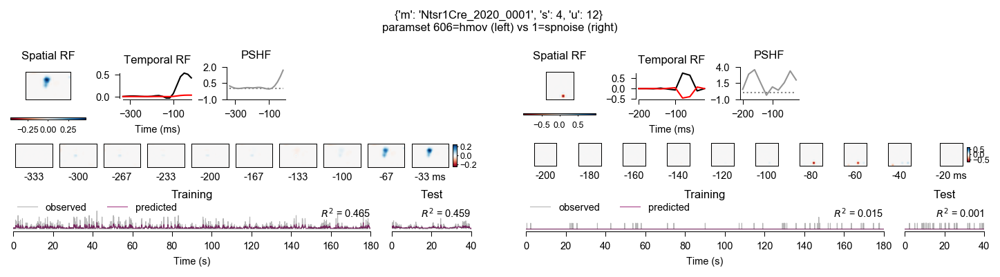

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 37, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [19  0]
  hmov RF QI: 0.123017
  hmov RF area: 0.0
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 37, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 2]
  hmov RF QI: 0.816421
  hmov RF area: 1.39


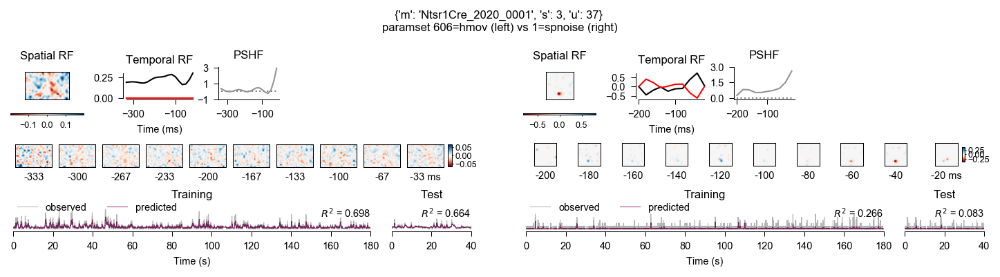

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 6, 'u': 20, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  2]
  hmov RF QI: 0.967526
  hmov RF area: 1.47
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 3, 'e': 1, 'u': 20, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 4]
  hmov RF QI: 0.701327
  hmov RF area: 0.69


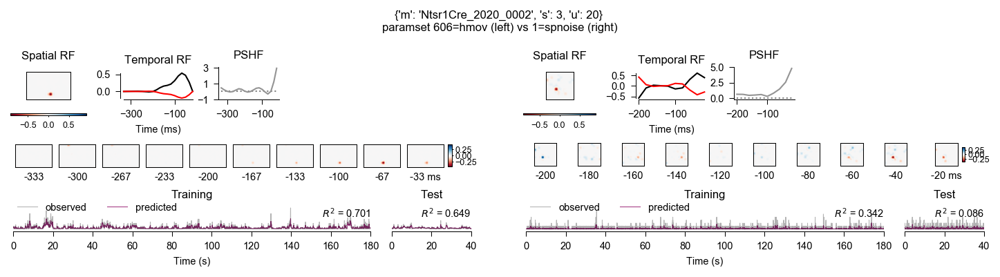

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 61, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [4 0]
  hmov RF QI: 0.0693871
  hmov RF area: 0.0
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 1, 'u': 61, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [7 2]
  hmov RF QI: 0.508559
  hmov RF area: 0.69


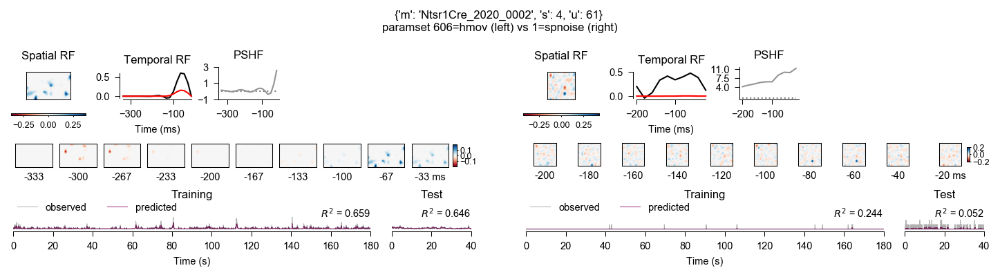

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 35, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [20  0]
  hmov RF QI: 0.989995
  hmov RF area: 0.0
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 35, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [2 5]
  hmov RF QI: 0.614828
  hmov RF area: 0.69


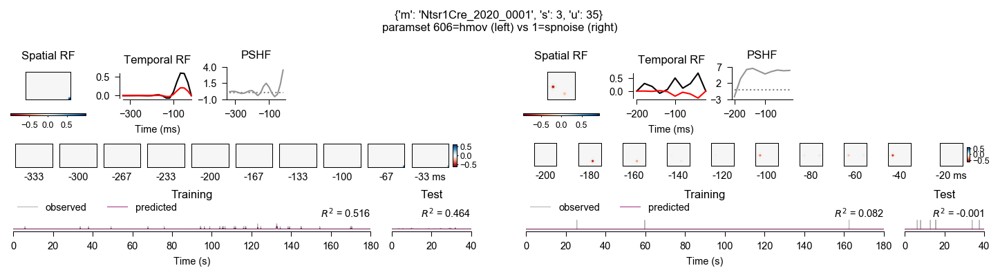

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 6, 'u': 16, 'spl_paramset': 606, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [20  4]
  hmov RF QI: 0.23737
  hmov RF area: 0.37
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 1, 'u': 16, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [ 7 10]
  hmov RF QI: 0.437795
  hmov RF area: 0.69


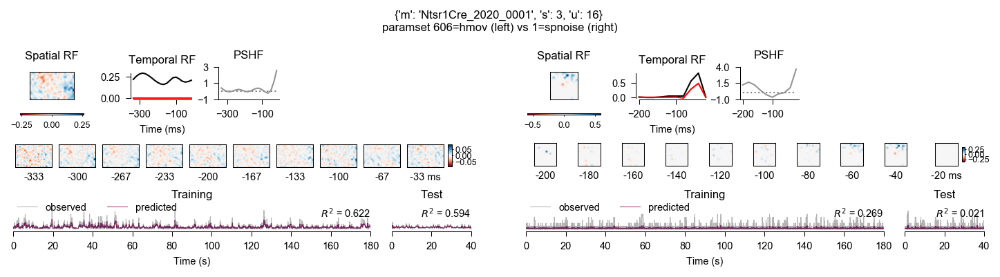

In [22]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 606').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
# df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
units = units.sort_values('spl_r_test', ascending=False)

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=30).iterrows():    
    unit = unit[['m','s','u']]
    unit = unit.to_dict()
    
    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # Plot 606 hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 606}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[0])
        print(f'hmov key: {key}')
        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')

    # Plot 1 model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise', 'spl_paramset': 1}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'hmov key: {key}')
        
        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov  RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')
    fig.suptitle(f'{unit} \nparamset 606=hmov (left) vs 1=spnoise (right)', fontsize=8)

    plt.show()

## Check different spnoise paramsets

In [7]:
1/144

0.006944444444444444

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 19, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [2 5]
  hmov RF QI: 0.987832
  hmov RF area: 2.78
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 19, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [2 5]
  hmov RF QI: 0.98674
  hmov RF area: 2.08


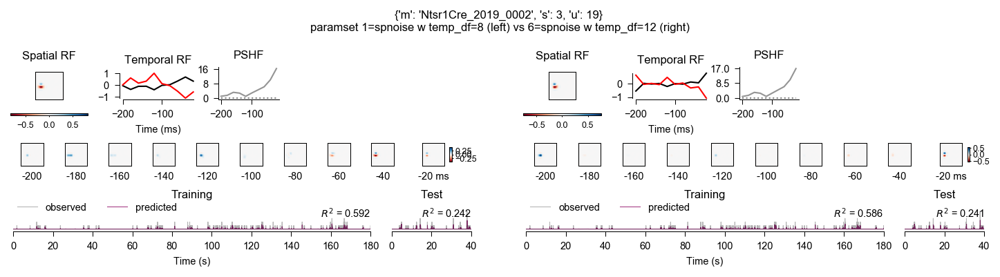

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 59, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [0 0]
  hmov RF QI: 0.989963
  hmov RF area: 0.0
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 59, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [0 0]
  hmov RF QI: 0.37704
  hmov RF area: 0.0


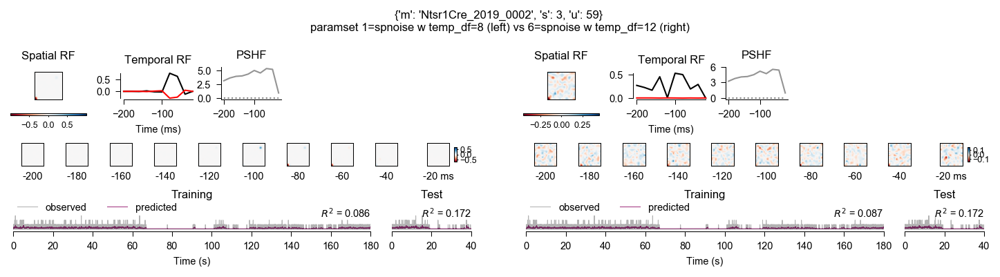

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'e': 1, 'u': 78, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [6 6]
  hmov RF QI: 0.979978
  hmov RF area: 0.69
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'e': 1, 'u': 78, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [10  5]
  hmov RF QI: 0.223954
  hmov RF area: 0.69


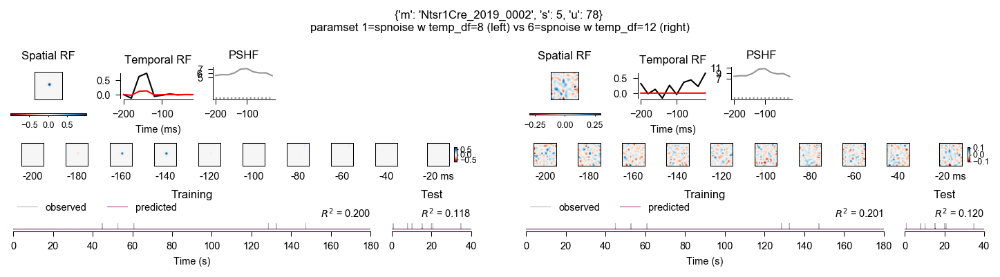

hmov key: {'m': 'Ntsr1Cre_2019_0003', 's': 4, 'e': 1, 'u': 6, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [2 6]
  hmov RF QI: 0.311521
  hmov RF area: 0.69
hmov key: {'m': 'Ntsr1Cre_2019_0003', 's': 4, 'e': 1, 'u': 6, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [2 6]
  hmov RF QI: 0.99
  hmov RF area: 0.69


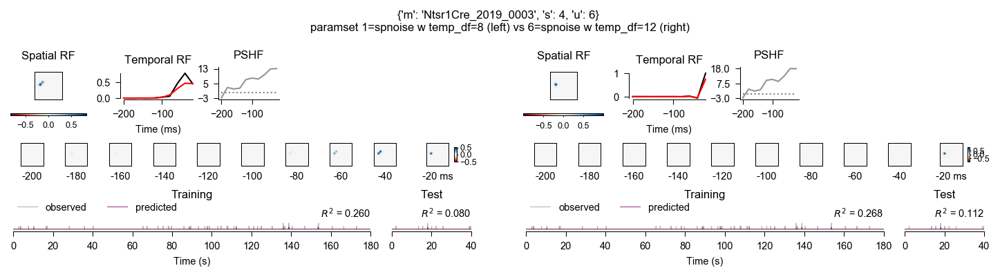

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 14, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [4 7]
  hmov RF QI: 0.950912
  hmov RF area: 2.78
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 14, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 7]
  hmov RF QI: 0.940573
  hmov RF area: 2.78


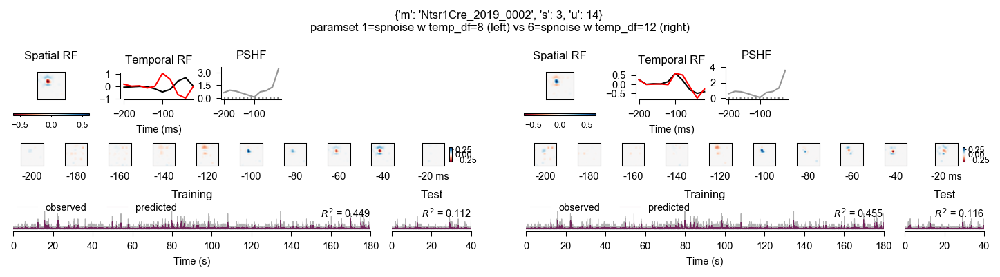

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'e': 1, 'u': 72, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [1 5]
  hmov RF QI: 0.264489
  hmov RF area: 0.69
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'e': 1, 'u': 72, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [2 4]
  hmov RF QI: 0.875813
  hmov RF area: 1.39


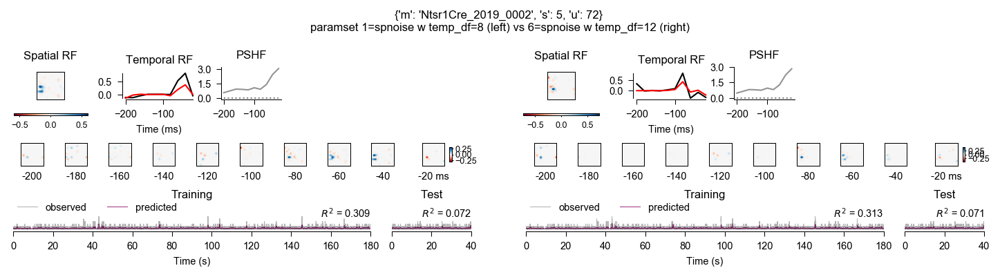

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 13, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [6 8]
  hmov RF QI: 0.934369
  hmov RF area: 3.47
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 13, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 8]
  hmov RF QI: 0.950075
  hmov RF area: 5.56


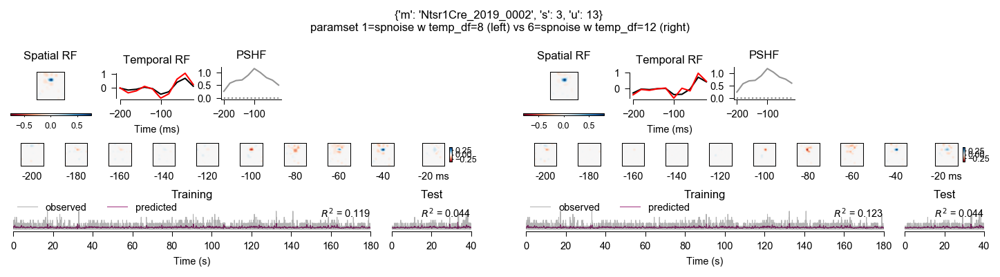

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'e': 1, 'u': 62, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [7 0]
  hmov RF QI: 0.103751
  hmov RF area: 0.0
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'e': 1, 'u': 62, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 8]
  hmov RF QI: 0.378187
  hmov RF area: 0.69


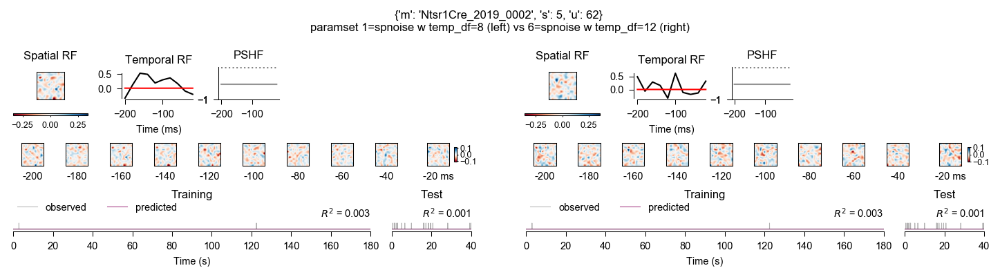

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 40, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [3 2]
  hmov RF QI: 0.945085
  hmov RF area: 2.78
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 40, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 2]
  hmov RF QI: 0.989886
  hmov RF area: 2.78


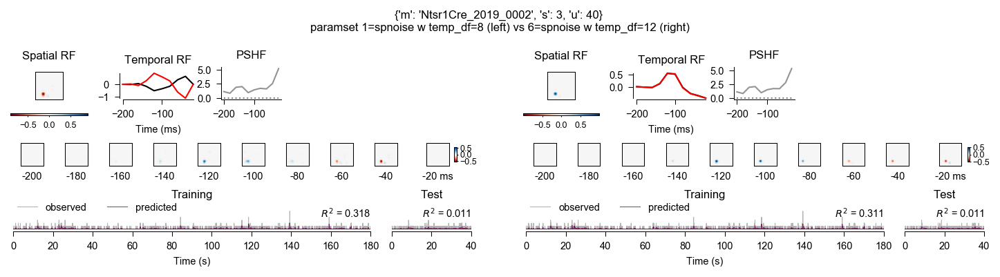

hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 30, 'spl_paramset': 1, 'spl_stim': 'spnoise'}
  hmov RF pos (x,y): [3 3]
  hmov RF QI: 0.96011
  hmov RF area: 2.08
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 30, 'spl_paramset': 6, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 3]
  hmov RF QI: 0.986453
  hmov RF area: 1.39


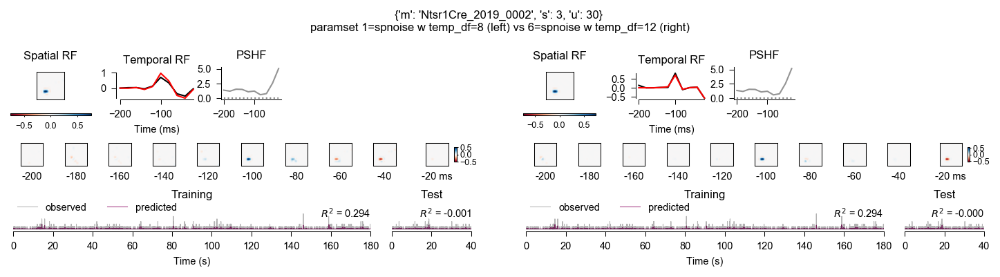

In [28]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 6').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
# df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
units = units.sort_values('spl_r_test', ascending=False)

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=10).iterrows():    
    unit = unit[['m','s','u']]
    unit = unit.to_dict()
    
    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # Plot 606 hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise', 'spl_paramset': 1}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[0])
        print(f'hmov key: {key}')
        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')

    # Plot 1 model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise', 'spl_paramset': 6}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'hmov key: {key}')
        
        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov  RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')
    fig.suptitle(f'{unit} \nparamset 1=spnoise w temp_df=8 (left) vs 6=spnoise w temp_df=12 (right)', fontsize=8)

    plt.show()

## Check model plot and RF area, RF QI and RF pos after upscaling sRF for get_rf_area() and get-rf_qi

[autoreload of djd.glms failed: Traceback (most recent call last):
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj): continue
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/Users/ybauer/miniconda3/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj)

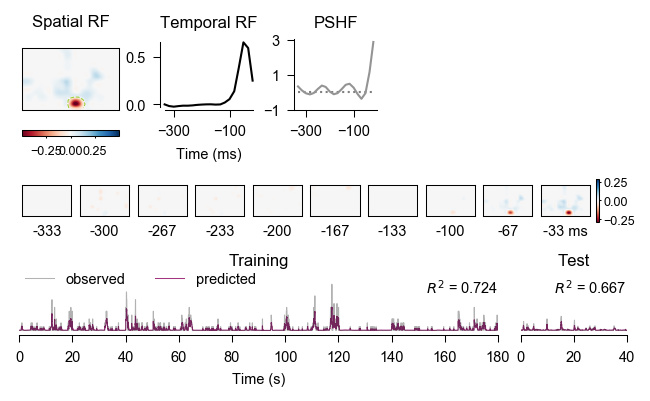

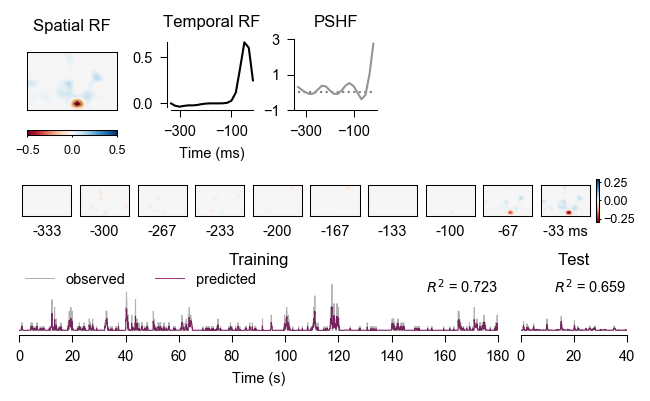

In [10]:
key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 601}).fetch(dj.key)[0]
fig, axs = plot_model(key, title=False)
key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 607}).fetch(dj.key)[0]
fig, axs = plot_model(key, title=False)

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 8, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [16  9]
  hmov RF QI: 0.950669
  hmov RF area: 6.75
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 8, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [16  9]
  hmov RF QI: 0.955595
  hmov RF area: 471.752


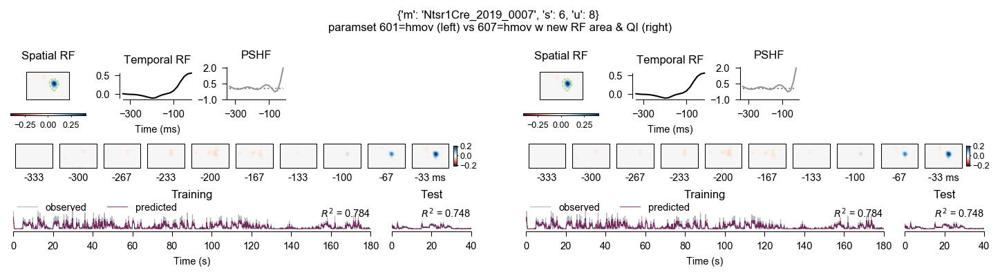

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 5, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [ 0 11]
  hmov RF QI: 0.954054
  hmov RF area: 0.75
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 5, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [ 0 11]
  hmov RF QI: 0.952843
  hmov RF area: 83.0775


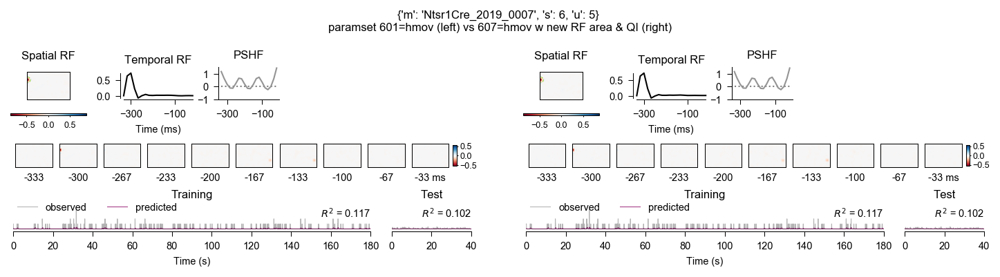

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 7, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13 10]
  hmov RF QI: 0.689766
  hmov RF area: 1.75
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 7, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [13 10]
  hmov RF QI: 0.679051
  hmov RF area: 136.367


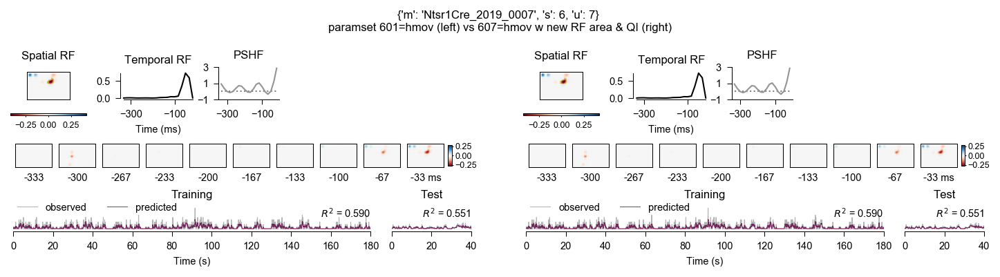

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 4, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [14  5]
  hmov RF QI: 0.128857
  hmov RF area: 0.5
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 4, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [13  5]
  hmov RF QI: 0.492027
  hmov RF area: 221.904


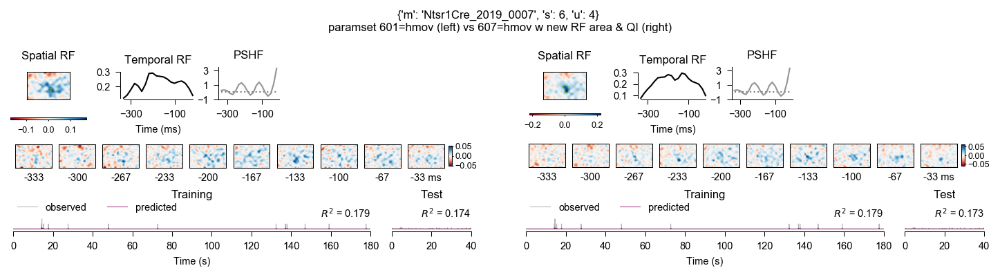

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 9, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [23 11]
  hmov RF QI: 0.557356
  hmov RF area: 0.75
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 9, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [23 11]
  hmov RF QI: 0.487167
  hmov RF area: 45.638


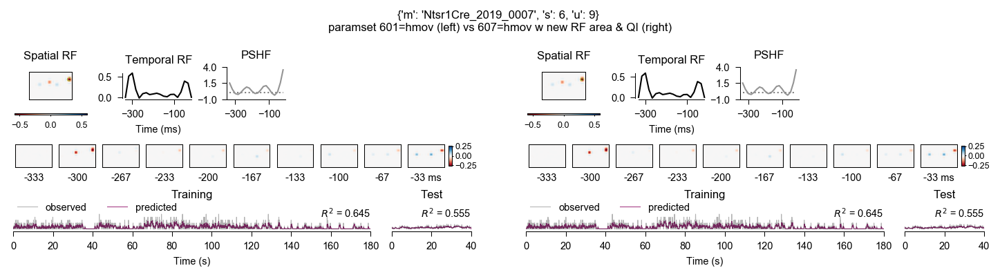

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [13  1]
  hmov RF QI: 0.959549
  hmov RF area: 2.0
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [13  1]
  hmov RF QI: 0.450086
  hmov RF area: 57.4474


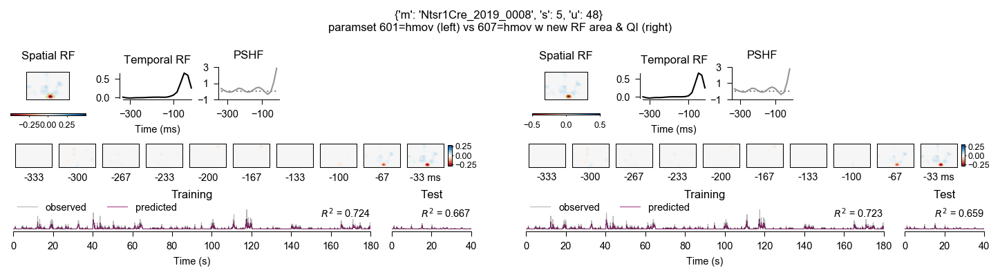

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 3, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [23  1]
  hmov RF QI: 0.42459
  hmov RF area: 0.75
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 3, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [23  1]
  hmov RF QI: 0.257229
  hmov RF area: 22.7507


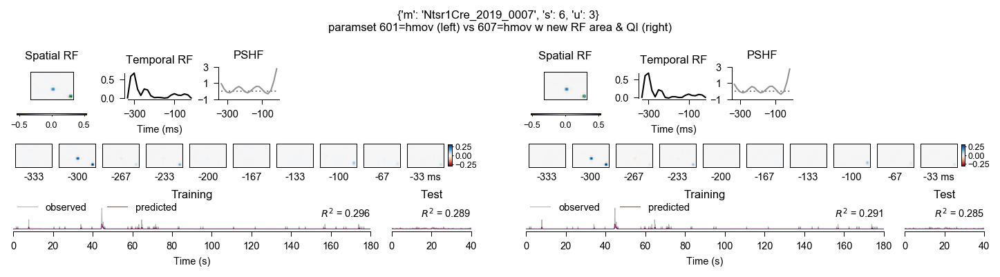

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 1, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [21  8]
  hmov RF QI: 0.257913
  hmov RF area: 0.25
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 1, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [21  8]
  hmov RF QI: 0.256648
  hmov RF area: 14.6205


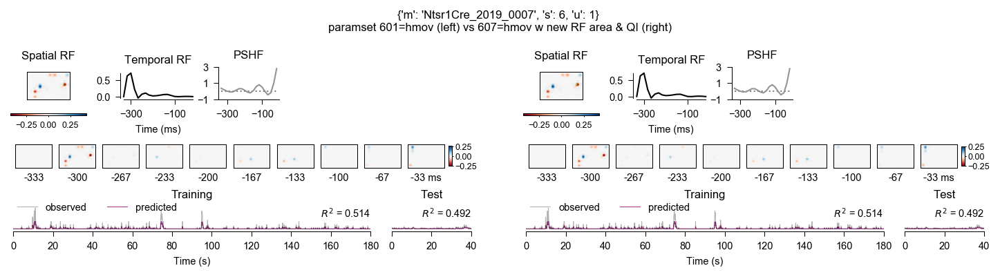

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 2, 'spl_paramset': 601, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [20  8]
  hmov RF QI: 0.0925195
  hmov RF area: 0.25
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 2, 'spl_paramset': 607, 'spl_stim': 'hmov'}
  hmov  RF pos (x,y): [20  7]
  hmov RF QI: 0.226159
  hmov RF area: 25.2785


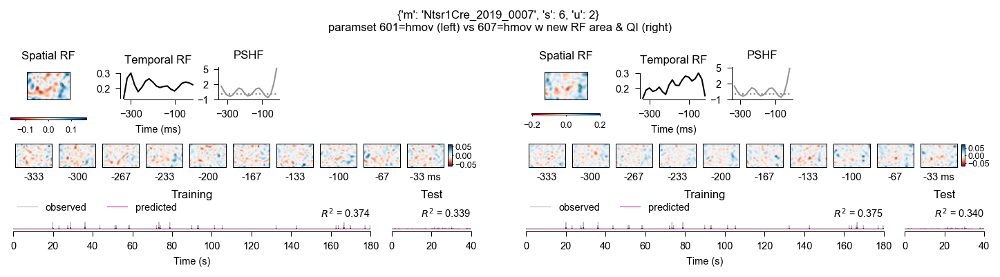

In [5]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 607').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
# df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
units = units.sort_values('spl_rf_qi', ascending=False)

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=30).iterrows():    
    unit = unit[['m','s','u']]
    unit = unit.to_dict()
    
    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # Plot 601 hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 601}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder
    else:
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[0])
        print(f'hmov key: {key}')
        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')

    # Plot 607 hmov model
    key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 607}).fetch(dj.key)[0]
    if len(key) == 0:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    else:        
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'hmov key: {key}')
        
        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov  RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')
    fig.suptitle(f'{unit} \nparamset 601=hmov (left) vs 607=hmov w new RF area & QI (right)', fontsize=8)

    plt.show()

## Compare hmov vs spnoise area on models with matched spatial df and stimulus scaling (new get_rf_area() method w upscaled images and in deg2)
TODO: simply replace 606>608 and 1>7

### Plot hmov vs spnoise model unit by unit

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 6, 'u': 40, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [8 5]
  hmov RF QI: 0.917279
  hmov RF area: 161.666
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 6, 'e': 3, 'u': 40, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 4]
  hmov RF QI: 0.993972
  hmov RF area: 96.0582


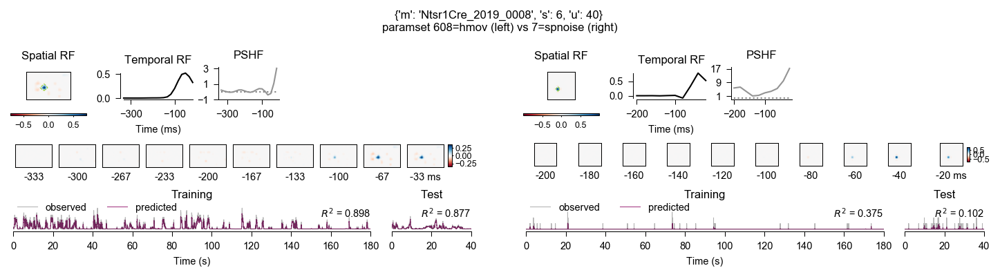

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'u': 21}.
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'u': 21}.


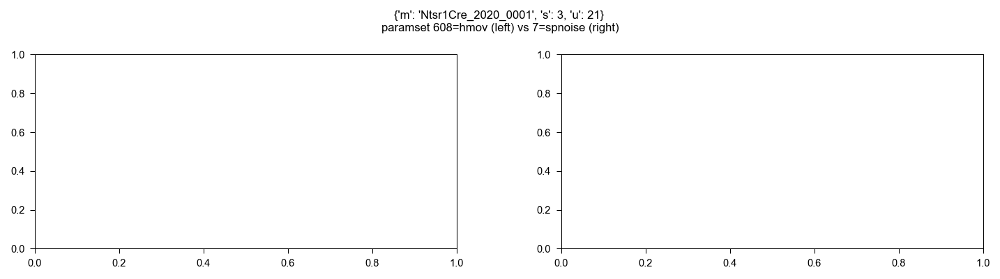

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 6, 'u': 40, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  4]
  hmov RF QI: 0.991696
  hmov RF area: 191.297
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 4, 'e': 1, 'u': 40, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 5]
  hmov RF QI: 0.993971
  hmov RF area: 93.6152


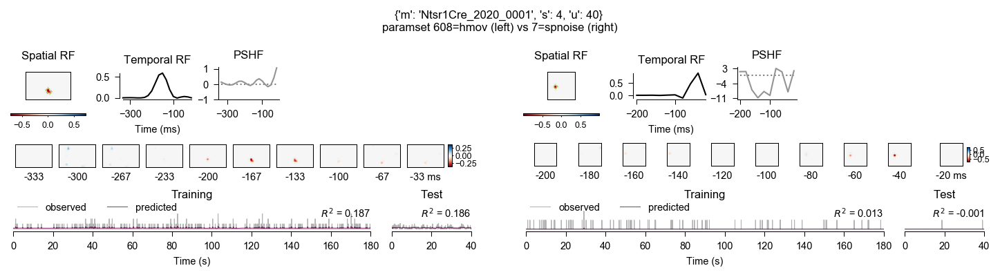

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 7, 'u': 20, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  5]
  hmov RF QI: 0.499911
  hmov RF area: 68.4808
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 3, 'e': 3, 'u': 20, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [8 4]
  hmov RF QI: 0.993971
  hmov RF area: 96.1559


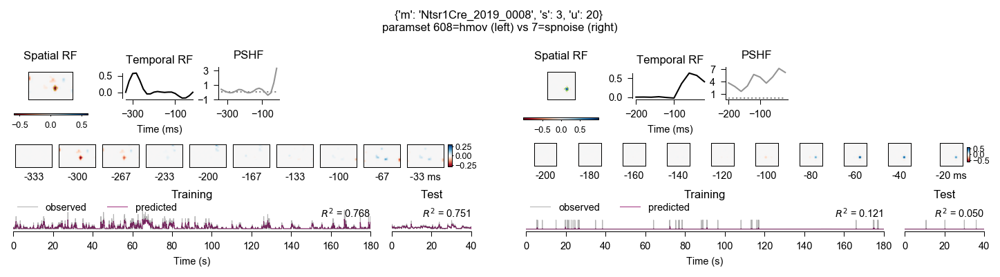

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 48, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  1]
  hmov RF QI: 0.30055
  hmov RF area: 20.1597
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 48, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 1]
  hmov RF QI: 0.993029
  hmov RF area: 178.338


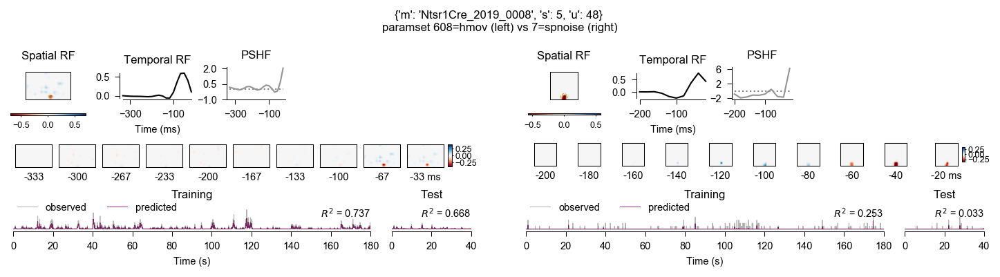

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 21, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  6]
  hmov RF QI: 0.682728
  hmov RF area: 225.394
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 21, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 9]
  hmov RF QI: 0.992966
  hmov RF area: 95.5696


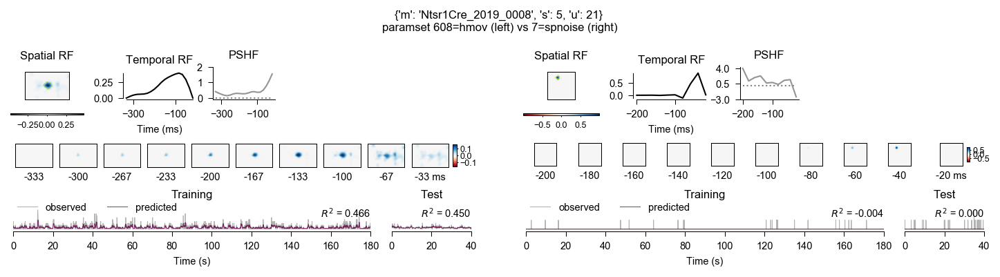

hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 96, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  8]
  hmov RF QI: 0.45869
  hmov RF area: 28.2291
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 96, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 3]
  hmov RF QI: 0.992964
  hmov RF area: 95.2765


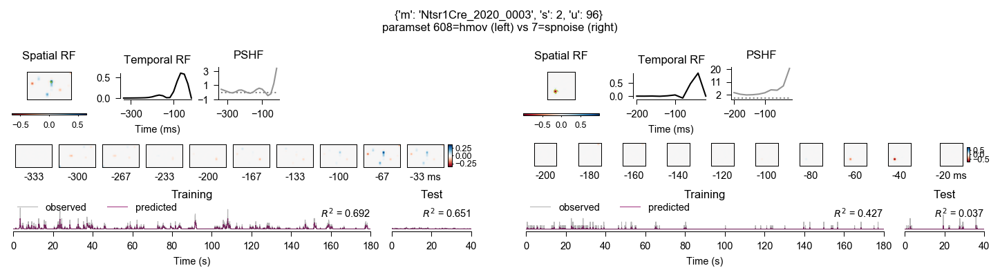

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8, 'u': 19, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  6]
  hmov RF QI: 0.671663
  hmov RF area: 150.367
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 3, 'u': 19, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 7]
  hmov RF QI: 0.992541
  hmov RF area: 144.332


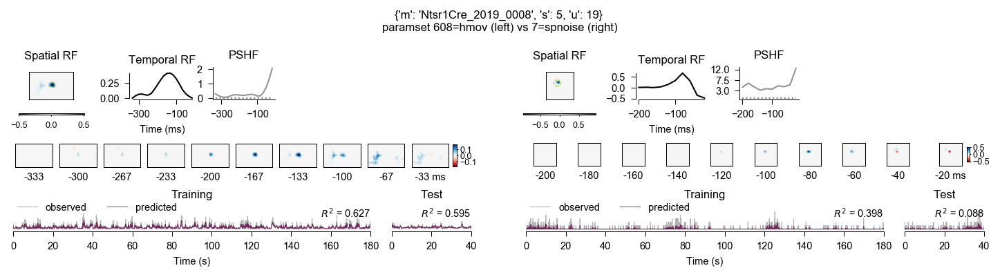

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 6, 'u': 29, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  5]
  hmov RF QI: 0.573364
  hmov RF area: 66.8688
hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 5, 'e': 1, 'u': 29, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 7]
  hmov RF QI: 0.99196
  hmov RF area: 93.4198


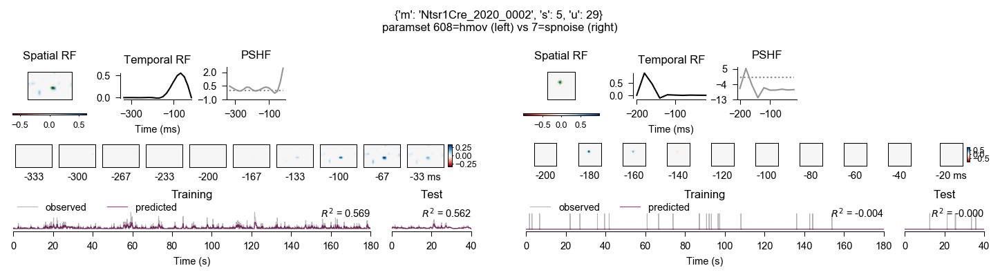

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 27, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  5]
  hmov RF QI: 0.151691
  hmov RF area: 46.648
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 27, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 0]
  hmov RF QI: 0.991951
  hmov RF area: 69.4785


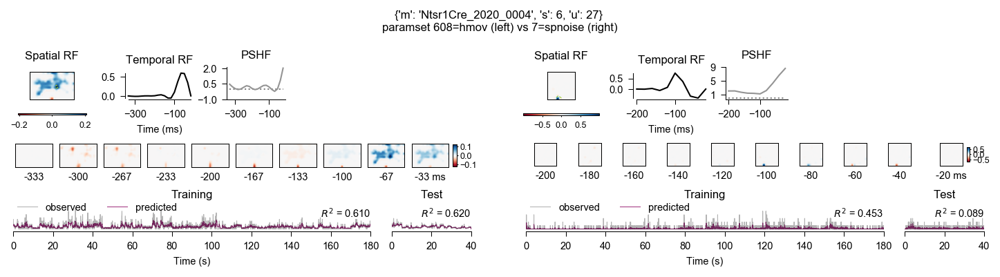

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 1, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [17  6]
  hmov RF QI: 0.592296
  hmov RF area: 31.6326
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 1, 'u': 1, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 9]
  hmov RF QI: 0.990955
  hmov RF area: 95.765


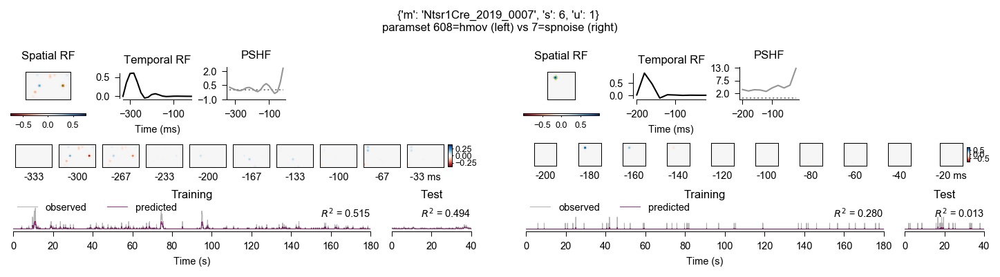

hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 10, 'u': 22, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  7]
  hmov RF QI: 0.905042
  hmov RF area: 742.264
hmov key: {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'e': 13, 'u': 22, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 7]
  hmov RF QI: 0.985466
  hmov RF area: 119.413


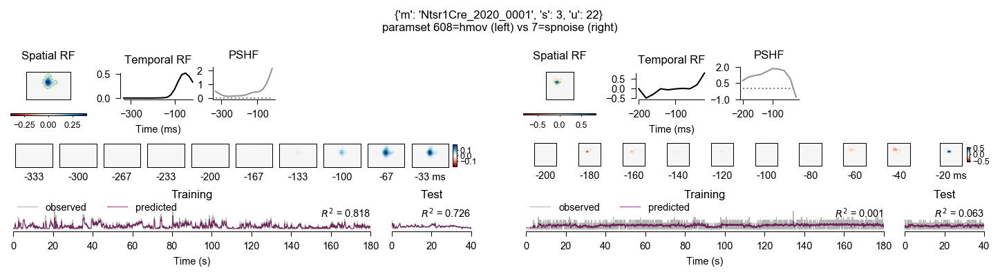

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'u': 6}.
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 1, 'u': 6, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [7 2]
  hmov RF QI: 0.984836
  hmov RF area: 87.4419


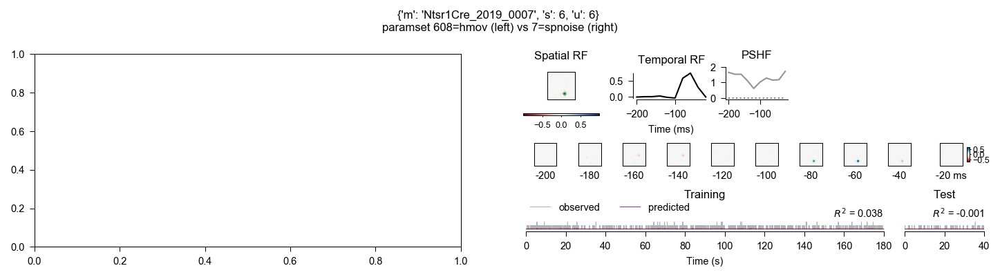

hmov key: {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'e': 8, 'u': 14, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [14  4]
  hmov RF QI: 0.990929
  hmov RF area: 97.7005
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2020_0002', 's': 4, 'u': 14}.


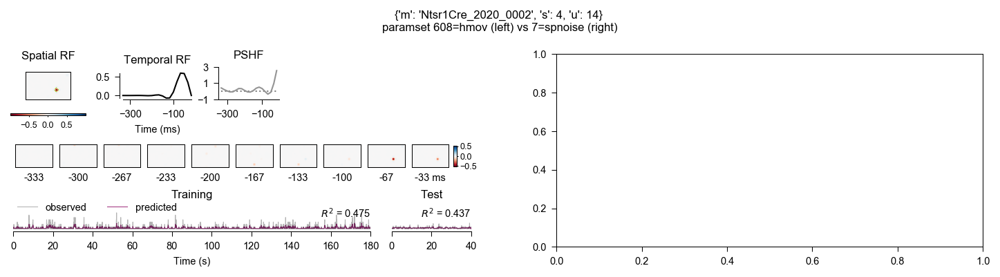

hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 26, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  6]
  hmov RF QI: 0.698059
  hmov RF area: 58.0598
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 26, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 5]
  hmov RF QI: 0.981228
  hmov RF area: 237.263


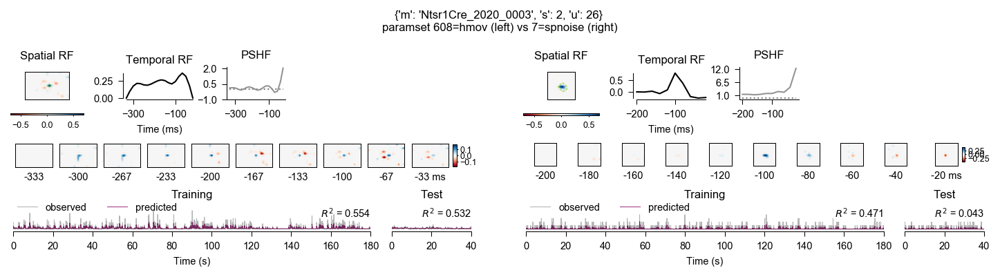

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'u': 20}.
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'u': 20}.


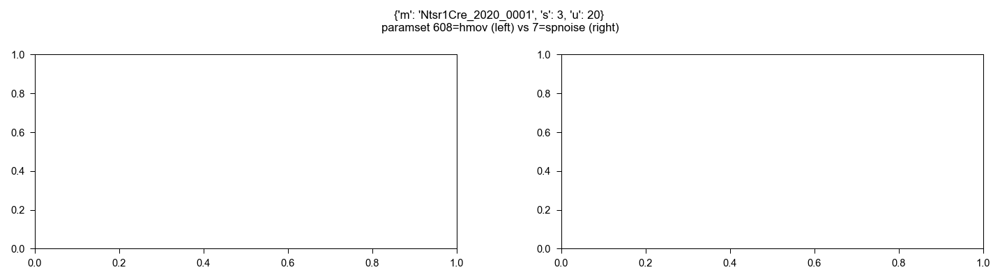

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'u': 78}.
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 5, 'e': 1, 'u': 78, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 6]
  hmov RF QI: 0.979883
  hmov RF area: 85.2114


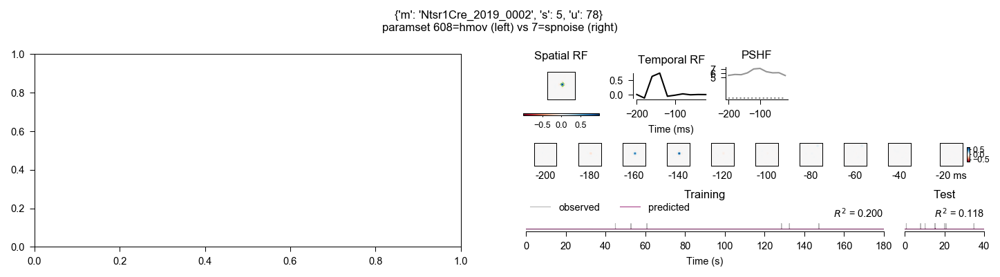

hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 9, 'u': 4, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [11  4]
  hmov RF QI: 0.929049
  hmov RF area: 93.8966
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 6, 'e': 1, 'u': 4, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [7 3]
  hmov RF QI: 0.974701
  hmov RF area: 83.4272


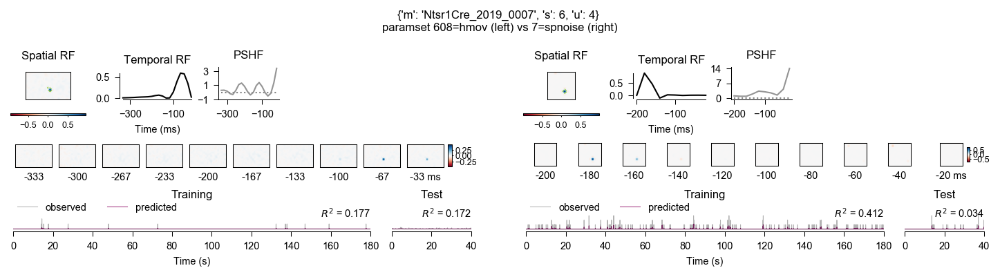

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 2, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [17  7]
  hmov RF QI: 0.945856
  hmov RF area: 106.61
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 2, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [0 5]
  hmov RF QI: 0.971739
  hmov RF area: 64.3971


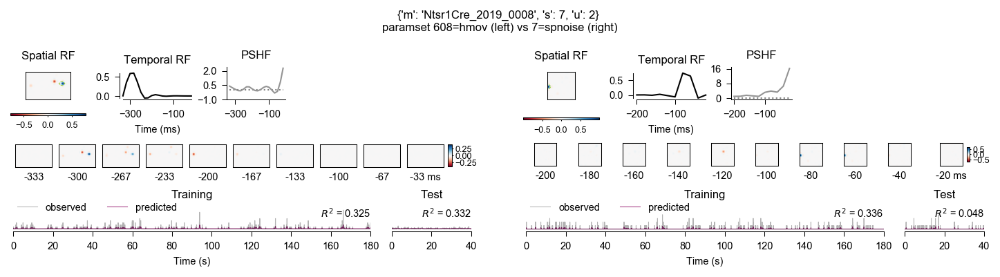

hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 6, 'u': 3, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [19  5]
  hmov RF QI: 0.542677
  hmov RF area: 26.227
hmov key: {'m': 'Ntsr1Cre_2019_0008', 's': 7, 'e': 3, 'u': 3, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [11  6]
  hmov RF QI: 0.967583
  hmov RF area: 59.9997


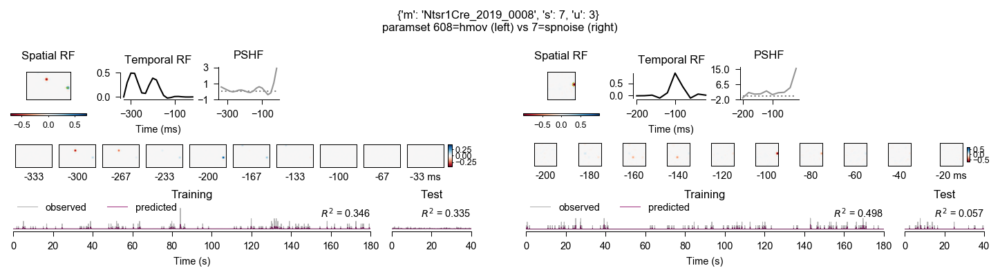

hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 17, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [9 4]
  hmov RF QI: 0.815026
  hmov RF area: 144.449
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 17, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [6 4]
  hmov RF QI: 0.966227
  hmov RF area: 321.595


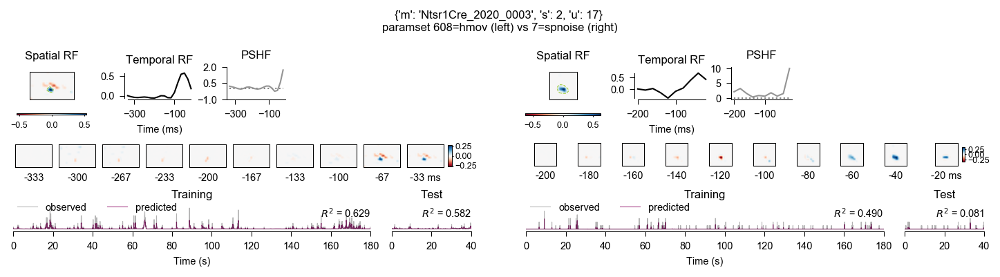

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0003', 's': 4, 'u': 7}.
hmov key: {'m': 'Ntsr1Cre_2019_0003', 's': 4, 'e': 1, 'u': 7, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 6]
  hmov RF QI: 0.965921
  hmov RF area: 58.9248


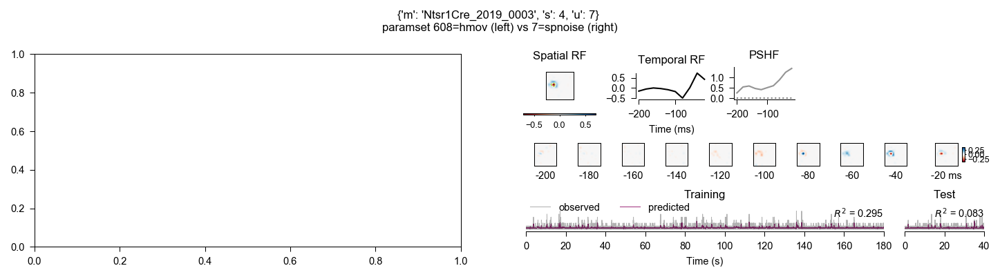

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0007', 's': 4, 'u': 20}.
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 4, 'e': 1, 'u': 20, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [9 4]
  hmov RF QI: 0.964893
  hmov RF area: 81.0635


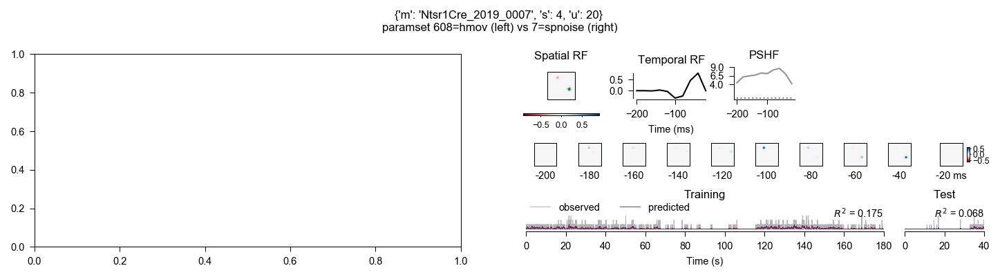

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'u': 30}.
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 30, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [3 3]
  hmov RF QI: 0.96277
  hmov RF area: 123.517


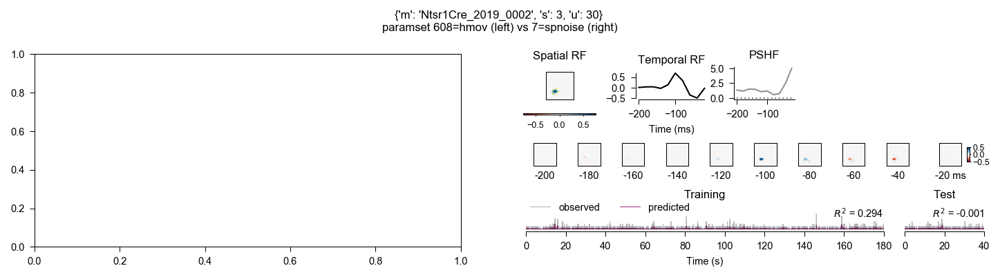

hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 12, 'u': 144, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [6 6]
  hmov RF QI: 0.16954
  hmov RF area: 8.20845
hmov key: {'m': 'Ntsr1Cre_2020_0003', 's': 2, 'e': 10, 'u': 144, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [ 4 11]
  hmov RF QI: 0.962643
  hmov RF area: 82.7684


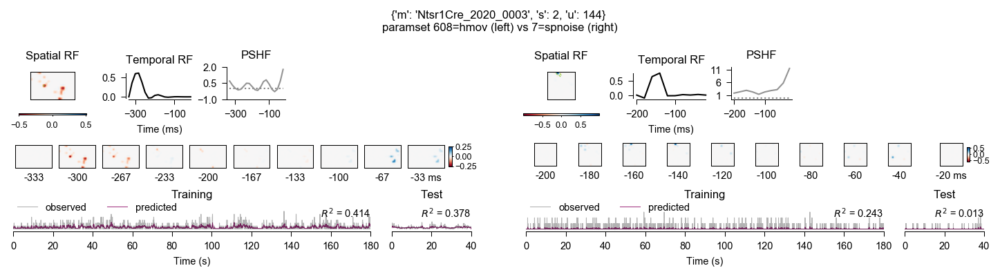

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'u': 14}.
hmov key: {'m': 'Ntsr1Cre_2019_0002', 's': 3, 'e': 1, 'u': 14, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [4 7]
  hmov RF QI: 0.962366
  hmov RF area: 123.029


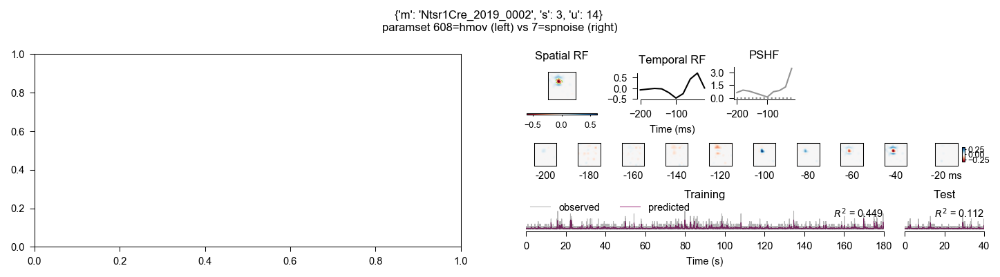

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 52, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [10  6]
  hmov RF QI: 0.544854
  hmov RF area: 133.537
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 52, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [5 7]
  hmov RF QI: 0.961437
  hmov RF area: 80.6185


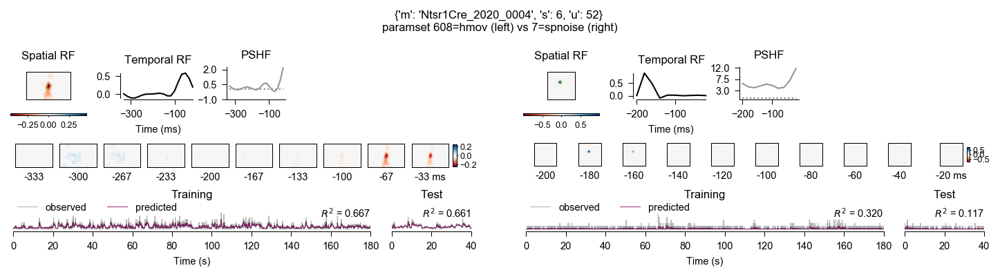

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'u': 13}.
No spnoise-SplineLNP model for {'m': 'Ntsr1Cre_2020_0001', 's': 3, 'u': 13}.


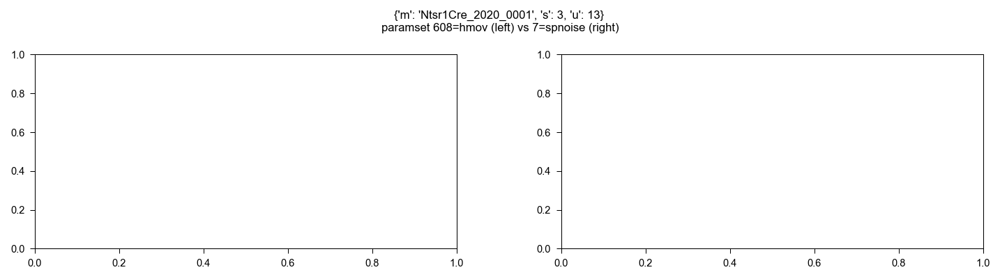

hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 10, 'u': 66, 'spl_paramset': 608, 'spl_stim': 'hmov'}
  hmov RF pos (x,y): [12  6]
  hmov RF QI: 0.217065
  hmov RF area: 39.4406
hmov key: {'m': 'Ntsr1Cre_2020_0004', 's': 6, 'e': 9, 'u': 66, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [8 9]
  hmov RF QI: 0.95652
  hmov RF area: 79.8368


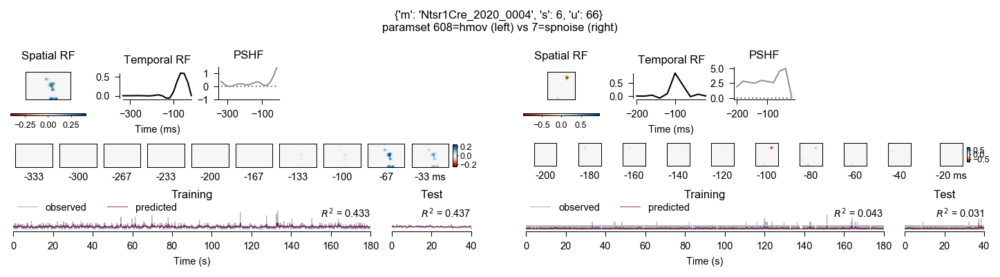

No hmov-SplineLNP model for {'m': 'Ntsr1Cre_2019_0007', 's': 4, 'u': 47}.
hmov key: {'m': 'Ntsr1Cre_2019_0007', 's': 4, 'e': 1, 'u': 47, 'spl_paramset': 7, 'spl_stim': 'spnoise'}
  hmov  RF pos (x,y): [11  2]
  hmov RF QI: 0.956166
  hmov RF area: 52.9693


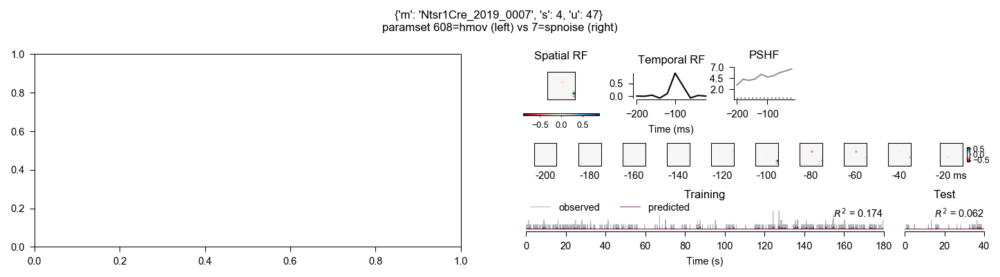

In [16]:
# Get units with Hmov recording and SplinelNP model
units = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 7').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
# df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
units = units.sort_values('spl_rf_qi', ascending=False)

# Plot best hmov vs spnoise model per unit
for i, unit in units.head(n=30).iterrows():    
    unit = unit[['m','s','u']]
    unit = unit.to_dict()
    
    # Initialize figure (per unit)
    fig = plt.figure(figsize=cm2inch((24, 6.5)), dpi=150, constrained_layout=True)  # need to set constrained layout here!
    gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig, width_ratios=[1, 0.1, 1])  # 2nd column just for subfig spacing

    # Plot hmov model
    try:
        key = (SplineLNP.Eval() & unit & {'spl_stim': 'hmov', 'spl_paramset': 608}).fetch1(dj.key)
#         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[0])
        print(f'hmov key: {key}')
        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')        
    except:
        print(f'No hmov-SplineLNP model for {unit}.')
        fig.add_subplot(gs[0])  # placeholder


    # Plot other model
    try:
        key = (SplineLNP.Eval() & unit & {'spl_stim': 'spnoise', 'spl_paramset': 7}).fetch1(dj.key)#[0]
#         if len(key) == 0:
#             print(f'No spnoise-SplineLNP model for {unit}.')
#             fig.add_subplot(gs[2])  # placeholder
#         else:        
    #         key = get_best_model(key, crit='spl_r2_test', key_only=True, format='dict')  # picks best model
        fig, axs = plot_model(key, title=False, gs=gs[2])
        print(f'hmov key: {key}')

        rf_pos, rf_qi, rf_area = (SplineLNP.Eval() & key).fetch1('spl_rf_pos_pix',  'spl_rf_qi', 'spl_rf_area')  # test print rf pos to check top-down LGN RF progression
        print(f'  hmov  RF pos (x,y): {rf_pos}')
        print(f'  hmov RF QI: {rf_qi}')
        print(f'  hmov RF area: {rf_area}')        
    except:
        print(f'No spnoise-SplineLNP model for {unit}.')
        fig.add_subplot(gs[2])  # placeholder
    fig.suptitle(f'{unit} \nparamset 608=hmov (left) vs 7=spnoise (right)', fontsize=8)

    plt.show()

### Check stats of hmov vs spnoise models

In [17]:
df = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 7 OR spl_paramset = 608' & 'spl_rf_qi > 0.2').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df.columns = df.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)
df

,m,s,e,u,paramset,stim,r_test,rf_qi,rf_area
0,Ntsr1Cre_2019_0002,3,1,13,7,spnoise,0.209741,0.938307,134.7550
1,Ntsr1Cre_2019_0002,3,1,14,7,spnoise,0.334790,0.962366,123.0290
2,Ntsr1Cre_2019_0002,3,1,19,7,spnoise,0.492860,0.884405,103.6800
3,Ntsr1Cre_2019_0002,3,1,30,7,spnoise,0.093234,0.962770,123.5170
4,Ntsr1Cre_2019_0002,3,1,40,7,spnoise,0.126494,0.882482,92.3449
...,...,...,...,...,...,...,...,...,...
403,Ntsr1Cre_2020_0004,6,10,42,608,hmov,0.944451,0.440856,371.5820
404,Ntsr1Cre_2020_0004,6,10,48,608,hmov,0.913756,0.771595,204.8110
405,Ntsr1Cre_2020_0004,6,10,52,608,hmov,0.888656,0.544854,133.5370
406,Ntsr1Cre_2020_0004,6,10,66,608,hmov,0.827259,0.217065,39.4406


            r_test                     rf_qi                     rf_area                  
              mean       std count      mean       std count        mean         std count
paramset                                                                                  
7         0.188350  0.118222   232  0.614361  0.252186   232   55.196865   53.918344   232
608       0.851068  0.119411   176  0.702562  0.268992   176  170.002898  160.514188   176


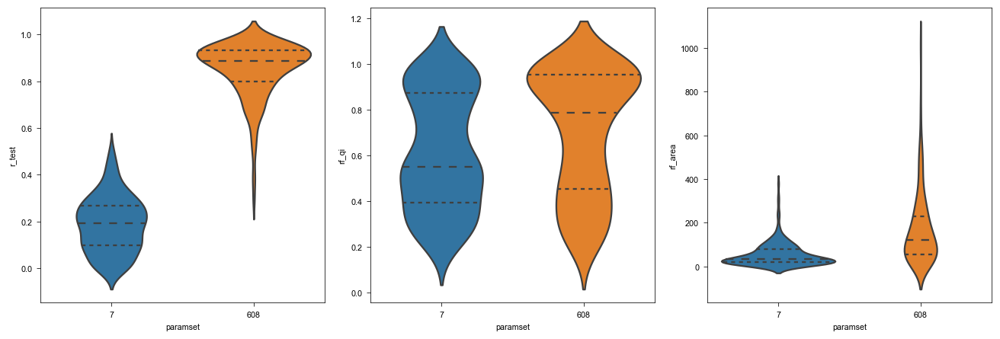

In [18]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=cm2inch((30,10)), dpi=110, constrained_layout=True)

sns.violinplot(data=df, x='paramset', y='r_test', inner='quartile', ax=axs[0])
# sns.swarmplot(data=df, x='paramset', y='r_test', color='white', edgecolor='gray', alpha=0.5, size=3.5, ax=axs)
# sns.kdeplot(data=df, y='paramset', hue='r_test', ax=axs)
sns.violinplot(data=df, x='paramset', y='rf_qi', inner='quartile', ax=axs[1])
sns.violinplot(data=df, x='paramset', y='rf_area', inner='quartile', ax=axs[2])

print(df[['paramset', 'r_test', 'rf_qi', 'rf_area']].groupby('paramset').agg(['mean', 'std', 'count']))

            r_test                     rf_qi                     rf_area                  
              mean       std count      mean       std count        mean         std count
paramset                                                                                  
7         0.188350  0.118222   232  0.614361  0.252186   232   55.196865   53.918344   232
608       0.851068  0.119411   176  0.702562  0.268992   176  170.002898  160.514188   176


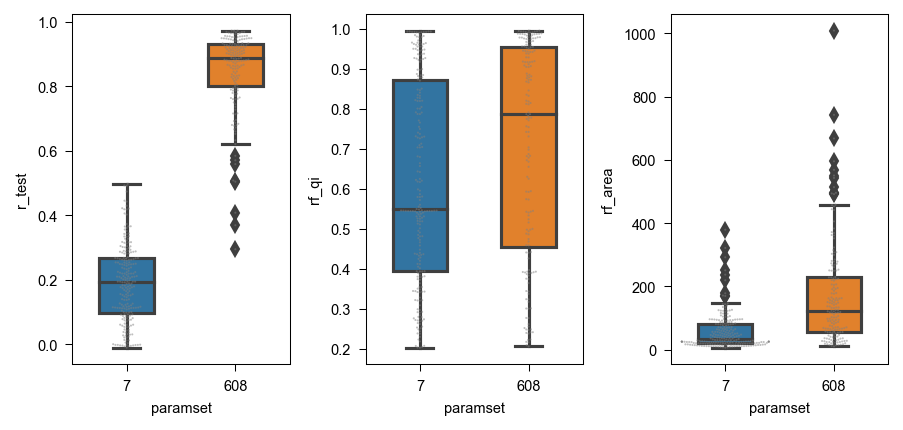

In [19]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=cm2inch((15,7)), dpi=150, constrained_layout=True)

sns.boxplot(data=df, x='paramset', y='r_test', width=0.5, ax=axs[0])
sns.swarmplot(data=df, x='paramset', y='r_test', color='grey', edgecolor='gray', alpha=0.5, size=1, ax=axs[0])
# sns.kdeplot(data=df, y='paramset', hue='r_test', ax=axs)
sns.boxplot(data=df, x='paramset', y='rf_qi', width=0.5, ax=axs[1])
sns.swarmplot(data=df, x='paramset', y='rf_qi', color='grey', edgecolor='gray', alpha=0.5, size=1, ax=axs[1])
sns.boxplot(data=df, x='paramset', y='rf_area', width=0.5, ax=axs[2])
sns.swarmplot(data=df, x='paramset', y='rf_area', color='grey', edgecolor='gray', alpha=0.5, size=1, ax=axs[2])

print(df[['paramset', 'r_test', 'rf_qi', 'rf_area']].groupby('paramset').agg(['mean', 'std', 'count']))

In [21]:
# For pairing data
df1 = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 608' & 'spl_rf_qi > 0.2').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df1.columns = df1.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)

df2 = pd.DataFrame((SplineLNP.Eval() & 'spl_paramset = 7' & 'spl_rf_qi > 0.2').fetch(dj.key, 'spl_r_test', 'spl_rf_qi', 'spl_rf_area', as_dict=True))
df2.columns = df2.columns.str.replace(r'spl_', '')  # rmv prefixes from column names (better than lstrip)

df = df1.merge(df2, on=['m','s','u'], how='inner')
df

,m,s,e_x,u,paramset_x,stim_x,r_test_x,rf_qi_x,rf_area_x,e_y,paramset_y,stim_y,r_test_y,rf_qi_y,rf_area_y
0,Ntsr1Cre_2019_0007,6,9,1,608,hmov,0.911555,0.592296,31.6326,1,7,spnoise,0.127284,0.990955,95.7650
1,Ntsr1Cre_2019_0007,6,9,3,608,hmov,0.840985,0.918184,76.1784,1,7,spnoise,0.249450,0.401356,18.1151
2,Ntsr1Cre_2019_0007,6,9,4,608,hmov,0.744896,0.929049,93.8966,1,7,spnoise,0.192854,0.974701,83.4272
3,Ntsr1Cre_2019_0007,6,9,8,608,hmov,0.909621,0.943766,441.4540,1,7,spnoise,0.113372,0.273588,16.8421
4,Ntsr1Cre_2019_0007,6,9,11,608,hmov,0.880063,0.979715,443.9570,1,7,spnoise,0.317847,0.544557,25.6548
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,Ntsr1Cre_2020_0004,6,10,42,608,hmov,0.944451,0.440856,371.5820,9,7,spnoise,0.262791,0.439987,21.0097
154,Ntsr1Cre_2020_0004,6,10,48,608,hmov,0.913756,0.771595,204.8110,9,7,spnoise,0.268281,0.393414,16.8077
155,Ntsr1Cre_2020_0004,6,10,52,608,hmov,0.888656,0.544854,133.5370,9,7,spnoise,0.342493,0.961437,80.6185
156,Ntsr1Cre_2020_0004,6,10,66,608,hmov,0.827259,0.217065,39.4406,9,7,spnoise,0.179620,0.956520,79.8368


In [22]:
df.iloc[:, 4::].describe()

,paramset_x,r_test_x,rf_qi_x,rf_area_x,e_y,paramset_y,r_test_y,rf_qi_y,rf_area_y
count,158.0,158.000000,158.000000,158.000000,158.000000,158.0,158.000000,158.000000,158.000000
mean,608.0,0.867209,0.699590,171.315015,4.582278,7.0,0.192701,0.626825,60.915493
std,0.0,0.113730,0.269226,164.491242,4.597445,0.0,0.115866,0.244336,60.577478
min,608.0,0.295179,0.205642,10.410700,1.000000,7.0,-0.009718,0.206757,7.524400
25%,608.0,0.832712,0.458873,52.804350,1.000000,7.0,0.111037,0.435192,21.620425
50%,608.0,0.904331,0.786906,133.587500,2.000000,7.0,0.196897,0.579419,37.133400
75%,608.0,0.944127,0.953301,227.599750,9.000000,7.0,0.282034,0.845652,87.141350
max,608.0,0.973033,0.996226,1008.400000,13.000000,7.0,0.491681,0.993972,379.347000


In [23]:
print('r test performance:', stats.wilcoxon(df['r_test_x'], df['r_test_y']))
print('RF QI:', stats.wilcoxon(df['rf_qi_x'], df['rf_qi_y']))
print('RF area:', stats.wilcoxon(df['rf_area_x'], df['rf_area_y']))

r test performance: WilcoxonResult(statistic=0.0, pvalue=1.1160816889616039e-27)
RF QI: WilcoxonResult(statistic=4827.0, pvalue=0.011626871479619048)
RF area: WilcoxonResult(statistic=2075.0, pvalue=2.8620221092747144e-13)


## Fix upside down flips

In [5]:
# msekey = {'m': 'Ntsr1Cre_2019_0007', 's': 1, 'e': 6}
msekey = {'m': 'Ntsr1Cre_2019_0008', 's': 5, 'e': 8}

In [6]:
stim = (Stimulus.HmovScenes() & msekey).export_scene_seq(verbose=False)
# NOTE: diff from _export_stimulus_arrays(3, 0.06, origin='lower') (s.b.)

In [7]:
stim.shape

(54000, 16, 25)

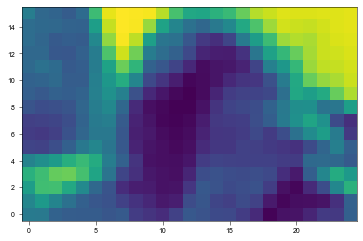

In [8]:
plt.imshow(stim[0,:,:], origin='lower')

In [7]:
scene_arr_scaled = np.zeros([int(150 / 2), 16, 25])
print(scene_arr_scaled.shape)

(75, 16, 25)


In [8]:
scene_seq_scaled = []
scene_seq_scaled.append(scene_arr_scaled)
scene_seq_scaled.append(scene_arr_scaled)
scene_seq_array = np.vstack(scene_seq_scaled)
scene_seq_array.shape

(150, 16, 25)

In [4]:
key = [{'m': 'Ntsr1Cre_2019_0007', 's': 1, 'e': 6, 'hm_version': 3,
                  'hm_seq_num': 1, 'stim_id': 0, 'trial_id': 0, 'hm_test_v_train': 'test',
                  'hm_scene_id': 0, 'hm_scene_pos': 0, 'hm_width_pix': 424,
                  'hm_height_pix': 264}]

In [5]:
scene = (Hmov.ScenePars() & key).load_scene()

> /Users/ybauer/code/djd/djd/hmov.py(384)load_scene()
    382             import pdb
    383             pdb.set_trace()
--> 384             vid = np.zeros((height, width, n_frames), dtype=np.uint8) # initialize video array
    385             for i, frame in enumerate(reader): # need to loop through frames from reader
    386                 # for BW-frames, take mean across 3 colour channels



ipdb>  n


> /Users/ybauer/code/djd/djd/hmov.py(385)load_scene()
    383             pdb.set_trace()
    384             vid = np.zeros((height, width, n_frames), dtype=np.uint8) # initialize video array
--> 385             for i, frame in enumerate(reader): # need to loop through frames from reader
    386                 # for BW-frames, take mean across 3 colour channels
    387                 vid[:,:,i] = frame.mean(axis=-1).astype(np.uint8)



ipdb>  vid.shape


(264, 424, 150)


ipdb>  c


In [6]:
scene.shape

(264, 424, 150)

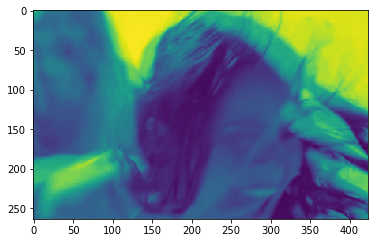

In [8]:
plt.imshow(scene[:,:,0], origin='upper')

   Rescaling training scenes:   0%|          | 0/288 [00:00<?, ?it/s]

Hmov(): Found hollymov version 3 with frame shape 424x264.


   Rescaling training scenes: 100%|██████████| 288/288 [07:02<00:00,  1.45s/it]

> /Users/ybauer/code/djd/djd/hmov.py(767)_export_stimulus_arrays()
    765             pdb.set_trace()
    766             # Flip frame y-axis
--> 767             train_rescaled = np.flip(train_rescaled, axis=1)
    768             plt.imshow(train_rescaled[0,:,:], origin='upper')
    769             plt.show()



ipdb>  n


> /Users/ybauer/code/djd/djd/hmov.py(768)_export_stimulus_arrays()
    766             # Flip frame y-axis
    767             train_rescaled = np.flip(train_rescaled, axis=1)
--> 768             plt.imshow(train_rescaled[0,:,:], origin='upper')
    769             plt.show()
    770 



ipdb>  n


NameError: name 'plt' is not defined
> /Users/ybauer/code/djd/djd/hmov.py(768)_export_stimulus_arrays()
    766             # Flip frame y-axis
    767             train_rescaled = np.flip(train_rescaled, axis=1)
--> 768             plt.imshow(train_rescaled[0,:,:], origin='upper')
    769             plt.show()
    770 



ipdb>  import matplotlib.pyplot as plt
ipdb>  plt.imshow(train_rescaled[0,:,:], origin='upper')


ipdb>  plt.show()


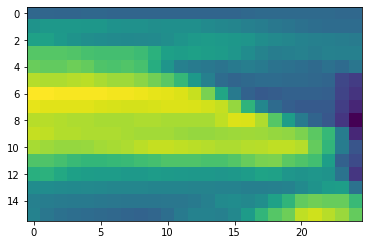

ipdb>  q


   Rescaling training scenes: 100%|██████████| 288/288 [09:47<00:00,  2.04s/it]


BdbQuit: 

In [4]:
from djd.hmov import _export_stimulus_arrays
movie_version = 3
scaling = 0.06
_export_stimulus_arrays(movie_version, scaling)